Imports

In [ ]:
import pickle
import os
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import integrate
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import normalize 
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Activation, Flatten, Conv1D, MaxPool1D, Conv2D, MaxPool2D,BatchNormalization
from tensorflow.keras.optimizers import Adam
from sklearn import metrics
import tensorflow as tf
from sklearn.preprocessing import OneHotEncoder
from tensorflow.keras.callbacks import ModelCheckpoint
from sklearn.preprocessing import OneHotEncoder
from keras.layers import LSTM
from keras.layers.embeddings import Embedding
from keras.layers import SimpleRNN
 

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# 1. Download the Dataset

In [ ]:
#!wget {"https://f002.backblazeb2.com/file/deepsig-datasets/2016.10/RML2016.10b.tar.bz2?Authorization=3_20220602114002_e16816616a20a308557e67cb_472ce0aa0d1a64bb4b7fd56c691a466c813a050f_002_20220602124002_0027_dnld"}
#os.rename("RML2016.10b.tar.bz2?Authorization=3_20220602114002_e16816616a20a308557e67cb_472ce0aa0d1a64bb4b7fd56c691a466c813a050f_002_20220602124002_0027_dnld", "RML2016.10b.tar.bz2")
#!tar xjvf RML2016.10b.tar.bz2


In [ ]:
os.chdir('/content/drive/MyDrive/RML2016_dataset/') 
Data = pickle.load(open("RML2016.10b.dat",'rb'), encoding = 'bytes')
snrs, mods = map(lambda j: sorted(list(set(map(lambda x: x[j], Data.keys())))), [1,0])
print(f"Mods: {mods}")
print(f"SNRs: {snrs}")

Mods: [b'8PSK', b'AM-DSB', b'BPSK', b'CPFSK', b'GFSK', b'PAM4', b'QAM16', b'QAM64', b'QPSK', b'WBFM']
SNRs: [-20, -18, -16, -14, -12, -10, -8, -6, -4, -2, 0, 2, 4, 6, 8, 10, 12, 14, 16, 18]


In [ ]:
X = []     
label = []
for snr in snrs:
  x = []
  y = []
  for mod in mods:
    x.append(Data[(mod,snr)])
    y.append([mod] * Data[(mod,snr)].shape[0])
  y = np.array(y)
  label.append(y.reshape((y.shape[0] * y.shape[1])))
  X.append(np.vstack(x))
label = np.array(label)
X = np.array(X)
print(label.shape)        
print(X.shape)

(20, 60000)
(20, 60000, 2, 128)


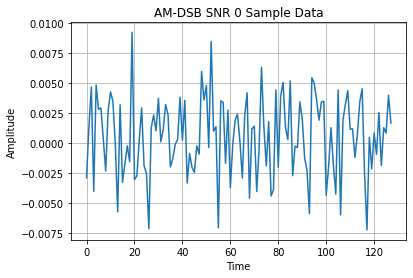

In [ ]:
plt.plot(Data[b'AM-DSB',0][2,0])
plt.xlabel("Time")
plt.ylabel("Amplitude")
plt.title("AM-DSB SNR 0 Sample Data")
plt.grid(b=True, axis='both')

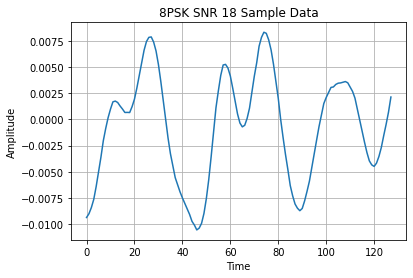

In [ ]:
plt.plot(Data[b'8PSK',18][2,0])
plt.xlabel("Time")
plt.ylabel("Amplitude")
plt.title("8PSK SNR 18 Sample Data")
plt.grid(b=True, axis='both')

# Raw time series and Models




In [ ]:
def encoding(label):
  encoded = []
  for y in label:
    enc = OneHotEncoder(sparse = False).fit_transform(y.reshape(-1,1))
    encoded.append(enc)

  return np.array(encoded)

In [ ]:
label_enc = encoding(label)

In [ ]:
print(label_enc.shape)

(20, 60000, 10)


In [ ]:
def split(data, y):
  feat_train = []
  lab_train = []
  feat_test = []
  lab_test = []
  feat_val = []
  lab_val = []
  len = data.shape[0]
  for i in range(len):
    d = data[0]
    yy = y[0]
    data = data[1:]
    X_train_val,X_test, y_train_val, y_test = train_test_split(d, yy, test_size = 0.3, stratify = yy)
    X_train, X_val,  y_train,y_val = train_test_split (X_train_val, y_train_val, test_size = 0.05, stratify = y_train_val)
    feat_train.append(X_train)
    feat_test.append(X_test)
    feat_val.append(X_val)
    lab_train.append(y_train)
    lab_test.append(y_test)
    lab_val.append(y_val)

  return np.array(feat_train), np.array(feat_val), np.array(feat_test), np.array(lab_train), np.array(lab_val), np.array(lab_test)



In [ ]:
X  = X.reshape((20, 60000, 2, 128, 1))

In [ ]:
feat_train, feat_val, feat_test, lab_train, lab_val, lab_test = split(X, label_enc)

In [ ]:
print(feat_train.shape, lab_train.shape)

##  CNN

In [ ]:
def plot_snr_acc(snrs, acc):
  plt.plot(snrs, acc, label = "SNR vs ACC")
  plt.legend()
  plt.show()

In [ ]:
def plot_loss_acc(histories):
  for i,h in enumerate(histories):
    pd.DataFrame(h.history).plot(figsize=(8,5))
    plt.title('SNR : ' + str(snrs[i]))
    plt.show()

In [ ]:
def confusion_matrixf(y_preds, lab_test):
  for i, y_pred in enumerate(y_preds):
    y_test = np.argmax(lab_test[i], axis=1)
    confusion_mtx = confusion_matrix(y_test, y_pred)
    plt.figure(figsize=(10, 8))
    sns.heatmap(confusion_mtx, xticklabels=mods, yticklabels=mods, annot=True, fmt='g')
    plt.xlabel('Prediction')
    plt.ylabel('Label')
    plt.title('SNR : ' + str(snrs[i]))
    plt.show()

In [ ]:
def create_model(lr):
  model=Sequential()
  model.add(Conv2D(256, 3, activation='relu', padding='same'))
  model.add(Dropout(0.5))
  model.add(Conv2D(64, 3, strides=2, activation='relu', padding='same'))
  model.add(Dropout(0.5))
  model.add(Flatten())
  model.add(Dense(128, activation='relu' ))
  model.add(Dense(10,  activation='softmax'))
  model.compile(loss=tf.keras.losses.CategoricalCrossentropy(), metrics='accuracy', optimizer=tf.keras.optimizers.Adam(learning_rate=lr))
  return model


In [ ]:
num_epochs = 50
num_batch_size = 32

In [ ]:
es = tf.keras.callbacks.EarlyStopping(monitor="val_loss", patience=5, restore_best_weights=True,)

In [ ]:
def train_models(num_models, feat_train, feat_val, lab_train, lab_val, num_epochs, num_batch_size, lr, model_type):
  models = []
  histories = []
  for i in range(num_models):
    checkpointer = ModelCheckpoint(filepath='saved_models/classification' + str(i) + '.hdf5', verbose=1, save_best_only=True)
    if model_type == 'CNN':
      model = create_model(lr=lr)
    elif model_type == 'RNN':  
      model = create_RNN(lr=lr)
    elif model_type == 'LSTM':
      model = create_LSTM(lr)
    print(f'\n********************************************************* SNR {snrs[i]} *********************************************************\n')
    with tf.device('/device:GPU:0'):
      history = model.fit(feat_train[i], lab_train[i], batch_size=num_batch_size, epochs=num_epochs, validation_data=(feat_val[i], lab_val[i]), callbacks=[es, checkpointer], verbose=1)
    models.append(model)
    histories.append(history)

  return models, histories

In [ ]:
def test_models(models, feat_test, lab_test):
  acc = []
  y_preds = []
  for i, mod in enumerate(models):
    y_pred = np.argmax(mod.predict(feat_test[i]), axis=1)
    test_acc = sum(y_pred == np.argmax(lab_test[i], axis=1)) / len(lab_test[i])
    acc.append(test_acc)
    y_preds.append(y_pred)
    print(f'Test set accuracy mod {i+1} of SNR {snrs[i]}: {test_acc.mean():.0%}')
  return acc, np.array(y_preds)

In [ ]:
models, histories = train_models(len(snrs), feat_train, feat_val, lab_train, lab_val, num_epochs, num_batch_size, 1e-5, 'CNN')

Streaming output truncated to the last 5000 lines.
Epoch 60/100
1237/1247 [============================>.] - ETA: 0s - loss: 1.3962 - accuracy: 0.4321
Epoch 60: val_loss improved from 1.40196 to 1.39536, saving model to saved_models/classification7.hdf5
1247/1247 [==============================] - 6s 5ms/step - loss: 1.3965 - accuracy: 0.4320 - val_loss: 1.3954 - val_accuracy: 0.4271
Epoch 61/100
1241/1247 [============================>.] - ETA: 0s - loss: 1.3888 - accuracy: 0.4357
Epoch 61: val_loss improved from 1.39536 to 1.38854, saving model to saved_models/classification7.hdf5
1247/1247 [==============================] - 6s 5ms/step - loss: 1.3891 - accuracy: 0.4357 - val_loss: 1.3885 - val_accuracy: 0.4295
Epoch 62/100
1243/1247 [============================>.] - ETA: 0s - loss: 1.3822 - accuracy: 0.4382
Epoch 62: val_loss improved from 1.38854 to 1.38371, saving model to saved_models/classification7.hdf5
1247/1247 [==============================] - 6s 5ms/step - loss: 1.3822 - 

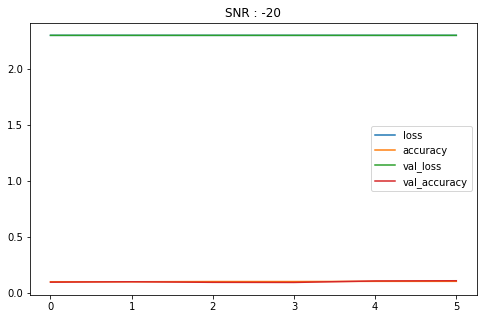

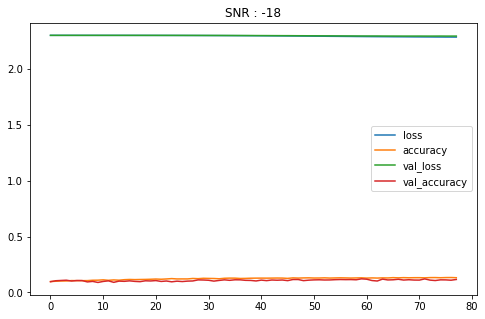

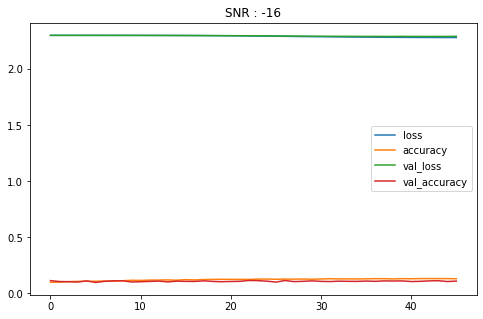

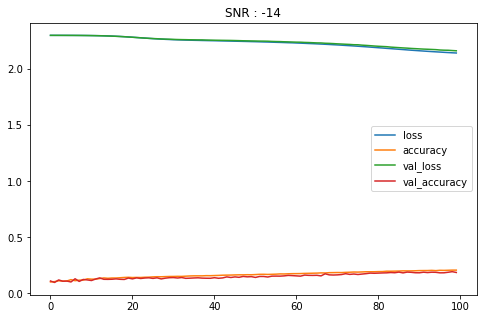

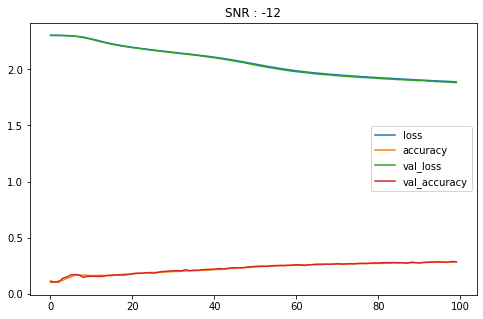

...

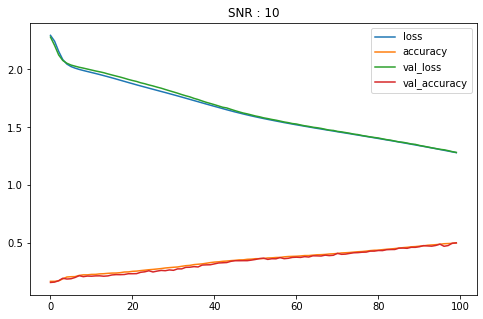

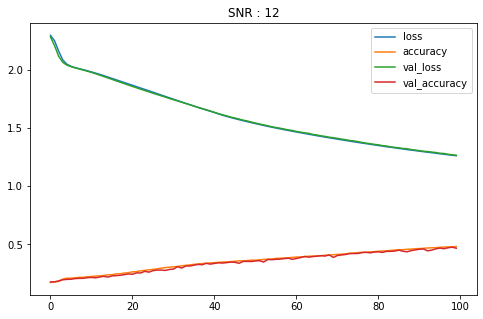

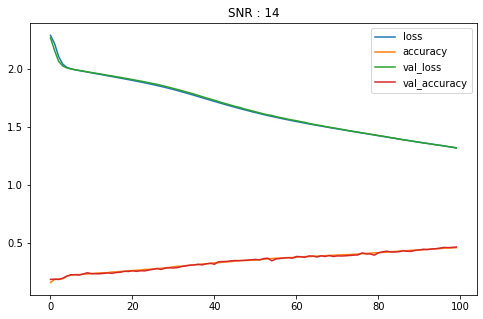

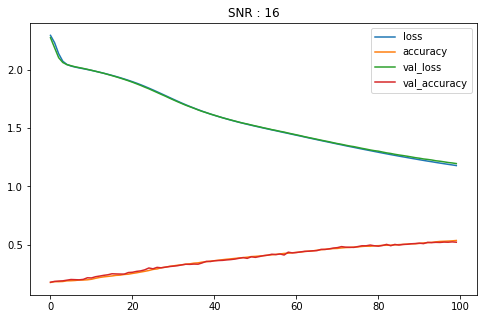

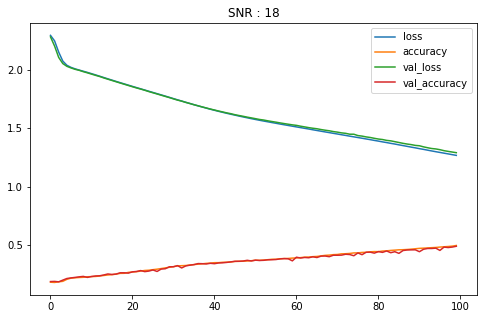

In [ ]:
plot_loss_acc(histories)

In [ ]:
acc_list, y_preds = test_models(models, feat_test, lab_test)

Test set accuracy mod 1 of SNR -20: 10%
Test set accuracy mod 2 of SNR -18: 11%
Test set accuracy mod 3 of SNR -16: 12%
Test set accuracy mod 4 of SNR -14: 19%
Test set accuracy mod 5 of SNR -12: 27%
Test set accuracy mod 6 of SNR -10: 37%
Test set accuracy mod 7 of SNR -8: 43%
Test set accuracy mod 8 of SNR -6: 48%
Test set accuracy mod 9 of SNR -4: 43%
Test set accuracy mod 10 of SNR -2: 40%
Test set accuracy mod 11 of SNR 0: 44%
Test set accuracy mod 12 of SNR 2: 45%
Test set accuracy mod 13 of SNR 4: 50%
Test set accuracy mod 14 of SNR 6: 41%
Test set accuracy mod 15 of SNR 8: 47%
Test set accuracy mod 16 of SNR 10: 49%
Test set accuracy mod 17 of SNR 12: 47%
Test set accuracy mod 18 of SNR 14: 45%
Test set accuracy mod 19 of SNR 16: 52%
Test set accuracy mod 20 of SNR 18: 48%


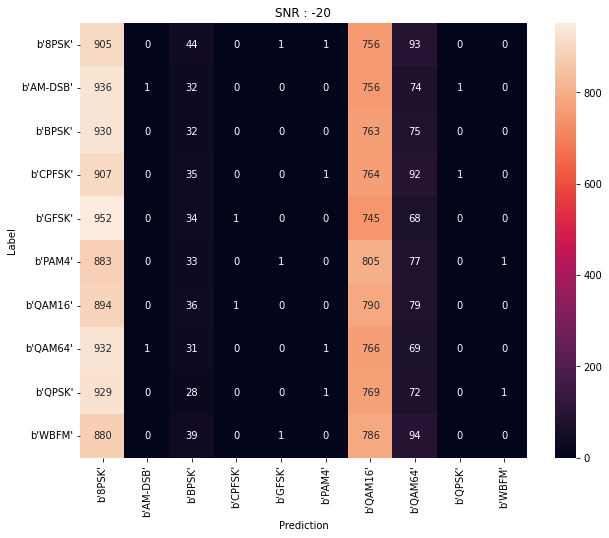

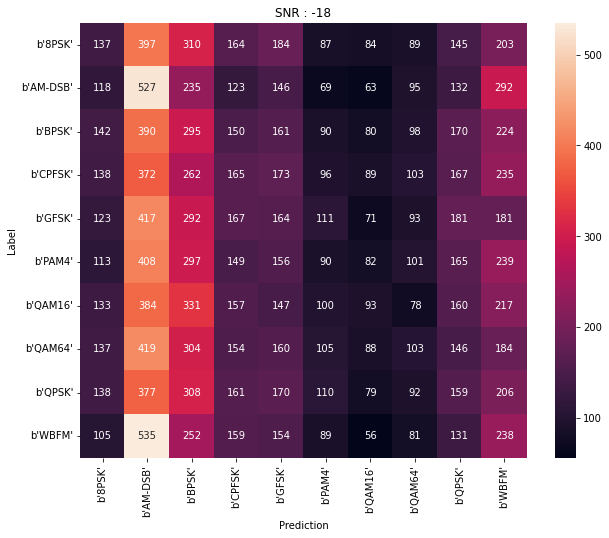

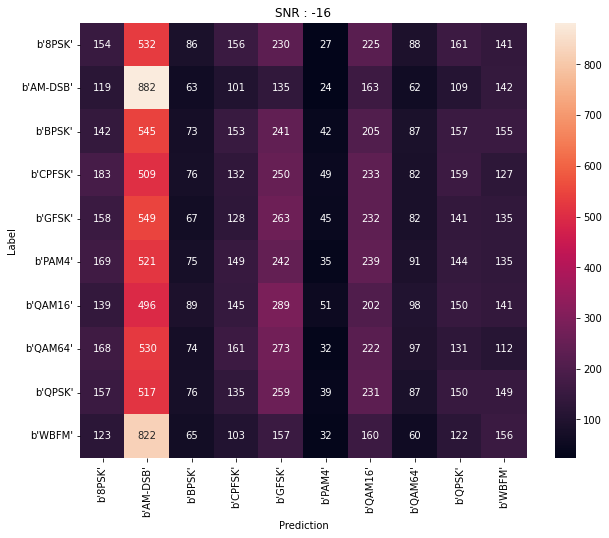

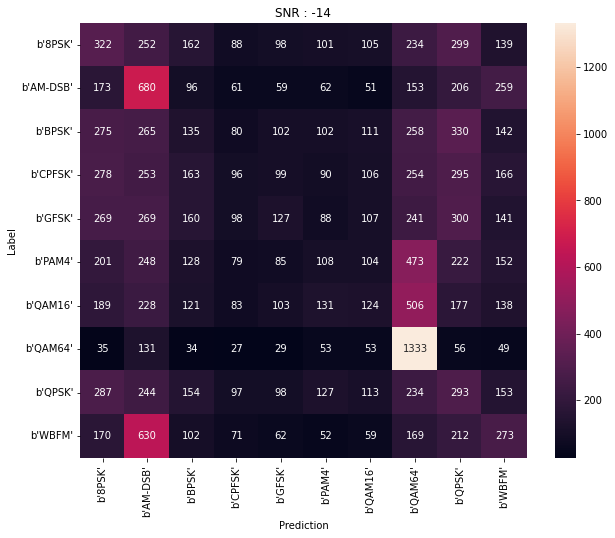

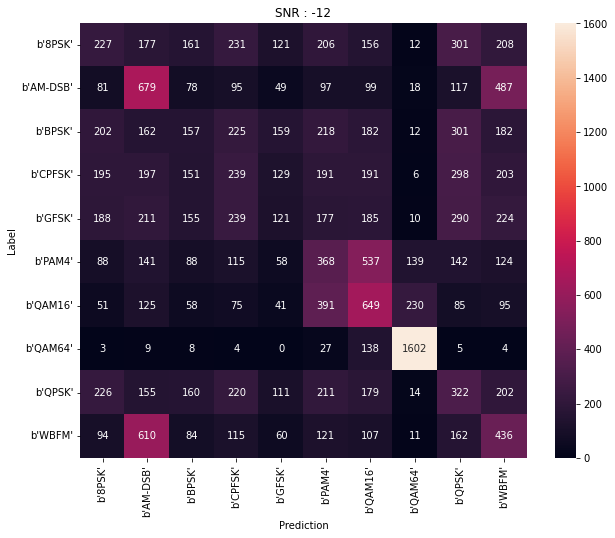

...

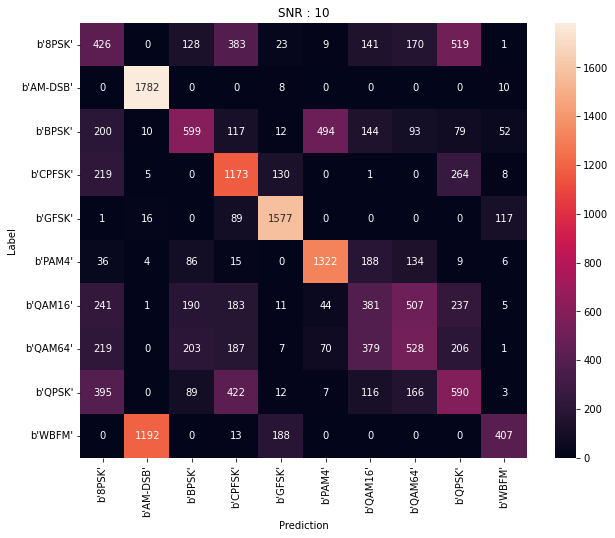

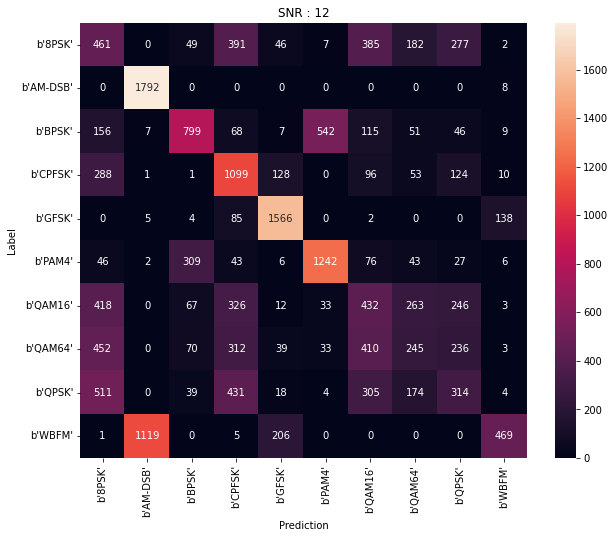

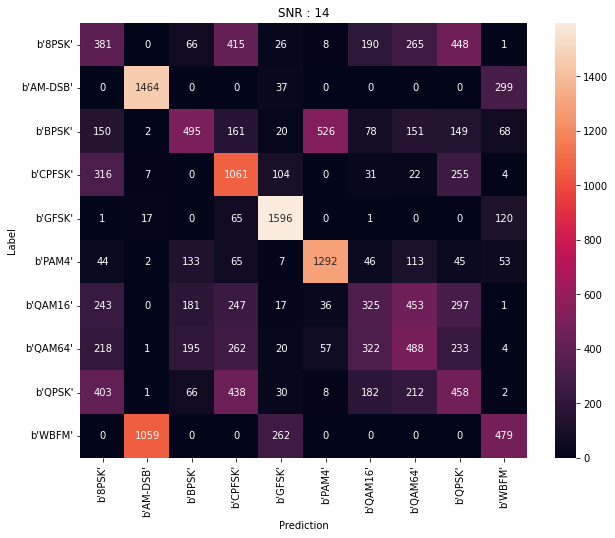

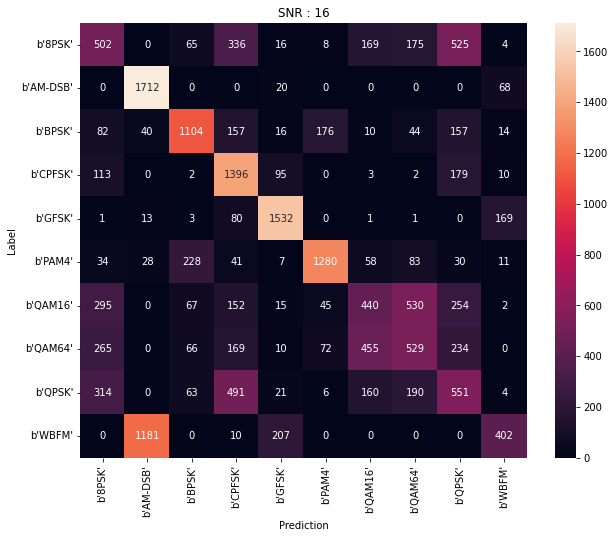

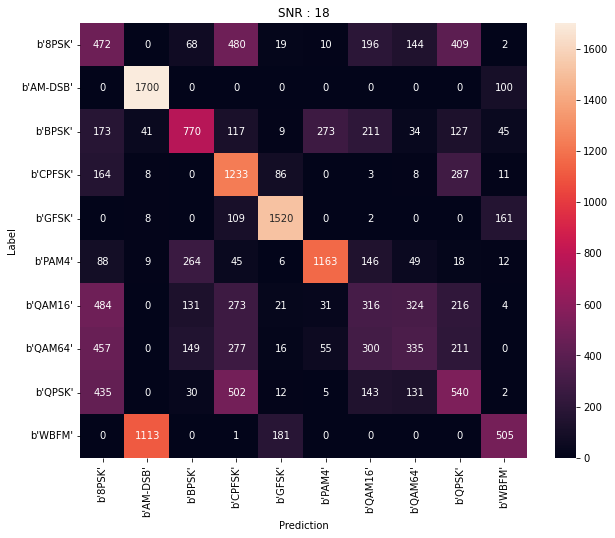

In [ ]:
confusion_matrixf(y_preds, lab_test)

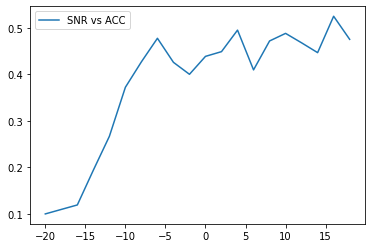

In [ ]:
plot_snr_acc(snrs, acc_list)

## RNN

In [ ]:
def create_RNN(lr):
    model = Sequential()
    model.add(SimpleRNN(50, activation='relu'))
    model.add(Dense(10, activation='softmax'))
    model.compile(loss=tf.keras.losses.CategoricalCrossentropy(), metrics='accuracy', optimizer=tf.keras.optimizers.Adam(learning_rate=lr))
    return model
    
 

In [ ]:
RNNmodels, RNNhistories = train_models(len(snrs), feat_train, feat_val, lab_train, lab_val, num_epochs, num_batch_size, 1e-5, 'RNN')



********************************************************* SNR -20 *********************************************************

Epoch 1/50
1237/1247 [============================>.] - ETA: 0s - loss: 2.3027 - accuracy: 0.0979
Epoch 1: val_loss improved from inf to 2.30276, saving model to saved_models/classification0.hdf5
1247/1247 [==============================] - 9s 4ms/step - loss: 2.3027 - accuracy: 0.0979 - val_loss: 2.3028 - val_accuracy: 0.0948
Epoch 2/50
1237/1247 [============================>.] - ETA: 0s - loss: 2.3026 - accuracy: 0.0974
Epoch 2: val_loss improved from 2.30276 to 2.30276, saving model to saved_models/classification0.hdf5
1247/1247 [==============================] - 5s 4ms/step - loss: 2.3026 - accuracy: 0.0974 - val_loss: 2.3028 - val_accuracy: 0.0957
Epoch 3/50
1246/1247 [============================>.] - ETA: 0s - loss: 2.3026 - accuracy: 0.0987
Epoch 3: val_loss improved from 2.30276 to 2.30275, saving model to saved_models/classification0.hdf5
1247/1247 [=

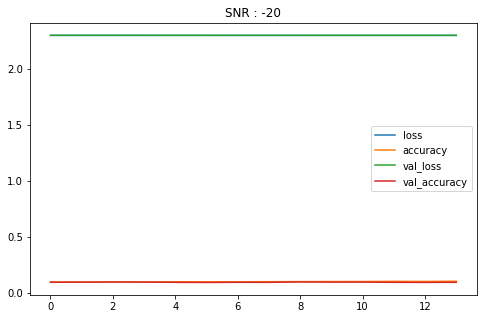

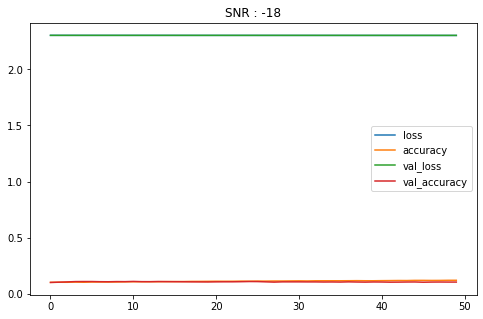

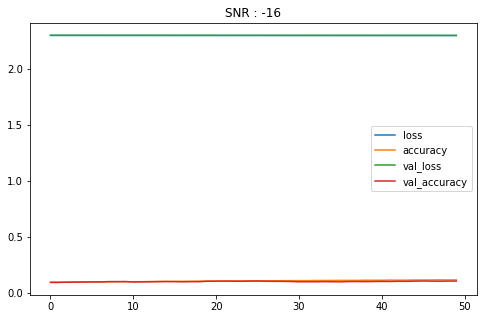

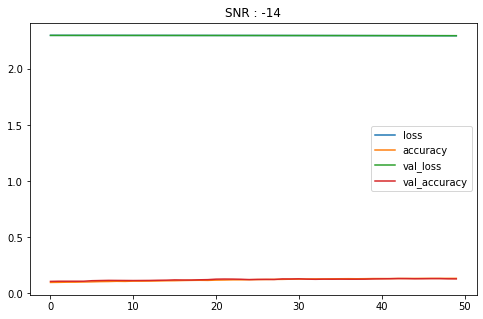

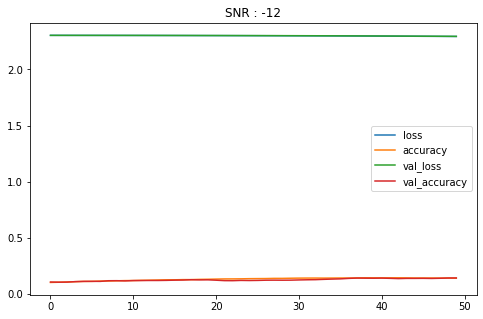

...

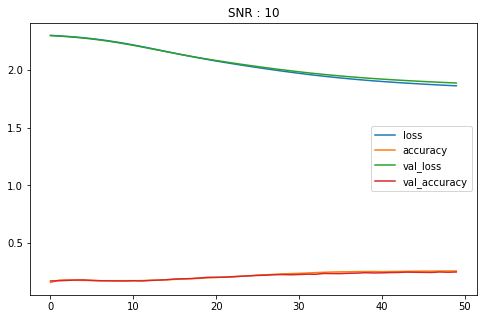

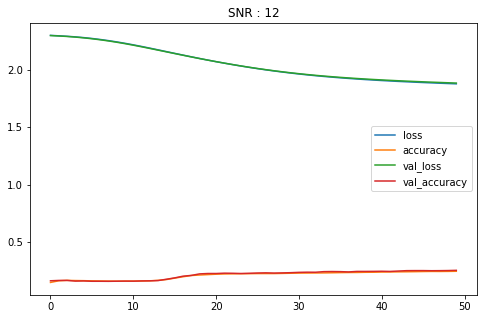

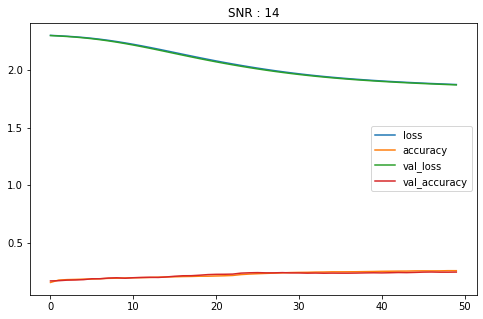

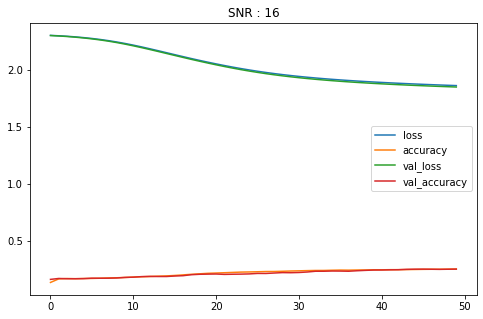

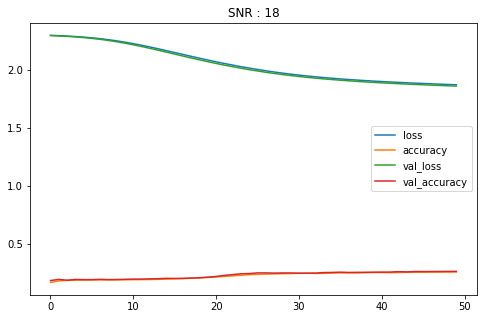

In [ ]:
plot_loss_acc(RNNhistories)

In [ ]:
RNN_acc_list, RNN_y_preds = test_models(RNNmodels, feat_test, lab_test)

Test set accuracy mod 1 of SNR -20: 10%
Test set accuracy mod 2 of SNR -18: 10%
Test set accuracy mod 3 of SNR -16: 11%
Test set accuracy mod 4 of SNR -14: 12%
Test set accuracy mod 5 of SNR -12: 13%
Test set accuracy mod 6 of SNR -10: 15%
Test set accuracy mod 7 of SNR -8: 17%
Test set accuracy mod 8 of SNR -6: 21%
Test set accuracy mod 9 of SNR -4: 22%
Test set accuracy mod 10 of SNR -2: 23%
Test set accuracy mod 11 of SNR 0: 24%
Test set accuracy mod 12 of SNR 2: 25%
Test set accuracy mod 13 of SNR 4: 25%
Test set accuracy mod 14 of SNR 6: 25%
Test set accuracy mod 15 of SNR 8: 25%
Test set accuracy mod 16 of SNR 10: 25%
Test set accuracy mod 17 of SNR 12: 24%
Test set accuracy mod 18 of SNR 14: 25%
Test set accuracy mod 19 of SNR 16: 25%
Test set accuracy mod 20 of SNR 18: 25%


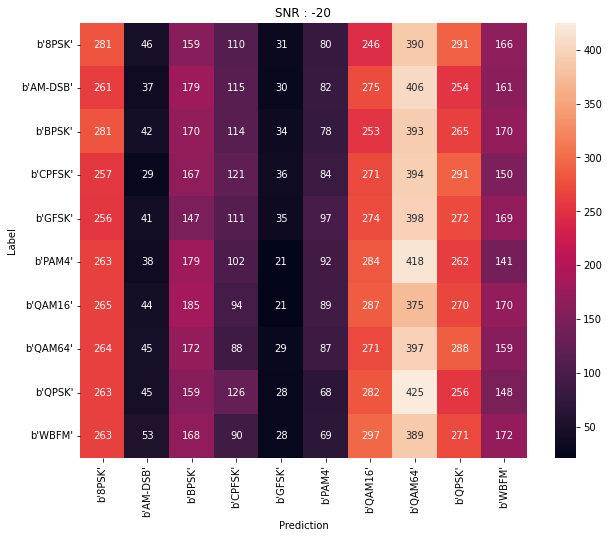

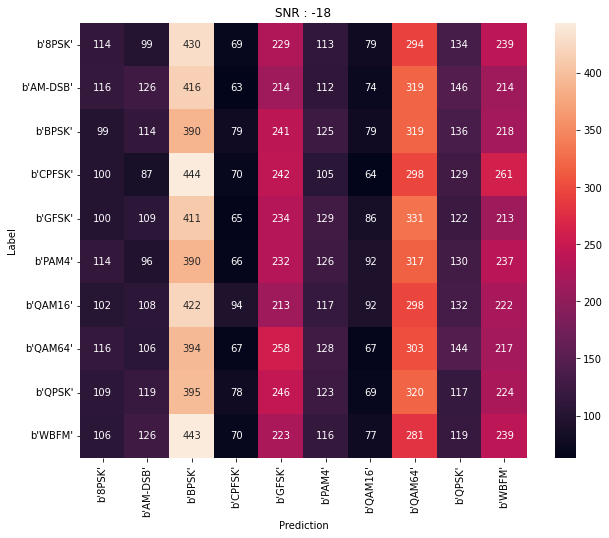

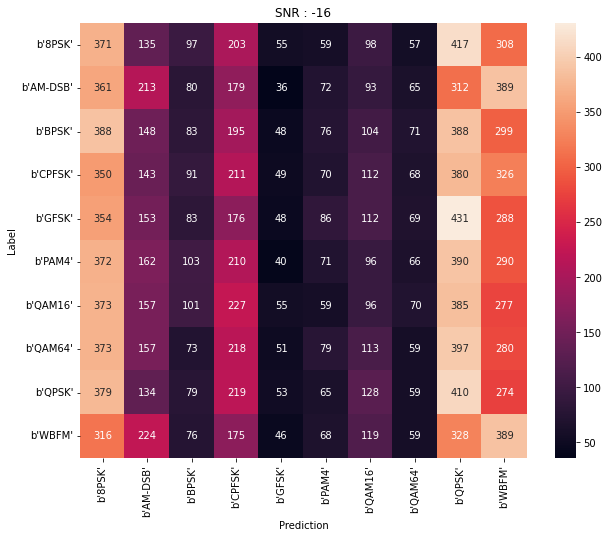

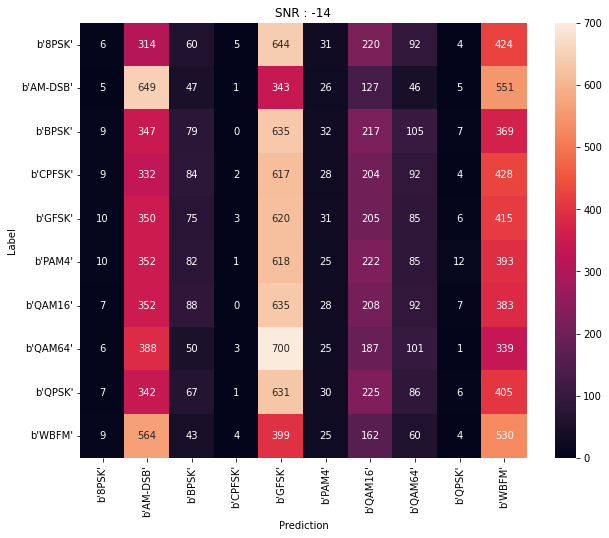

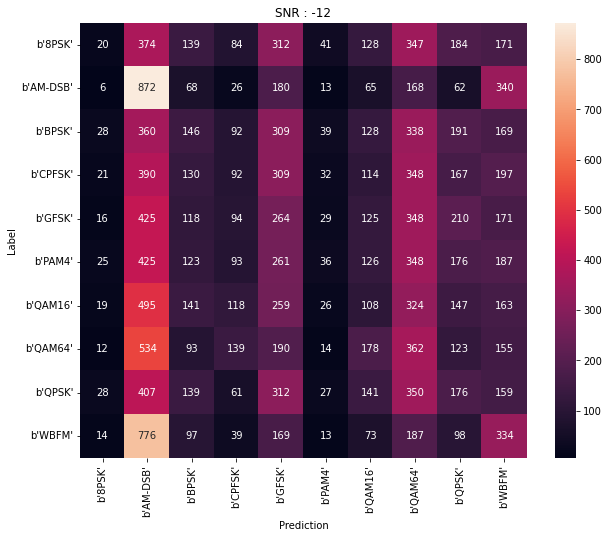

...

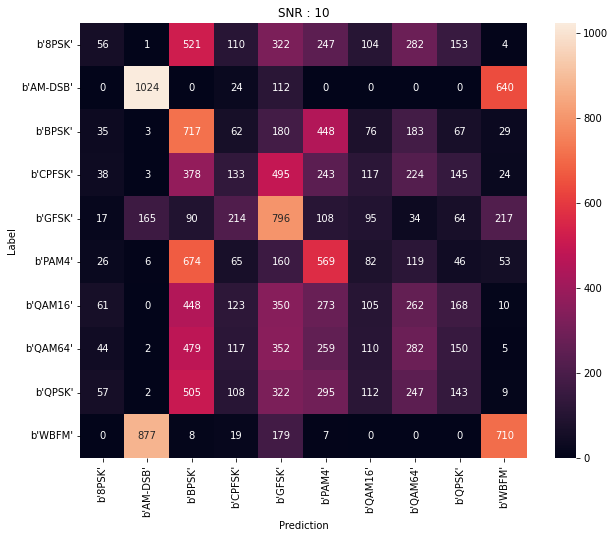

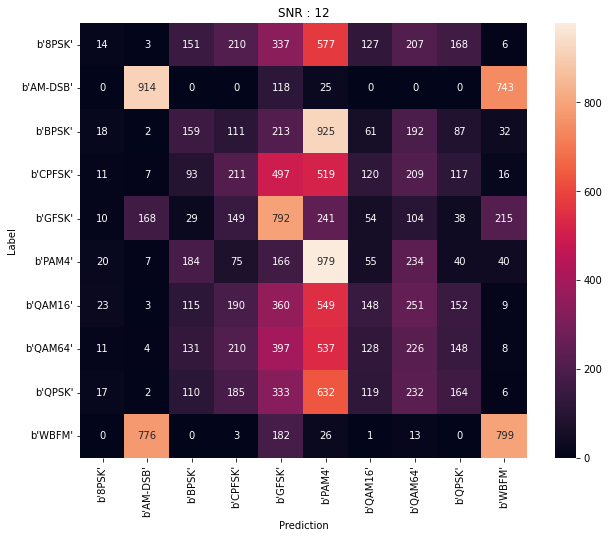

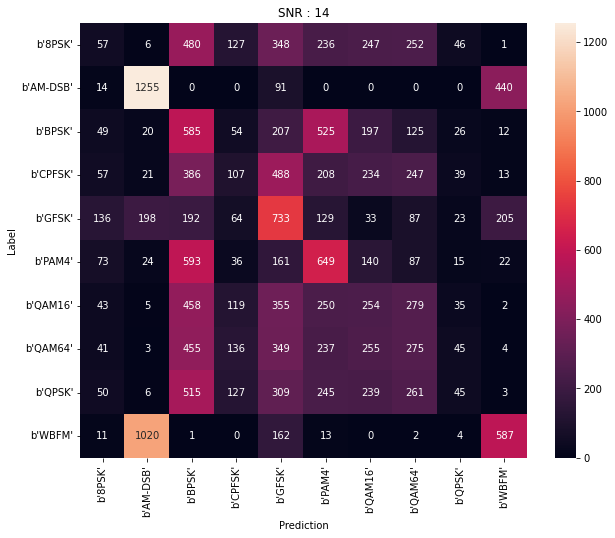

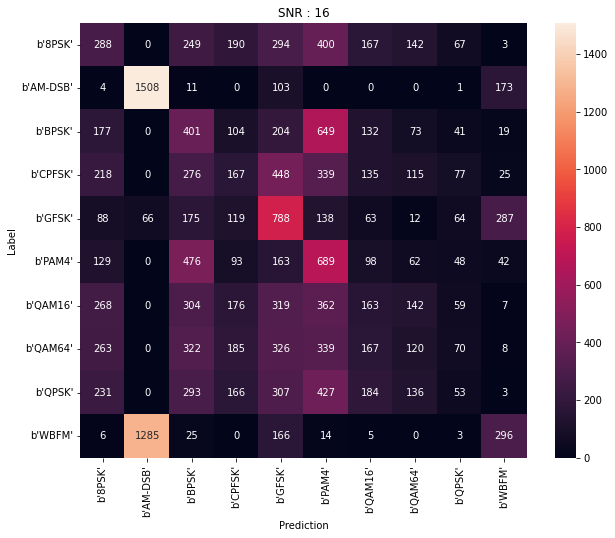

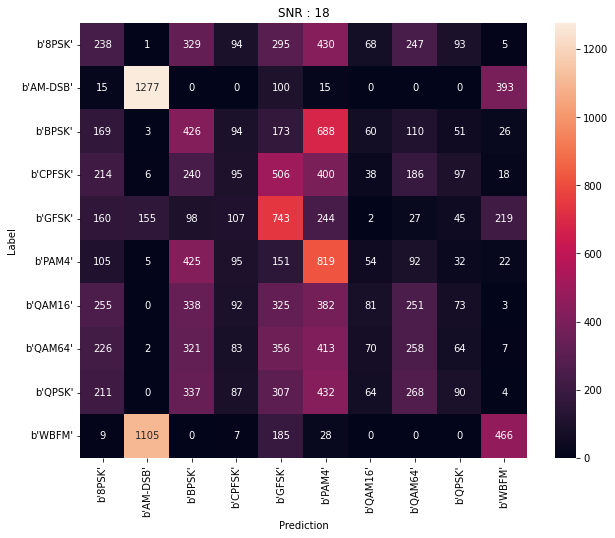

In [ ]:
confusion_matrixf(RNN_y_preds, lab_test)

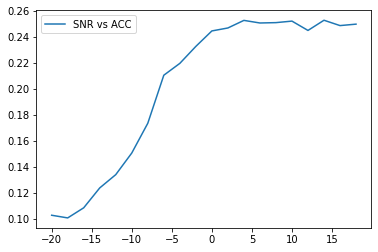

In [ ]:
plot_snr_acc(snrs, RNN_acc_list)

## LSTM

In [ ]:
def create_LSTM(lr):
  model = Sequential()
  #model.add(Embedding(top_words, embedding_vecor_length, input_length=max_review_length))
  model.add(LSTM(10))
  model.add(Dropout(0.2))
  model.add(Dense(10, activation='softmax'))
  model.compile(loss=tf.keras.losses.CategoricalCrossentropy(), optimizer='adam', metrics=['accuracy'])
  return model

In [ ]:
LSTMmodels, LSTMhistories = train_models(len(snrs), feat_train, feat_val, lab_train, lab_val, num_epochs, num_batch_size, 1e-5, 'LSTM')



********************************************************* SNR -20 *********************************************************

Epoch 1/50
1245/1247 [============================>.] - ETA: 0s - loss: 2.3028 - accuracy: 0.0976
Epoch 1: val_loss improved from inf to 2.30278, saving model to saved_models/classification0.hdf5
1247/1247 [==============================] - 16s 8ms/step - loss: 2.3028 - accuracy: 0.0975 - val_loss: 2.3028 - val_accuracy: 0.0971
Epoch 2/50
1238/1247 [============================>.] - ETA: 0s - loss: 2.3027 - accuracy: 0.0995
Epoch 2: val_loss did not improve from 2.30278
1247/1247 [==============================] - 7s 6ms/step - loss: 2.3027 - accuracy: 0.0994 - val_loss: 2.3028 - val_accuracy: 0.1019
Epoch 3/50
1243/1247 [============================>.] - ETA: 0s - loss: 2.3026 - accuracy: 0.1007
Epoch 3: val_loss did not improve from 2.30278
1247/1247 [==============================] - 5s 4ms/step - loss: 2.3026 - accuracy: 0.1007 - val_loss: 2.3029 - val_accur

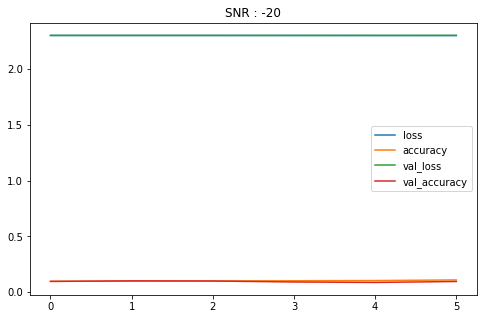

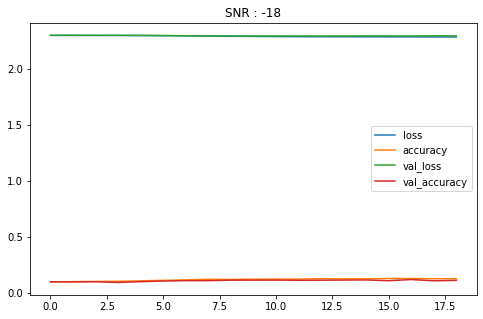

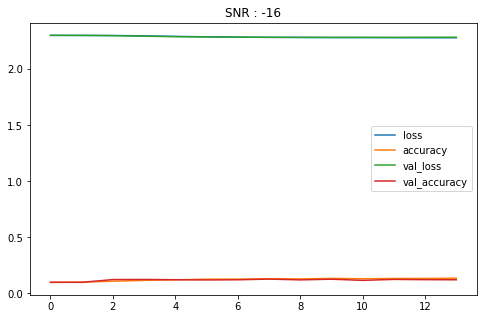

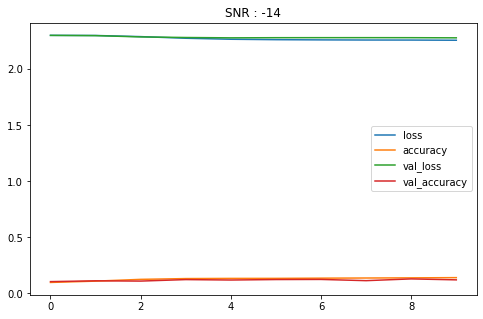

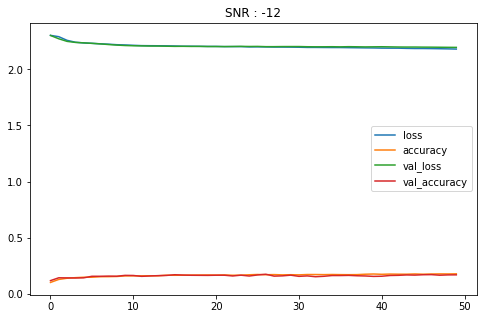

...

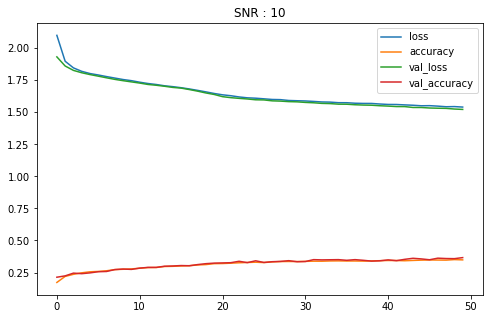

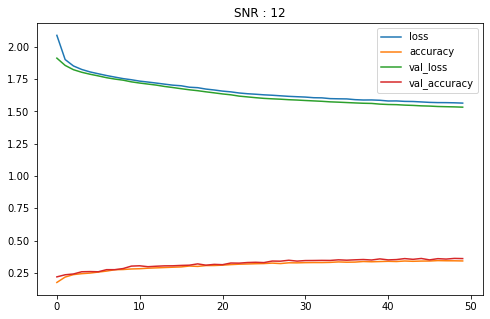

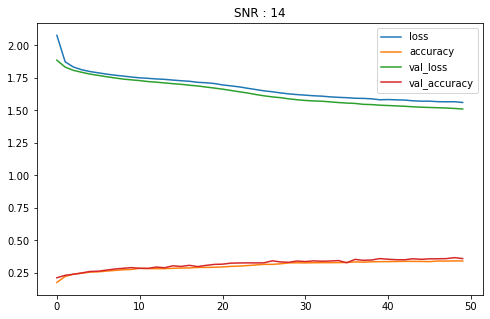

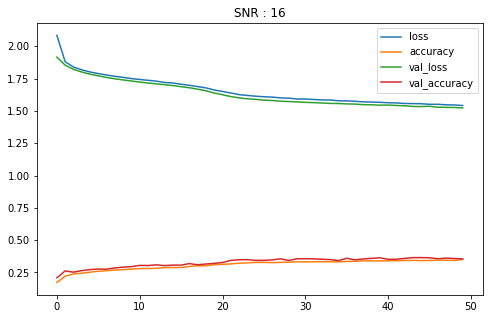

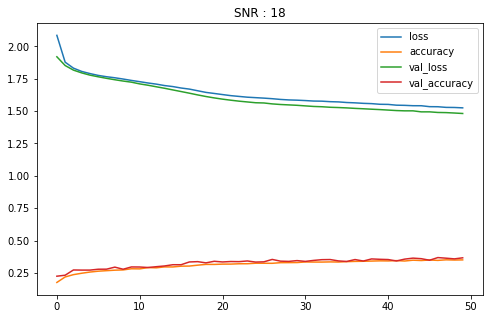

In [ ]:
plot_loss_acc(LSTMhistories)

In [ ]:
LSTM_acc_list, LSTM_y_preds = test_models(LSTMmodels, feat_test, lab_test)

Test set accuracy mod 1 of SNR -20: 10%
Test set accuracy mod 2 of SNR -18: 11%
Test set accuracy mod 3 of SNR -16: 12%
Test set accuracy mod 4 of SNR -14: 13%
Test set accuracy mod 5 of SNR -12: 16%
Test set accuracy mod 6 of SNR -10: 20%
Test set accuracy mod 7 of SNR -8: 26%
Test set accuracy mod 8 of SNR -6: 27%
Test set accuracy mod 9 of SNR -4: 30%
Test set accuracy mod 10 of SNR -2: 35%
Test set accuracy mod 11 of SNR 0: 36%
Test set accuracy mod 12 of SNR 2: 36%
Test set accuracy mod 13 of SNR 4: 37%
Test set accuracy mod 14 of SNR 6: 36%
Test set accuracy mod 15 of SNR 8: 36%
Test set accuracy mod 16 of SNR 10: 36%
Test set accuracy mod 17 of SNR 12: 36%
Test set accuracy mod 18 of SNR 14: 36%
Test set accuracy mod 19 of SNR 16: 36%
Test set accuracy mod 20 of SNR 18: 37%


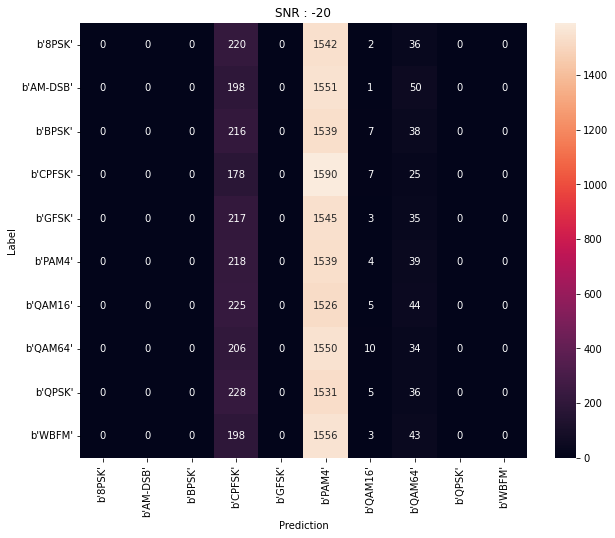

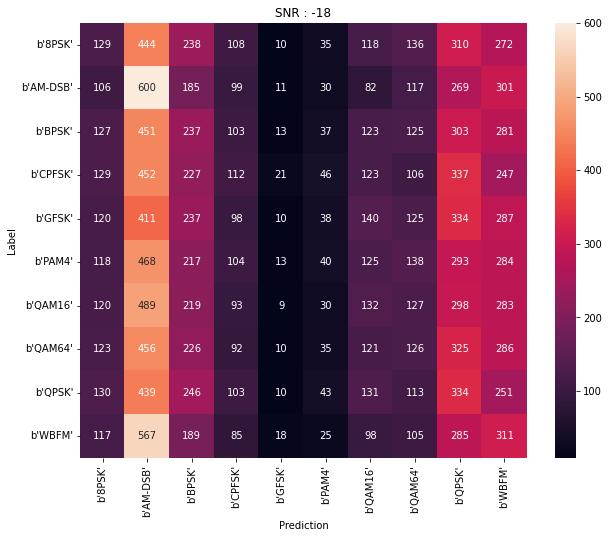

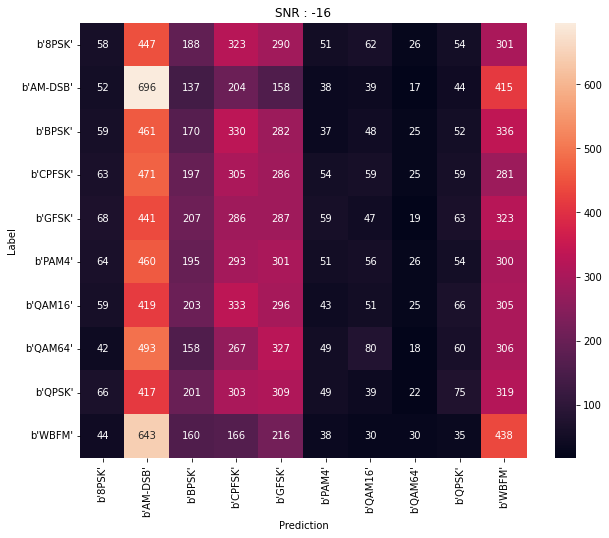

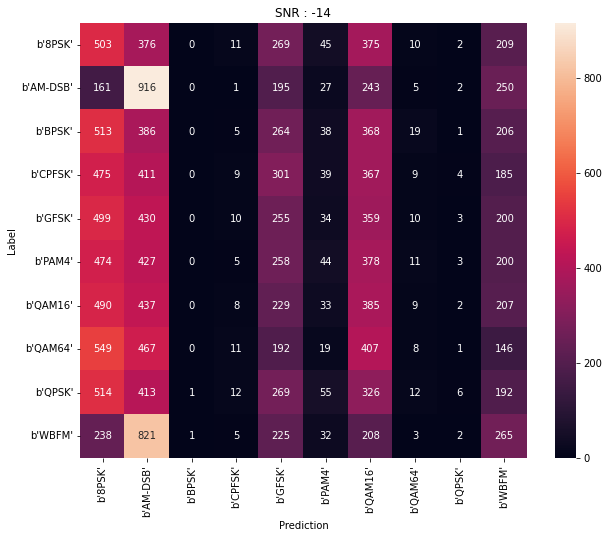

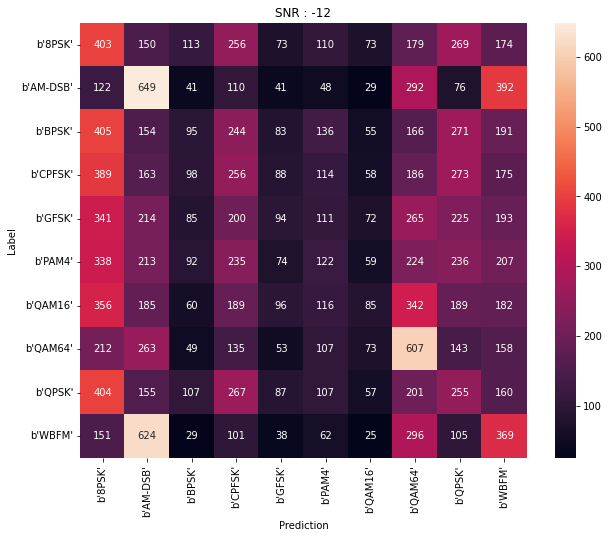

...

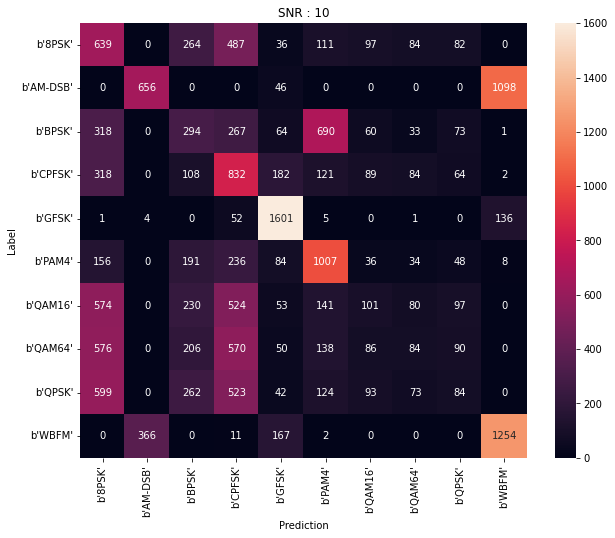

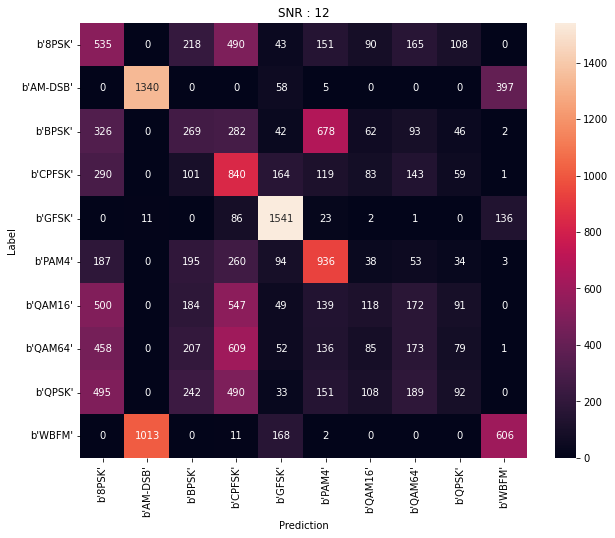

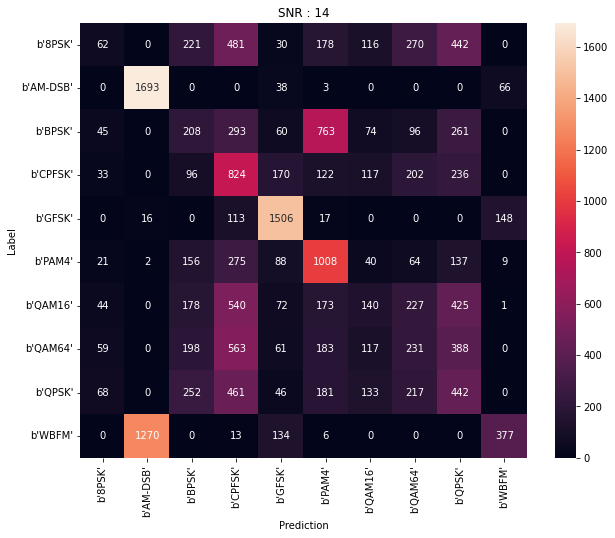

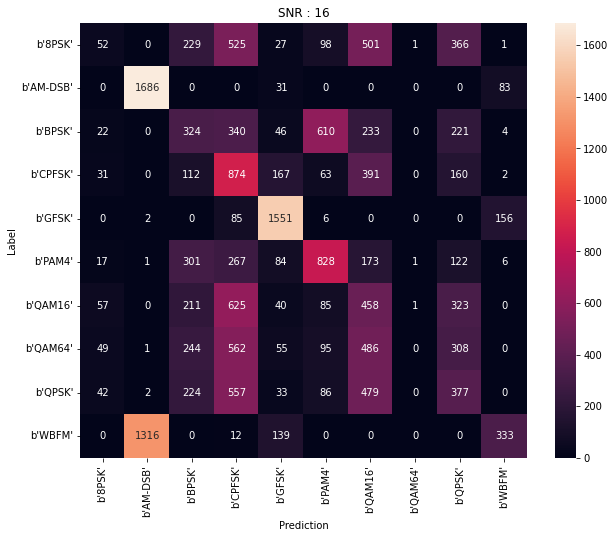

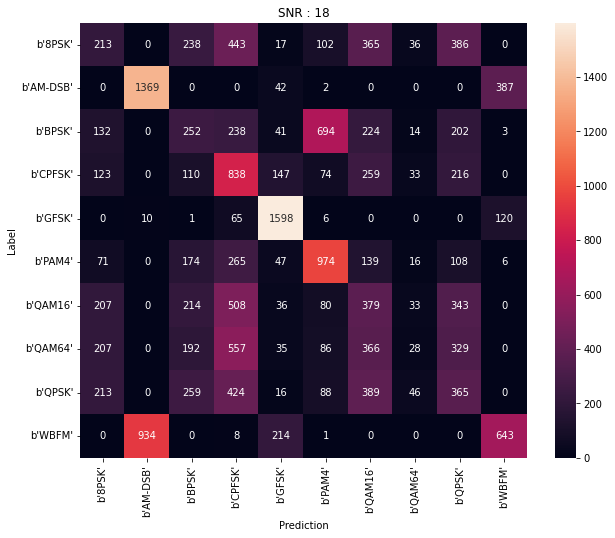

In [ ]:
confusion_matrixf(LSTM_y_preds, lab_test)

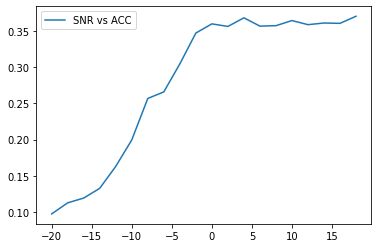

In [ ]:
plot_snr_acc(snrs, LSTM_acc_list)

# First derivative in time and Models


## CNN

In [ ]:
def get_FDIT(X):
  features_FDIT = []
  for i, x in enumerate(X):
    fdit = np.concatenate((normalize(np.gradient(x[:,0], axis = 1)), normalize(np.gradient(x[:,1], axis = 1))), axis=1).reshape(x.shape[0],x.shape[1],x.shape[2])
    #fdit = fdit.reshape(fdit.shape[0],fdit.shape[1],fdit.shape[2])
    features_FDIT.append(fdit)

  return np.asarray(features_FDIT)


In [ ]:
##X=X.reshape((20,60000,2,128))
#print(X.shape)

In [ ]:
features_FDIT = get_FDIT(X).reshape((20, 60000, 2, 128, 1))

print(features_FDIT.shape)

(20, 60000, 2, 128, 1)


In [ ]:
feat_train, feat_val, feat_test, lab_train, lab_val, lab_test = split(features_FDIT, label_enc)

In [ ]:
print(feat_train.shape, lab_train.shape)

(20, 39900, 2, 128, 1) (20, 39900, 10)


In [ ]:
models, histories = train_models(len(snrs), feat_train, feat_val, lab_train, lab_val, num_epochs, num_batch_size, 1e-2,'CNN')


********************************************************* SNR -20 *********************************************************

Epoch 1/50
1247/1247 [==============================] - ETA: 0s - loss: 2.3042 - accuracy: 0.0999
Epoch 1: val_loss improved from inf to 2.30306, saving model to saved_models/classification0.hdf5
1247/1247 [==============================] - 20s 6ms/step - loss: 2.3042 - accuracy: 0.0999 - val_loss: 2.3031 - val_accuracy: 0.1000
Epoch 2/50
1239/1247 [============================>.] - ETA: 0s - loss: 2.3041 - accuracy: 0.0983
Epoch 2: val_loss did not improve from 2.30306
1247/1247 [==============================] - 6s 5ms/step - loss: 2.3041 - accuracy: 0.0982 - val_loss: 2.3041 - val_accuracy: 0.1000
Epoch 3/50
1244/1247 [============================>.] - ETA: 0s - loss: 2.3039 - accuracy: 0.0990
Epoch 3: val_loss did not improve from 2.30306
1247/1247 [==============================] - 7s 5ms/step - loss: 2.3039 - accuracy: 0.0989 - val_loss: 2.3039 - val_accur

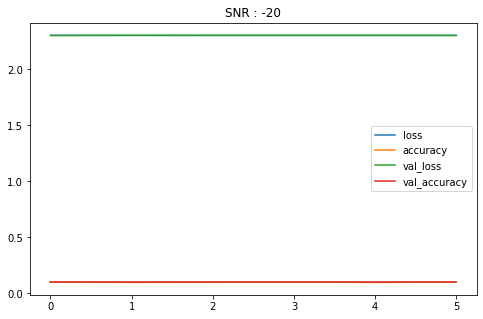

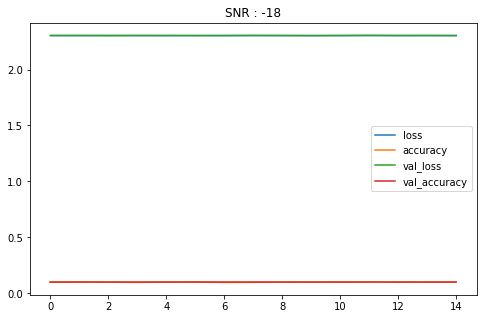

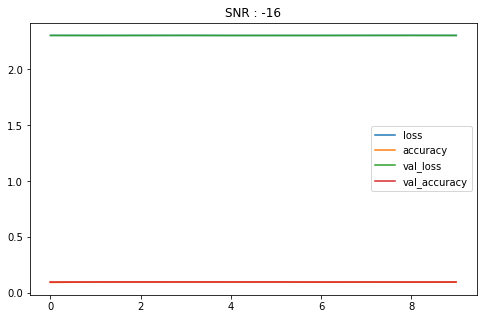

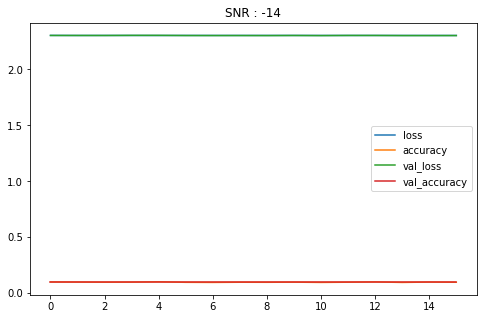

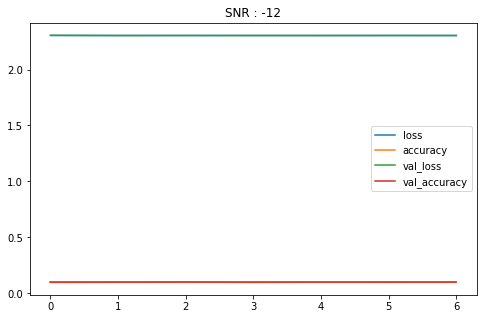

...

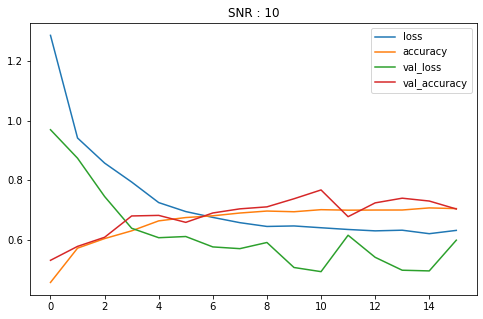

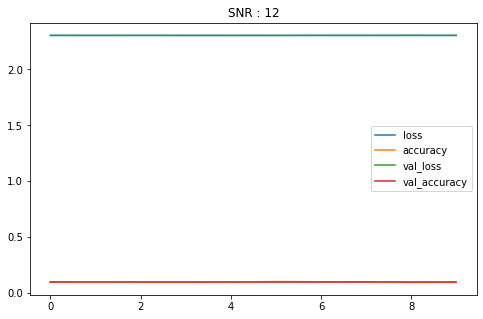

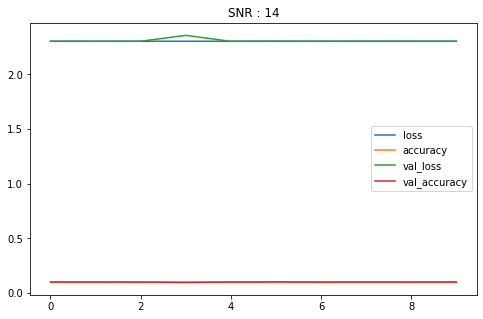

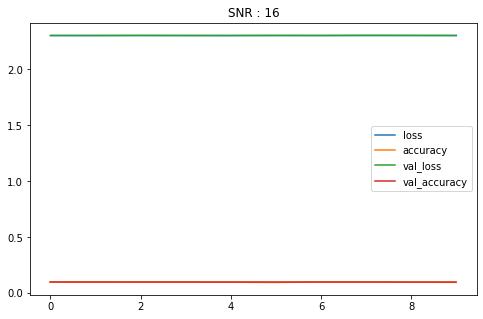

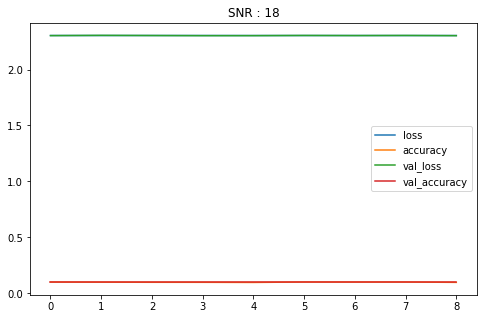

In [ ]:
plot_loss_acc(histories)

In [ ]:
acc_list, y_preds = test_models(models, feat_test, lab_test)

Test set accuracy mod 1 of SNR -20: 10%
Test set accuracy mod 2 of SNR -18: 10%
Test set accuracy mod 3 of SNR -16: 10%
Test set accuracy mod 4 of SNR -14: 10%
Test set accuracy mod 5 of SNR -12: 10%
Test set accuracy mod 6 of SNR -10: 10%
Test set accuracy mod 7 of SNR -8: 10%
Test set accuracy mod 8 of SNR -6: 10%
Test set accuracy mod 9 of SNR -4: 10%
Test set accuracy mod 10 of SNR -2: 10%
Test set accuracy mod 11 of SNR 0: 62%
Test set accuracy mod 12 of SNR 2: 60%
Test set accuracy mod 13 of SNR 4: 62%
Test set accuracy mod 14 of SNR 6: 77%
Test set accuracy mod 15 of SNR 8: 67%
Test set accuracy mod 16 of SNR 10: 76%
Test set accuracy mod 17 of SNR 12: 10%
Test set accuracy mod 18 of SNR 14: 10%
Test set accuracy mod 19 of SNR 16: 10%
Test set accuracy mod 20 of SNR 18: 10%


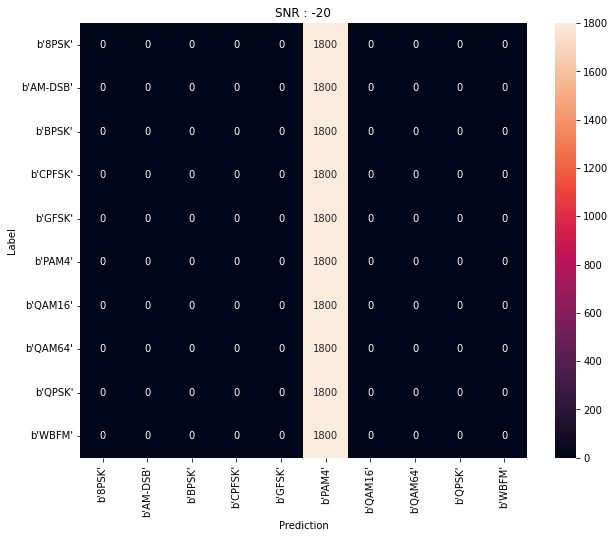

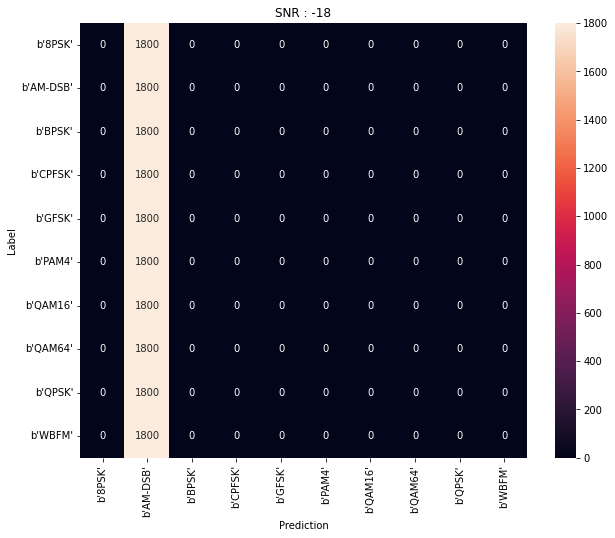

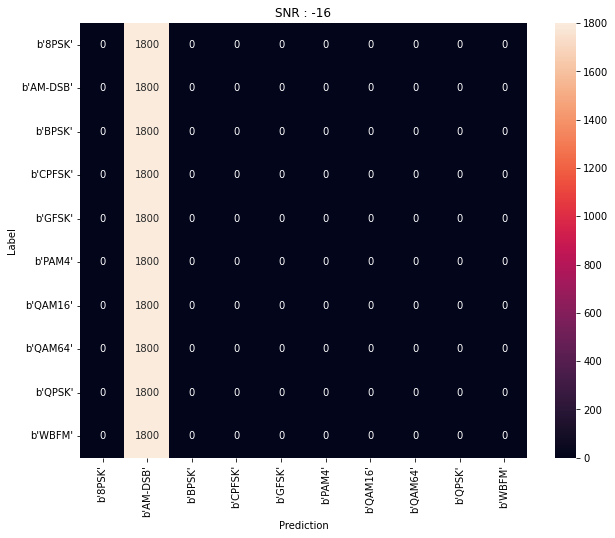

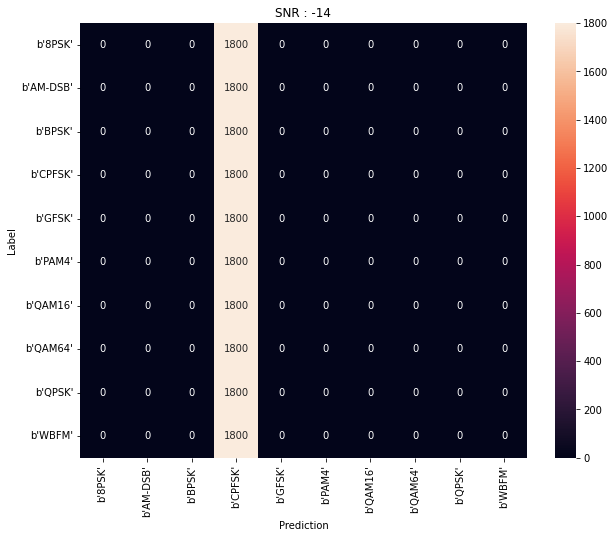

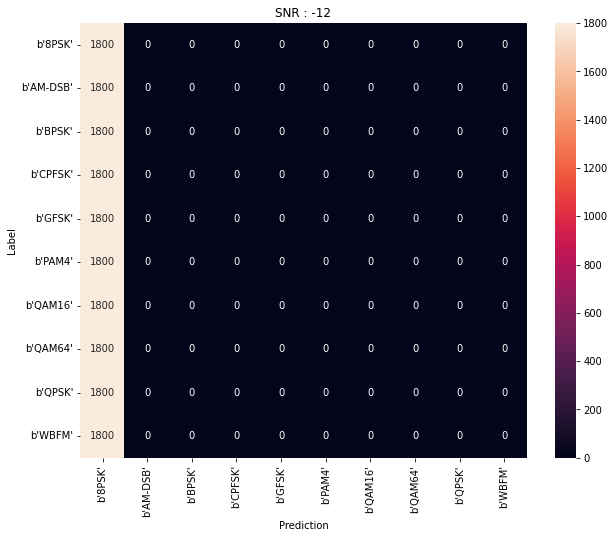

...

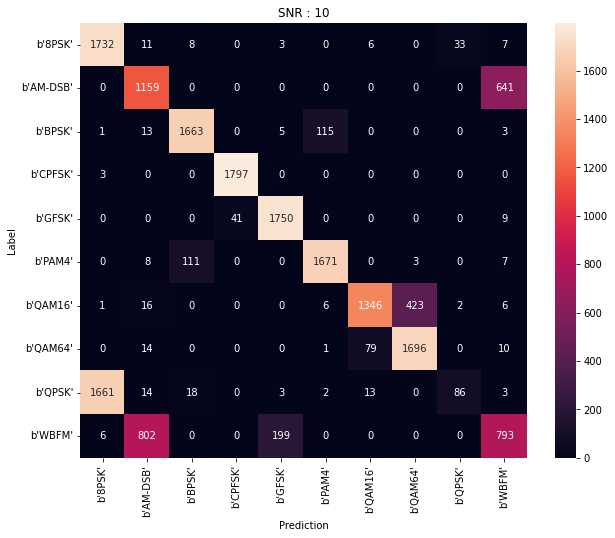

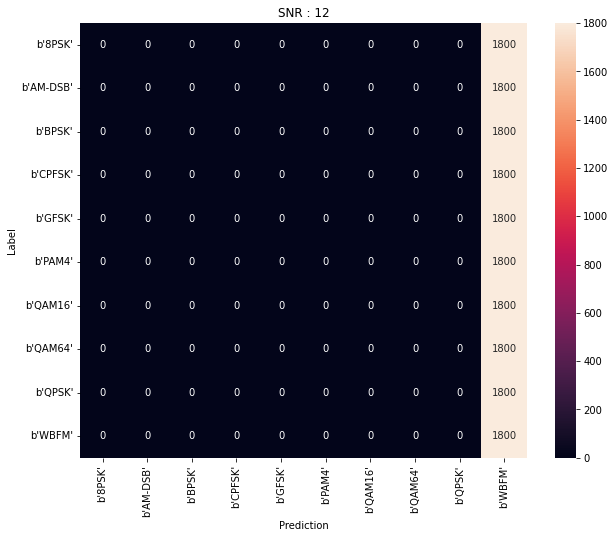

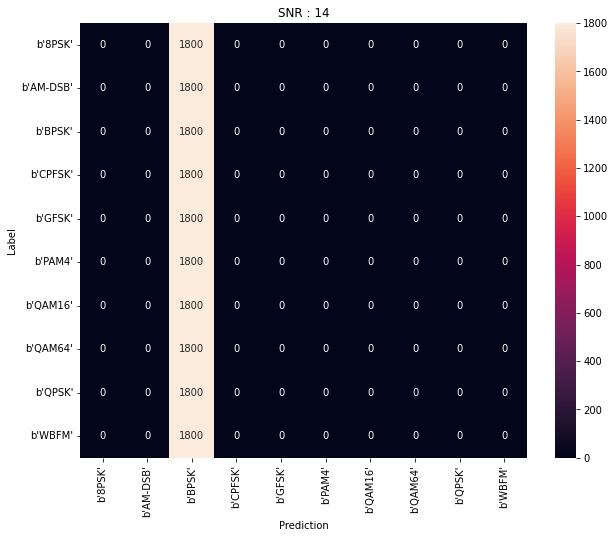

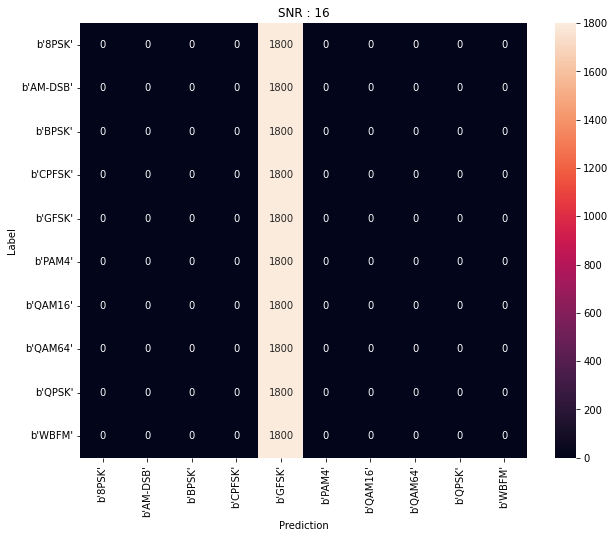

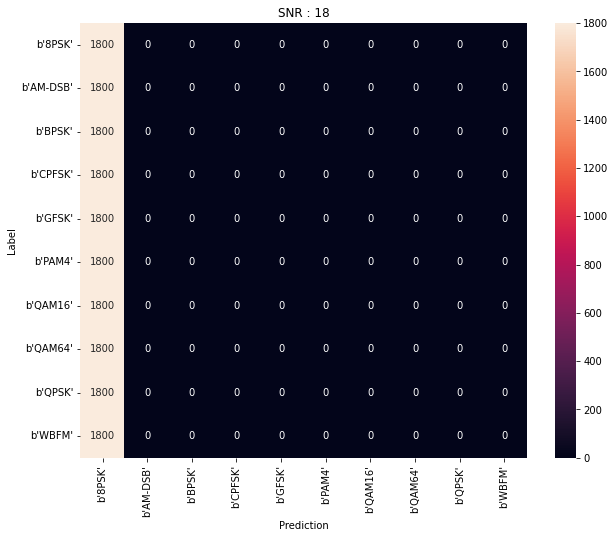

In [ ]:
confusion_matrixf(y_preds, lab_test)

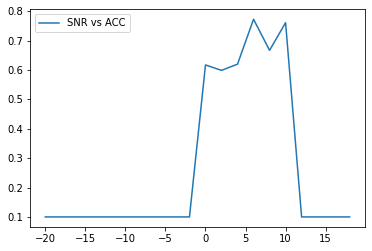

In [ ]:
plot_snr_acc(snrs, acc_list)

## RNN

In [ ]:
features_FDIT = get_FDIT(X).reshape((20, 60000, 2, 128))

In [ ]:
feat_train, feat_val, feat_test, lab_train, lab_val, lab_test = split(features_FDIT, label_enc)

In [ ]:
print(feat_train.shape, lab_train.shape)

(20, 39900, 2, 128) (20, 39900, 10)


In [ ]:
RNNmodels, RNNhistories = train_models(len(snrs), feat_train, feat_val, lab_train, lab_val, num_epochs, num_batch_size, 1e-4, 'RNN')


********************************************************* SNR -20 *********************************************************

Epoch 1/50
1247/1247 [==============================] - ETA: 0s - loss: 2.3072 - accuracy: 0.0978
Epoch 1: val_loss improved from inf to 2.30477, saving model to saved_models/classification0.hdf5
1247/1247 [==============================] - 10s 5ms/step - loss: 2.3072 - accuracy: 0.0978 - val_loss: 2.3048 - val_accuracy: 0.0952
Epoch 2/50
1247/1247 [==============================] - ETA: 0s - loss: 2.3038 - accuracy: 0.1019
Epoch 2: val_loss improved from 2.30477 to 2.30417, saving model to saved_models/classification0.hdf5
1247/1247 [==============================] - 5s 4ms/step - loss: 2.3038 - accuracy: 0.1019 - val_loss: 2.3042 - val_accuracy: 0.0957
Epoch 3/50
1241/1247 [============================>.] - ETA: 0s - loss: 2.3019 - accuracy: 0.1061
Epoch 3: val_loss improved from 2.30417 to 2.30406, saving model to saved_models/classification0.hdf5
1247/1247 [

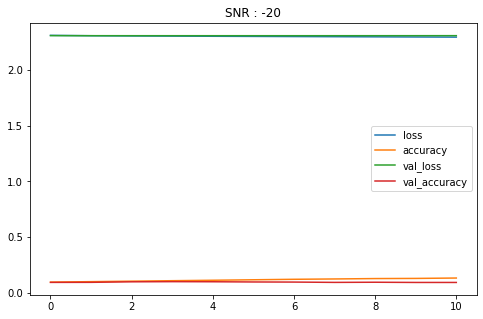

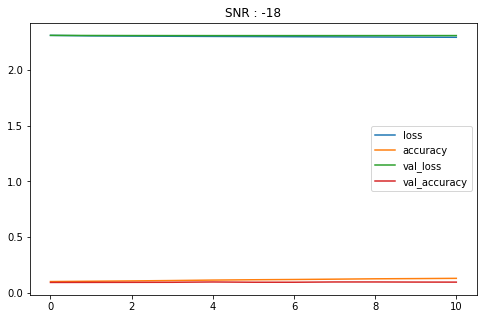

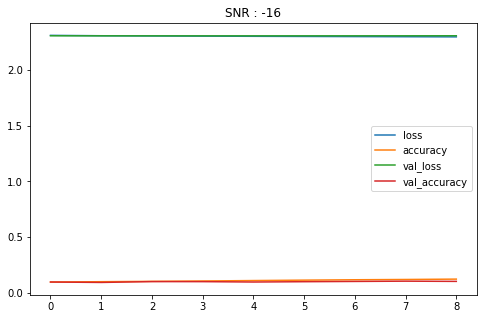

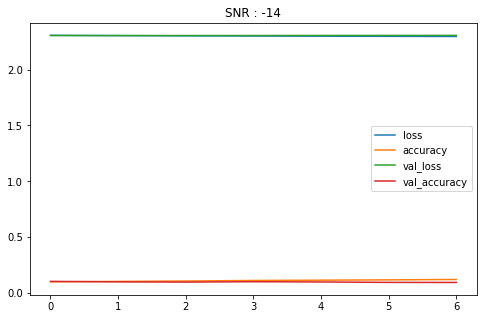

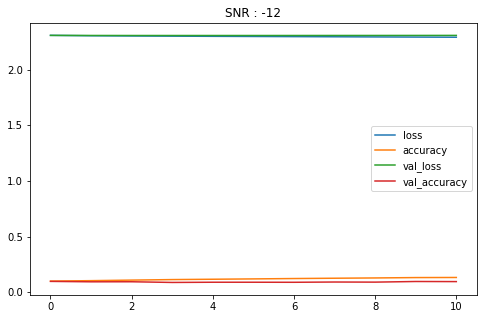

...

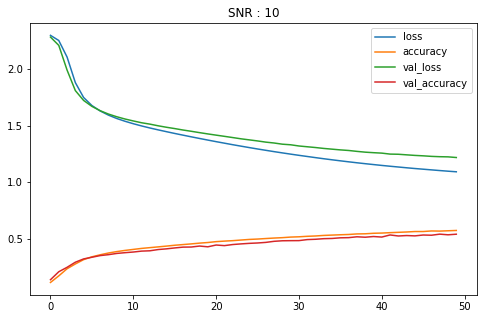

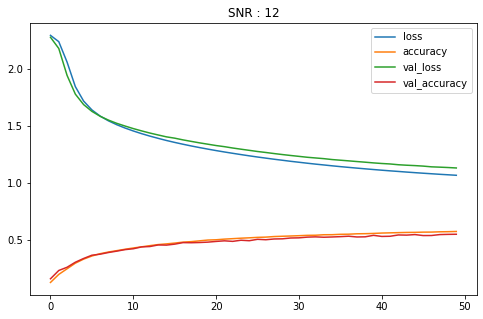

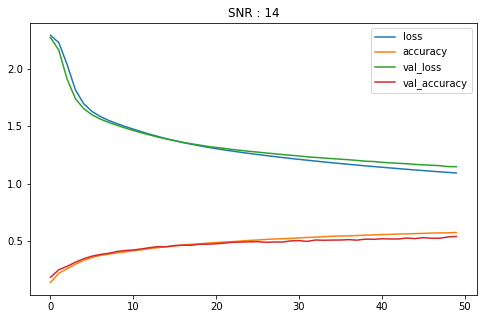

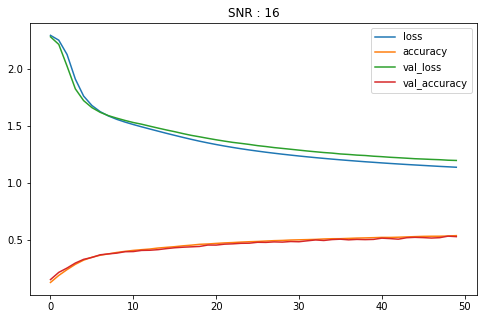

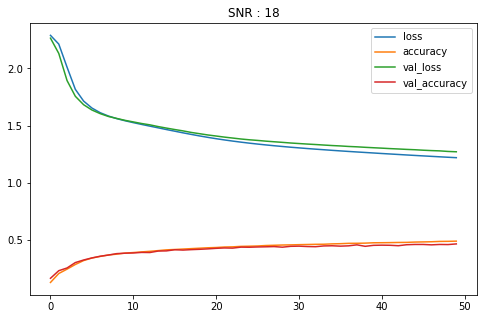

In [ ]:
plot_loss_acc(RNNhistories)

In [ ]:
RNN_acc_list, RNN_y_preds = test_models(RNNmodels, feat_test, lab_test)

In [ ]:
confusion_matrixf(RNN_y_preds, lab_test)

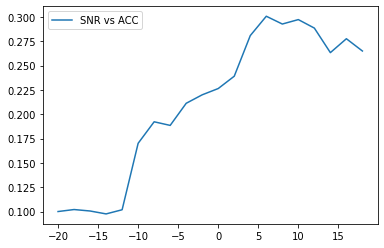

In [ ]:
plot_snr_acc(snrs, RNN_acc_list)

## LSTM

In [ ]:
LSTMmodels, LSTMhistories = train_models(len(snrs), feat_train, feat_val, lab_train, lab_val, num_epochs, num_batch_size, 1e-5, 'LSTM')



********************************************************* SNR -20 *********************************************************

Epoch 1/50
1247/1247 [==============================] - ETA: 0s - loss: 2.3033 - accuracy: 0.1012
Epoch 1: val_loss improved from inf to 2.30316, saving model to saved_models/classification0.hdf5
1247/1247 [==============================] - 8s 4ms/step - loss: 2.3033 - accuracy: 0.1012 - val_loss: 2.3032 - val_accuracy: 0.0919
Epoch 2/50
1239/1247 [============================>.] - ETA: 0s - loss: 2.3018 - accuracy: 0.1079
Epoch 2: val_loss did not improve from 2.30316
1247/1247 [==============================] - 4s 3ms/step - loss: 2.3017 - accuracy: 0.1079 - val_loss: 2.3035 - val_accuracy: 0.0967
Epoch 3/50
1244/1247 [============================>.] - ETA: 0s - loss: 2.3006 - accuracy: 0.1095
Epoch 3: val_loss did not improve from 2.30316
1247/1247 [==============================] - 5s 4ms/step - loss: 2.3006 - accuracy: 0.1095 - val_loss: 2.3037 - val_accura

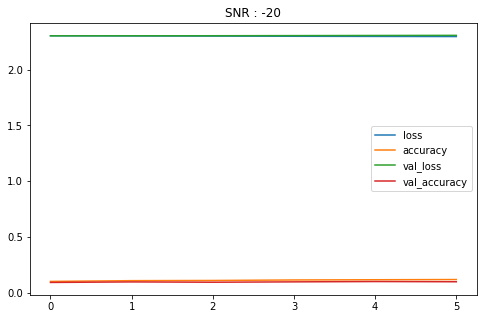

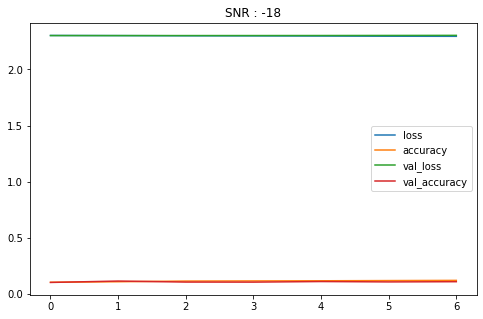

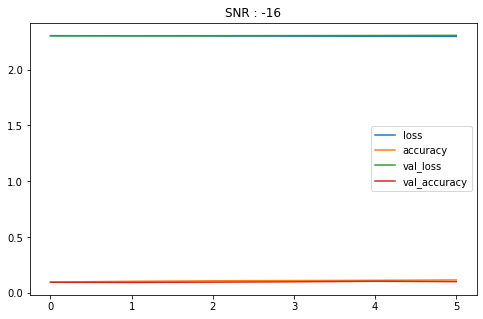

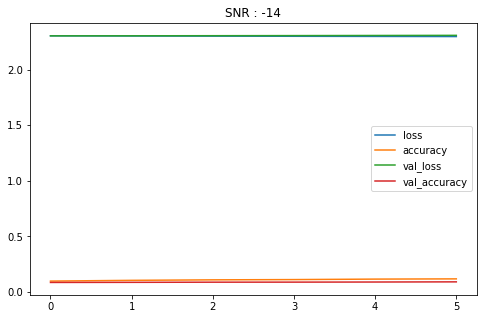

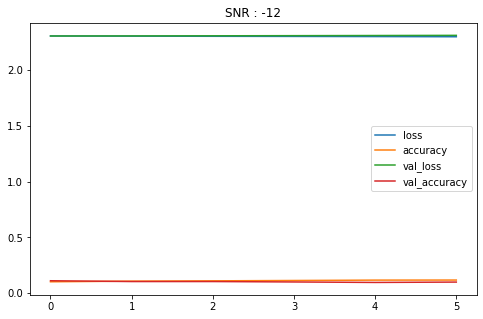

...

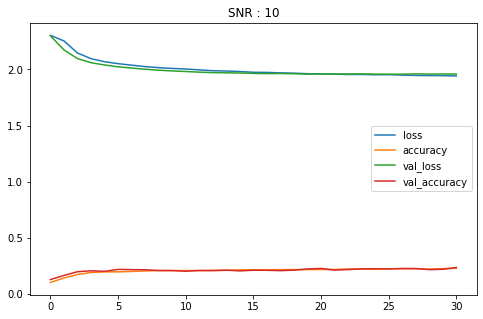

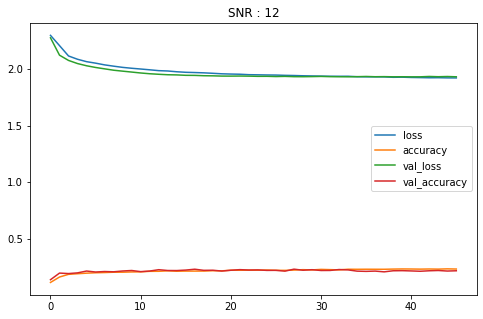

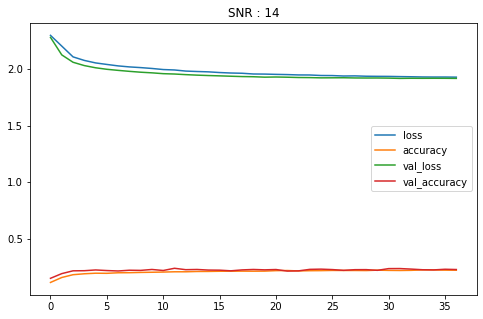

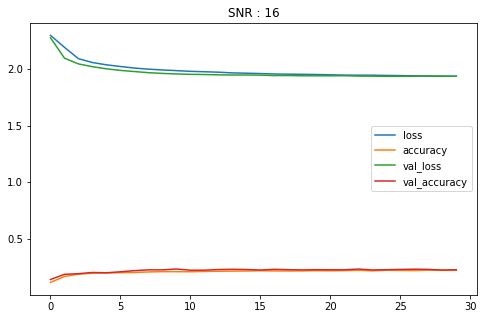

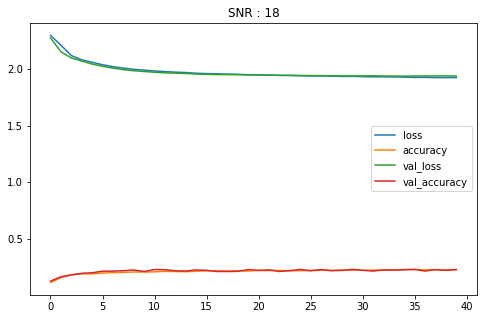

In [ ]:
plot_loss_acc(LSTMhistories)

In [ ]:
LSTM_acc_list, LSTM_y_preds = test_models(LSTMmodels, feat_test, lab_test)

Test set accuracy mod 1 of SNR -20: 10%
Test set accuracy mod 2 of SNR -18: 10%
Test set accuracy mod 3 of SNR -16: 10%
Test set accuracy mod 4 of SNR -14: 10%
Test set accuracy mod 5 of SNR -12: 10%
Test set accuracy mod 6 of SNR -10: 18%
Test set accuracy mod 7 of SNR -8: 19%
Test set accuracy mod 8 of SNR -6: 20%
Test set accuracy mod 9 of SNR -4: 22%
Test set accuracy mod 10 of SNR -2: 21%
Test set accuracy mod 11 of SNR 0: 22%
Test set accuracy mod 12 of SNR 2: 23%
Test set accuracy mod 13 of SNR 4: 22%
Test set accuracy mod 14 of SNR 6: 25%
Test set accuracy mod 15 of SNR 8: 23%
Test set accuracy mod 16 of SNR 10: 22%
Test set accuracy mod 17 of SNR 12: 22%
Test set accuracy mod 18 of SNR 14: 22%
Test set accuracy mod 19 of SNR 16: 22%
Test set accuracy mod 20 of SNR 18: 22%


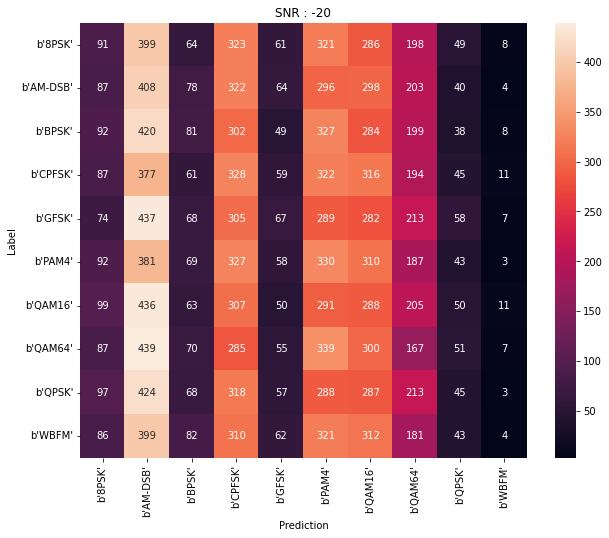

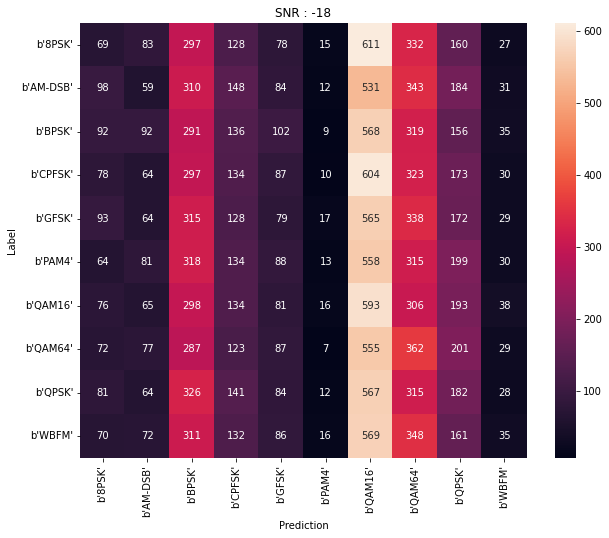

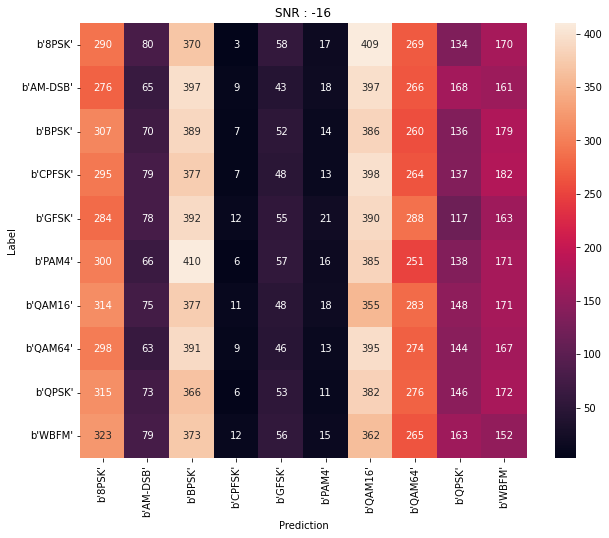

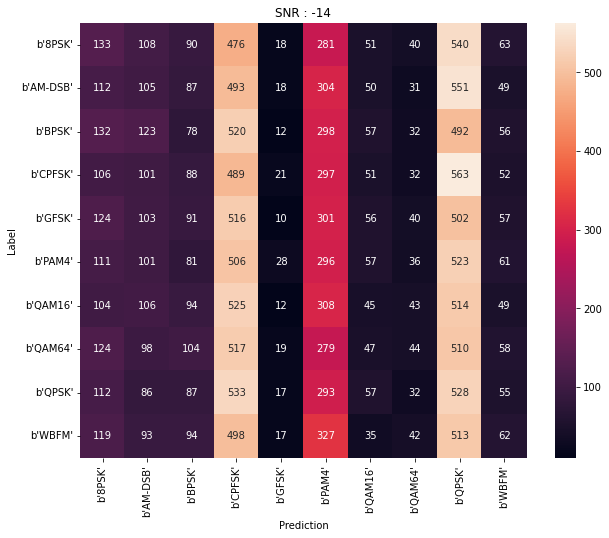

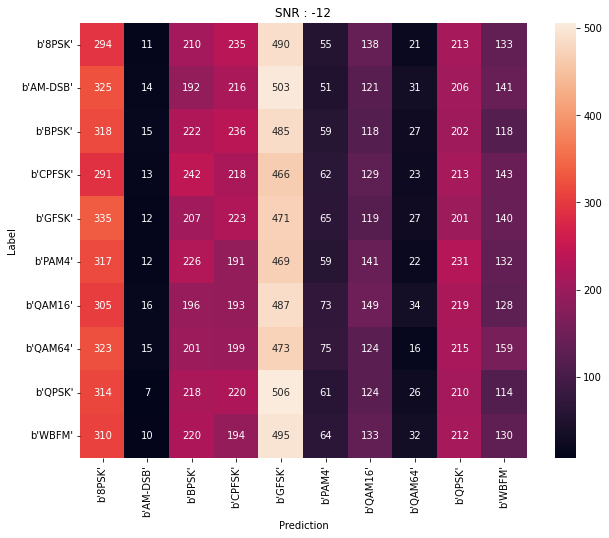

...

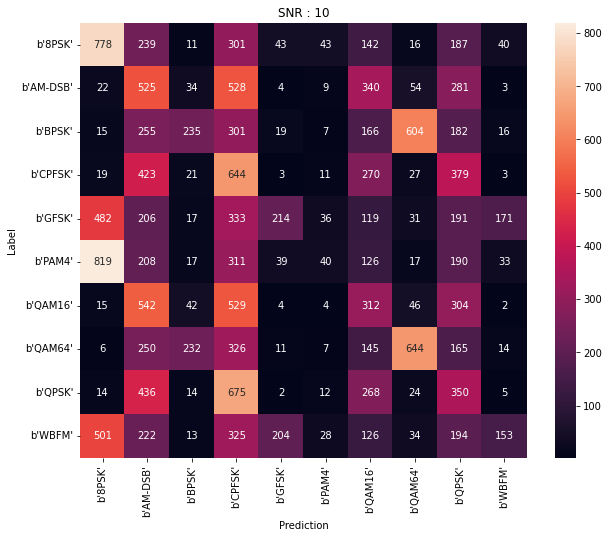

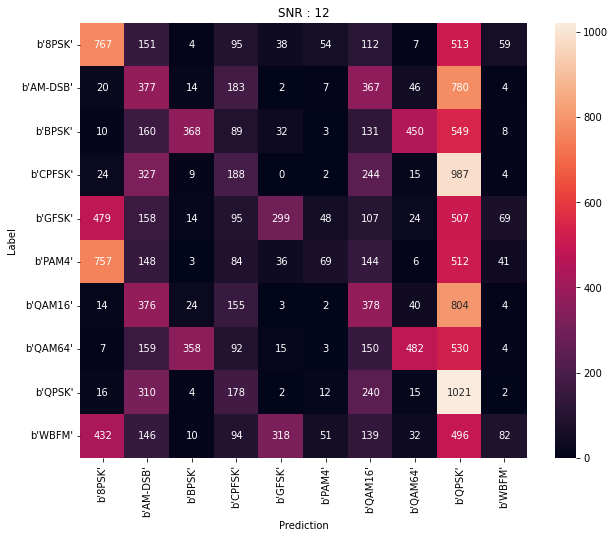

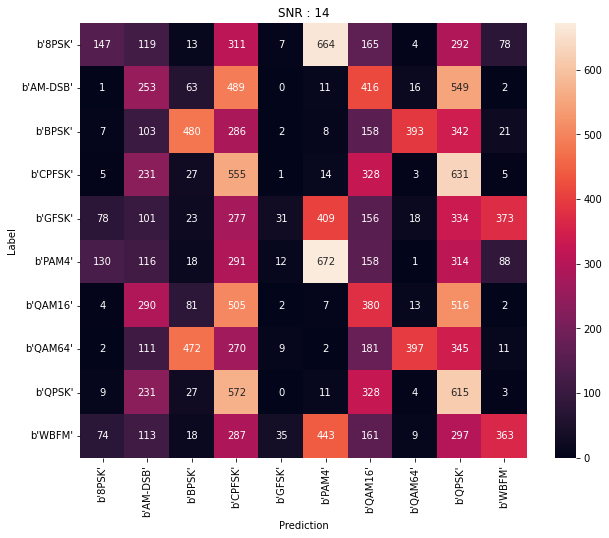

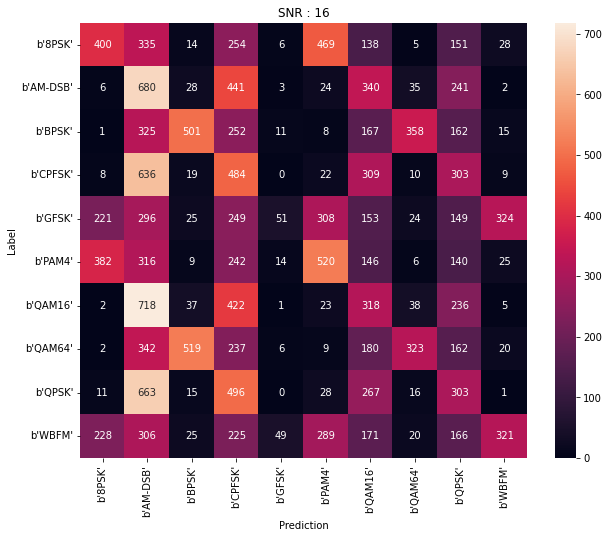

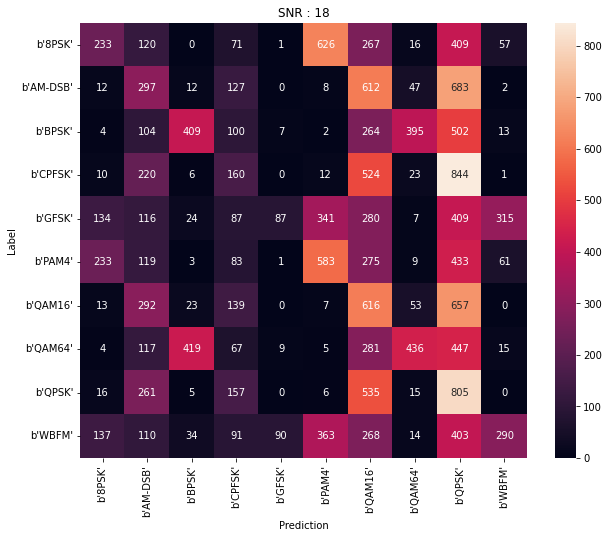

In [ ]:
confusion_matrixf(LSTM_y_preds, lab_test)

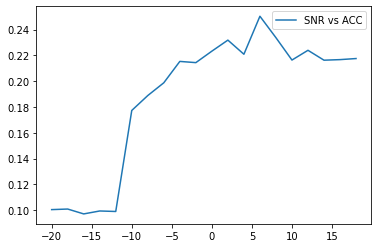

In [ ]:
plot_snr_acc(snrs, LSTM_acc_list)

# Integral in time and Models

## CNN

In [ ]:
features_IIT= integrate.cumtrapz(X, initial=0)
features_IIT = np.asarray(features_IIT).reshape((20, 60000, 2, 128, 1))
print(features_IIT.shape)

In [ ]:
feat_train, feat_val, feat_test, lab_train, lab_val, lab_test = split(features_IIT, label_enc)

In [ ]:
print(feat_train.shape, lab_train.shape)

In [ ]:
models, histories = train_models(len(snrs), feat_train, feat_val, lab_train, lab_val, num_epochs, num_batch_size, 1e-5,'CNN')

Streaming output truncated to the last 5000 lines.
Epoch 60/100
1247/1247 [==============================] - ETA: 0s - loss: 1.6577 - accuracy: 0.3305
Epoch 60: val_loss improved from 1.67545 to 1.67396, saving model to saved_models/classification7.hdf5
1247/1247 [==============================] - 6s 5ms/step - loss: 1.6577 - accuracy: 0.3305 - val_loss: 1.6740 - val_accuracy: 0.3295
Epoch 61/100
1243/1247 [============================>.] - ETA: 0s - loss: 1.6567 - accuracy: 0.3302
Epoch 61: val_loss improved from 1.67396 to 1.67365, saving model to saved_models/classification7.hdf5
1247/1247 [==============================] - 6s 5ms/step - loss: 1.6564 - accuracy: 0.3305 - val_loss: 1.6737 - val_accuracy: 0.3319
Epoch 62/100
1245/1247 [============================>.] - ETA: 0s - loss: 1.6550 - accuracy: 0.3312
Epoch 62: val_loss improved from 1.67365 to 1.67185, saving model to saved_models/classification7.hdf5
1247/1247 [==============================] - 6s 5ms/step - loss: 1.6549 - 

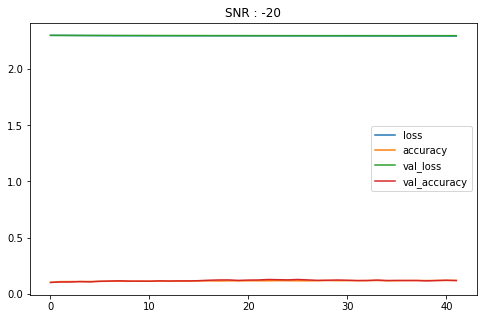

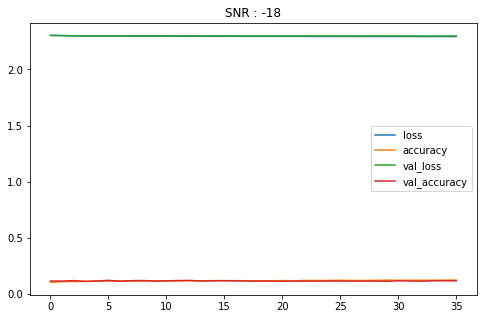

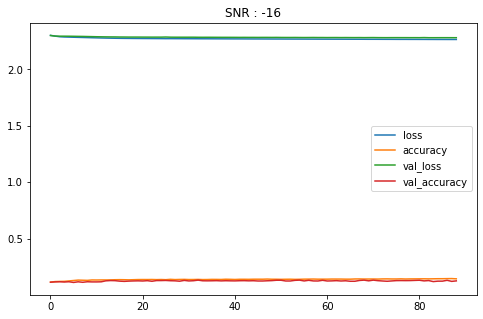

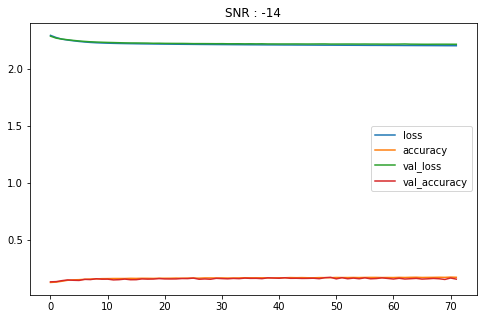

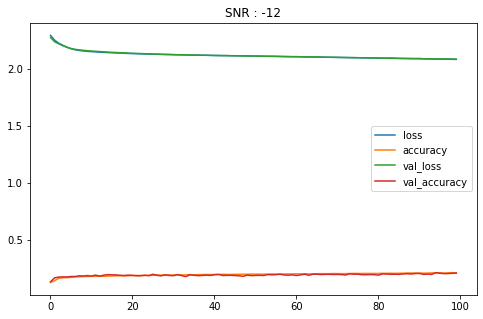

...

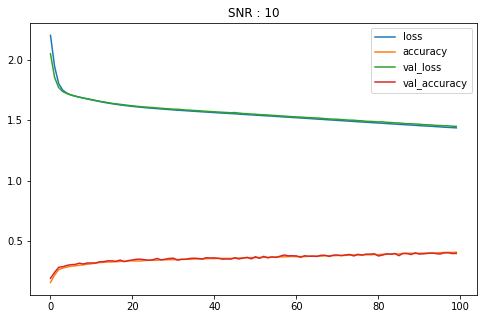

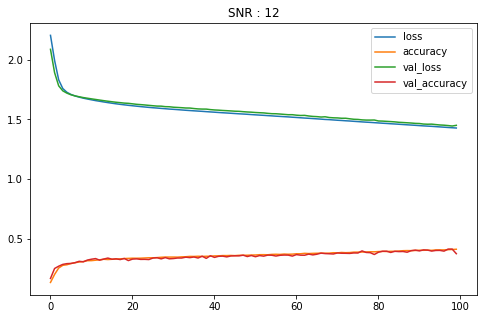

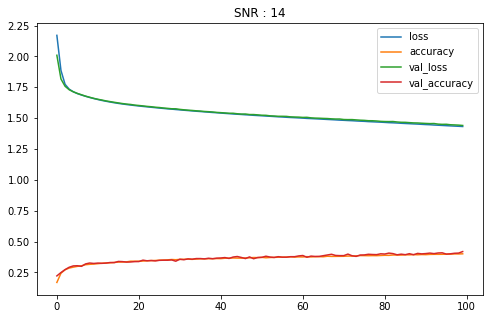

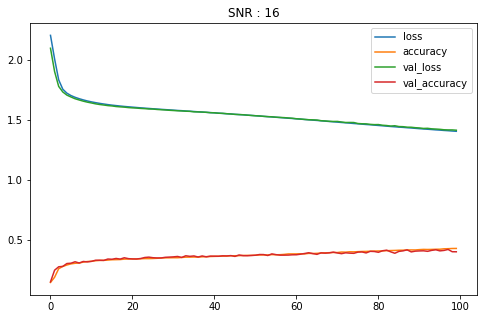

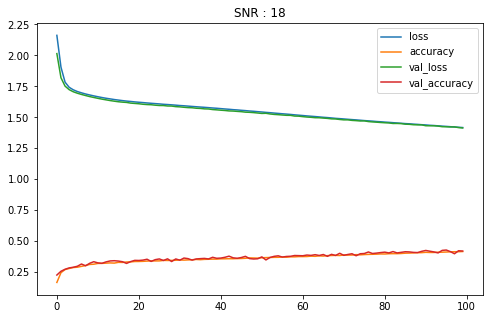

In [ ]:
plot_loss_acc(histories)

In [ ]:
acc_list, y_preds = test_models(models, feat_test, lab_test)

Test set accuracy mod 1 of SNR -20: 11%
Test set accuracy mod 2 of SNR -18: 12%
Test set accuracy mod 3 of SNR -16: 13%
Test set accuracy mod 4 of SNR -14: 16%
Test set accuracy mod 5 of SNR -12: 21%
Test set accuracy mod 6 of SNR -10: 26%
Test set accuracy mod 7 of SNR -8: 30%
Test set accuracy mod 8 of SNR -6: 34%
Test set accuracy mod 9 of SNR -4: 36%
Test set accuracy mod 10 of SNR -2: 38%
Test set accuracy mod 11 of SNR 0: 40%
Test set accuracy mod 12 of SNR 2: 43%
Test set accuracy mod 13 of SNR 4: 39%
Test set accuracy mod 14 of SNR 6: 38%
Test set accuracy mod 15 of SNR 8: 41%
Test set accuracy mod 16 of SNR 10: 40%
Test set accuracy mod 17 of SNR 12: 38%
Test set accuracy mod 18 of SNR 14: 40%
Test set accuracy mod 19 of SNR 16: 41%
Test set accuracy mod 20 of SNR 18: 41%


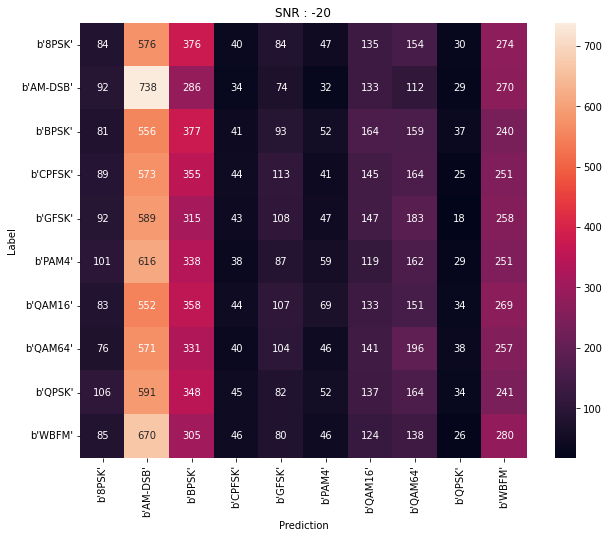

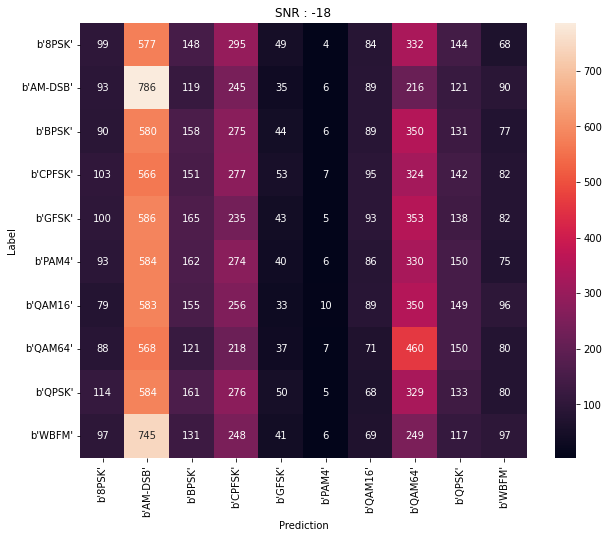

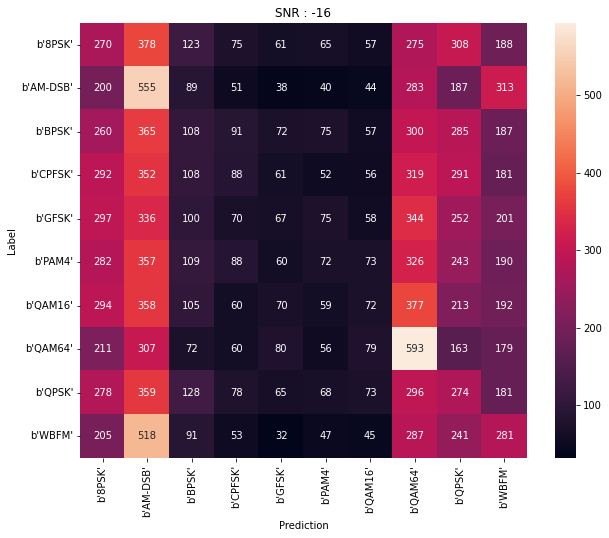

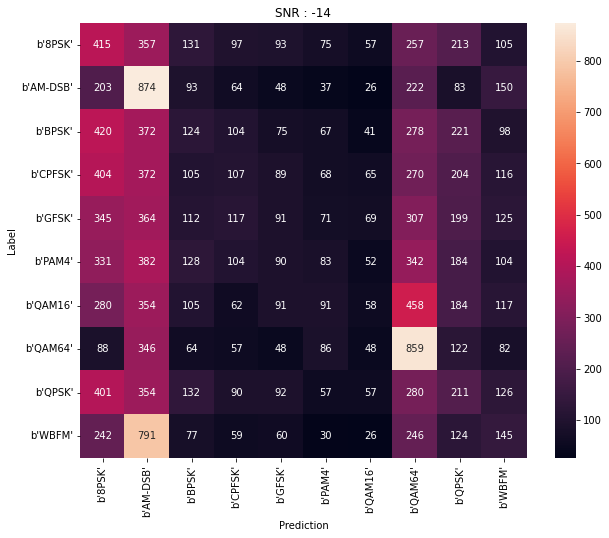

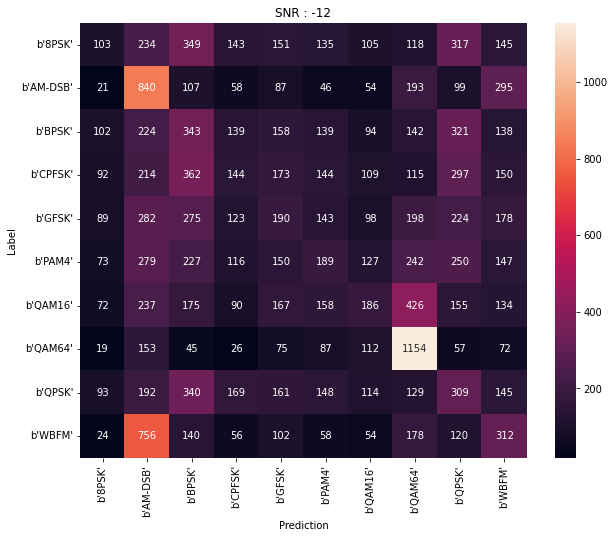

...

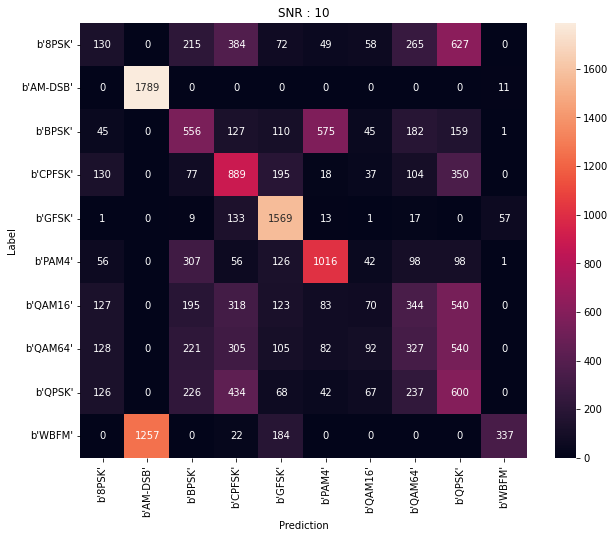

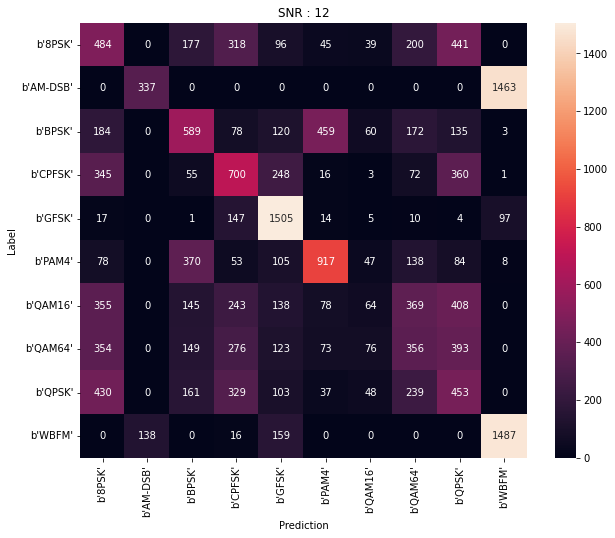

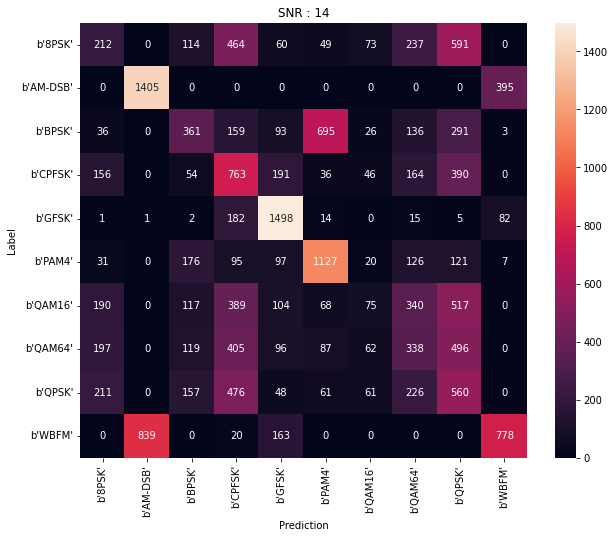

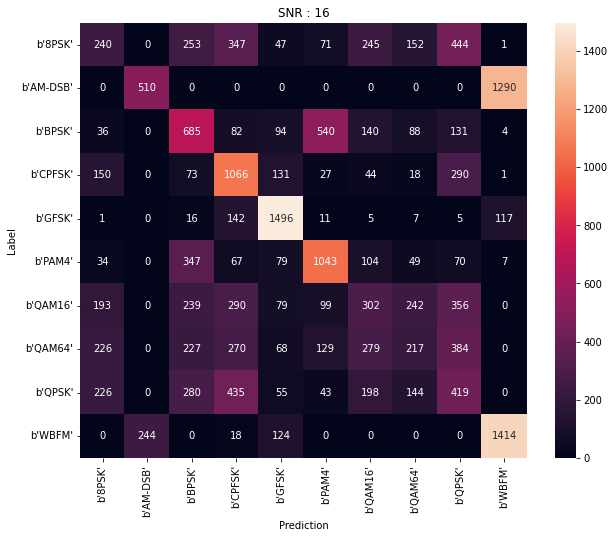

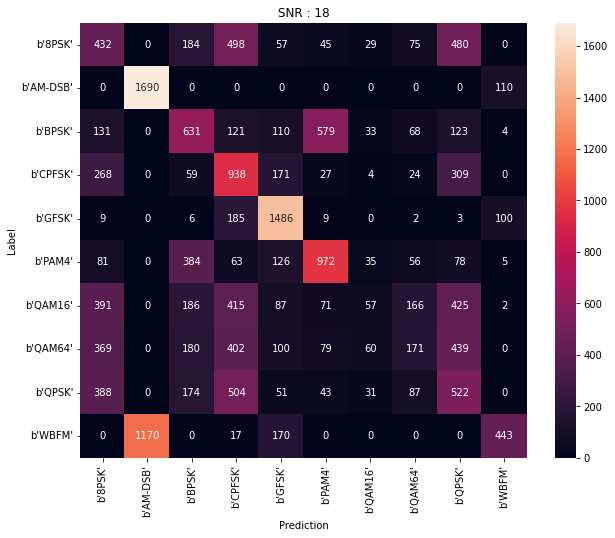

In [ ]:
confusion_matrixf(y_preds, lab_test)

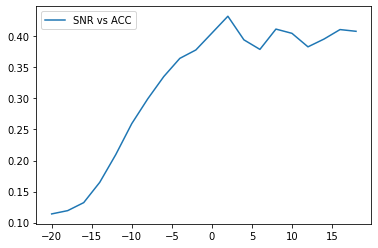

In [ ]:
plot_snr_acc(snrs, acc_list)

## RNN

In [ ]:
features_IITRNN= integrate.cumtrapz(X, initial=0)
features_IITRNN = np.asarray(features_IITRNN).reshape((20, 60000, 2, 128))
print(features_IITRNN.shape)

(20, 60000, 2, 128)


In [ ]:
feat_train, feat_val, feat_test, lab_train, lab_val, lab_test = split(features_IITRNN, label_enc)

In [ ]:
print(features_IITRNN.shape, label_enc.shape)

(20, 60000, 2, 128) (20, 60000, 10)


In [ ]:
RNNmodels, RNNhistories = train_models(len(snrs), feat_train, feat_val, lab_train, lab_val, num_epochs, num_batch_size, 1e-2, 'RNN')


********************************************************* SNR -20 *********************************************************

Epoch 1/50
1245/1247 [============================>.] - ETA: 0s - loss: 2.3057 - accuracy: 0.1025
Epoch 1: val_loss improved from inf to 2.30567, saving model to saved_models/classification0.hdf5
1247/1247 [==============================] - 10s 5ms/step - loss: 2.3056 - accuracy: 0.1025 - val_loss: 2.3057 - val_accuracy: 0.0995
Epoch 2/50
1247/1247 [==============================] - ETA: 0s - loss: 2.3037 - accuracy: 0.1070
Epoch 2: val_loss improved from 2.30567 to 2.30290, saving model to saved_models/classification0.hdf5
1247/1247 [==============================] - 5s 4ms/step - loss: 2.3037 - accuracy: 0.1070 - val_loss: 2.3029 - val_accuracy: 0.1033
Epoch 3/50
1240/1247 [============================>.] - ETA: 0s - loss: 2.3036 - accuracy: 0.1025
Epoch 3: val_loss improved from 2.30290 to 2.30183, saving model to saved_models/classification0.hdf5
1247/1247 [

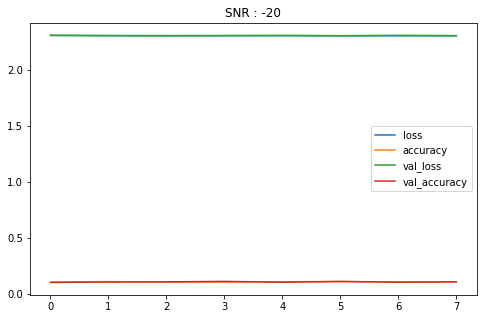

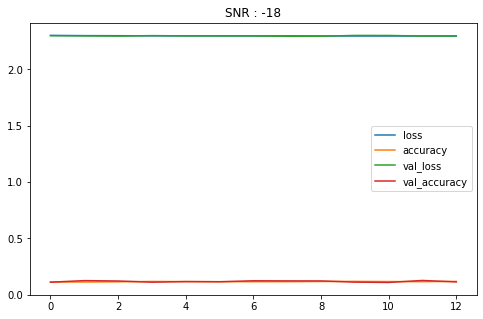

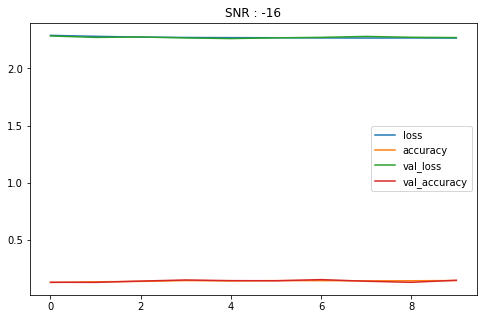

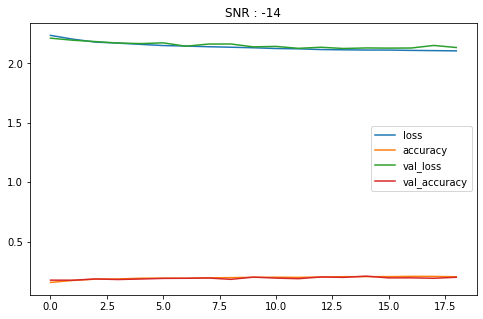

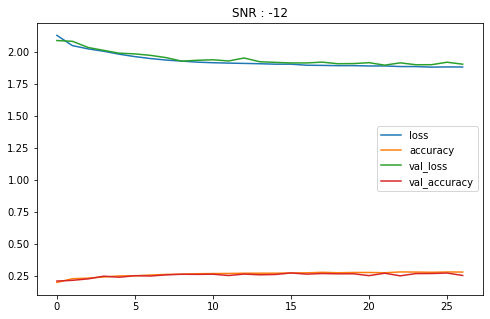

...

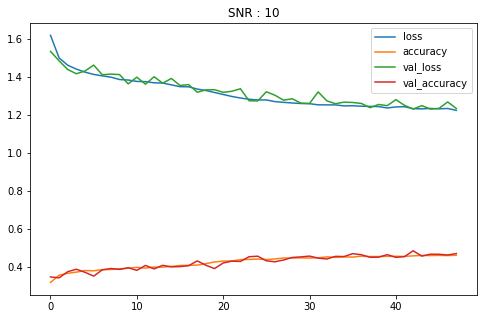

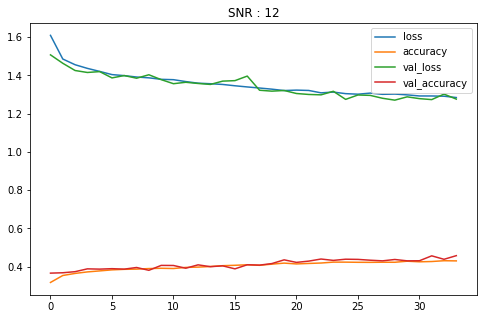

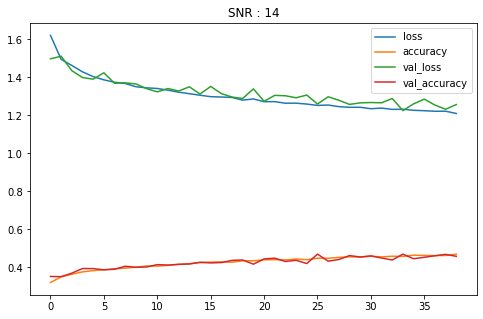

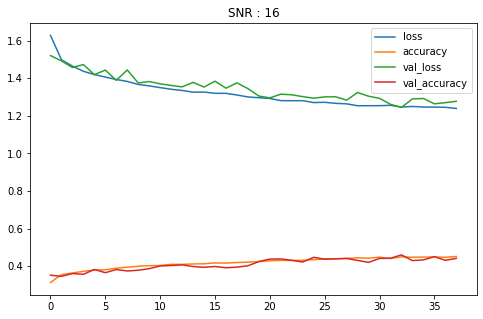

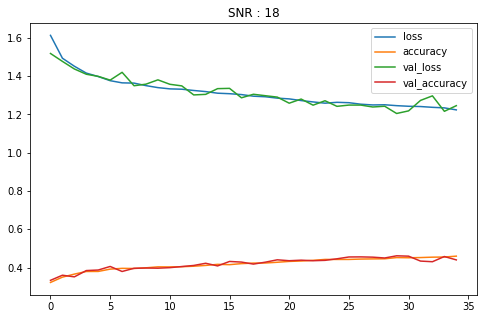

In [ ]:
plot_loss_acc(RNNhistories)

In [ ]:
RNN_acc_list, RNN_y_preds = test_models(RNNmodels, feat_test, lab_test)

Test set accuracy mod 1 of SNR -20: 11%
Test set accuracy mod 2 of SNR -18: 11%
Test set accuracy mod 3 of SNR -16: 14%
Test set accuracy mod 4 of SNR -14: 20%
Test set accuracy mod 5 of SNR -12: 27%
Test set accuracy mod 6 of SNR -10: 36%
Test set accuracy mod 7 of SNR -8: 43%
Test set accuracy mod 8 of SNR -6: 44%
Test set accuracy mod 9 of SNR -4: 50%
Test set accuracy mod 10 of SNR -2: 47%
Test set accuracy mod 11 of SNR 0: 42%
Test set accuracy mod 12 of SNR 2: 41%
Test set accuracy mod 13 of SNR 4: 41%
Test set accuracy mod 14 of SNR 6: 42%
Test set accuracy mod 15 of SNR 8: 40%
Test set accuracy mod 16 of SNR 10: 46%
Test set accuracy mod 17 of SNR 12: 42%
Test set accuracy mod 18 of SNR 14: 46%
Test set accuracy mod 19 of SNR 16: 45%
Test set accuracy mod 20 of SNR 18: 45%


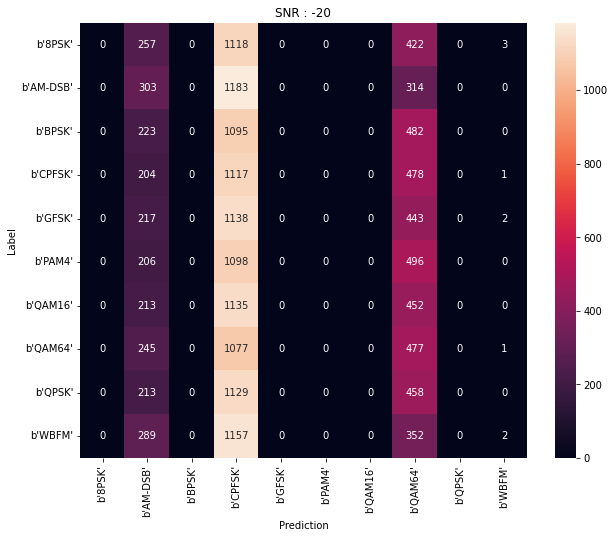

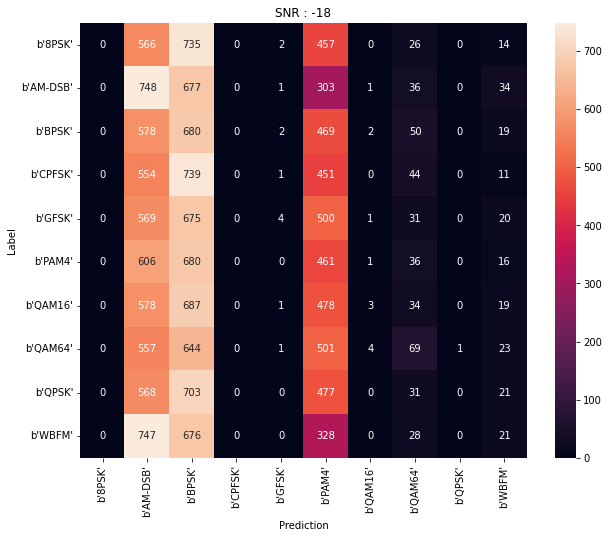

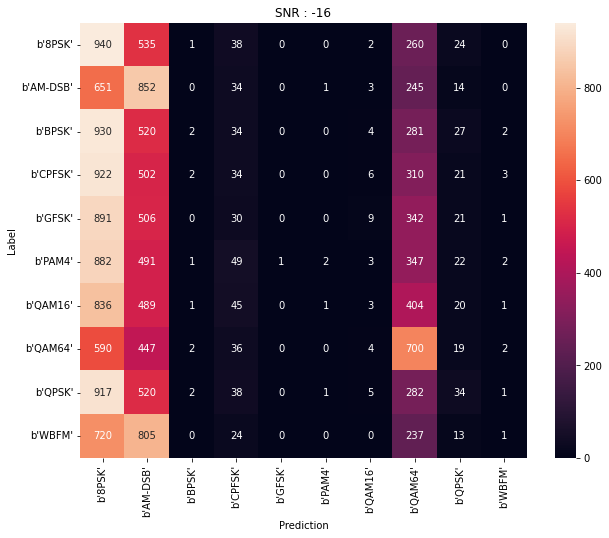

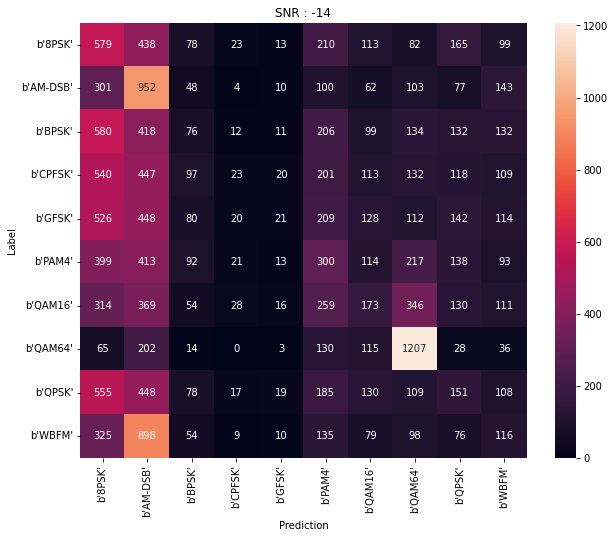

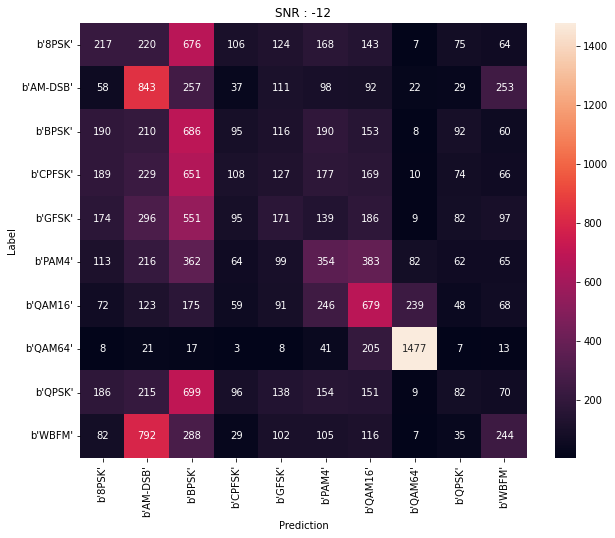

...

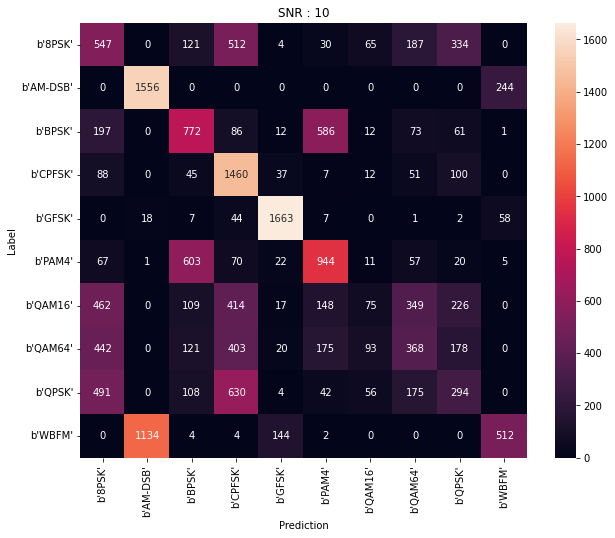

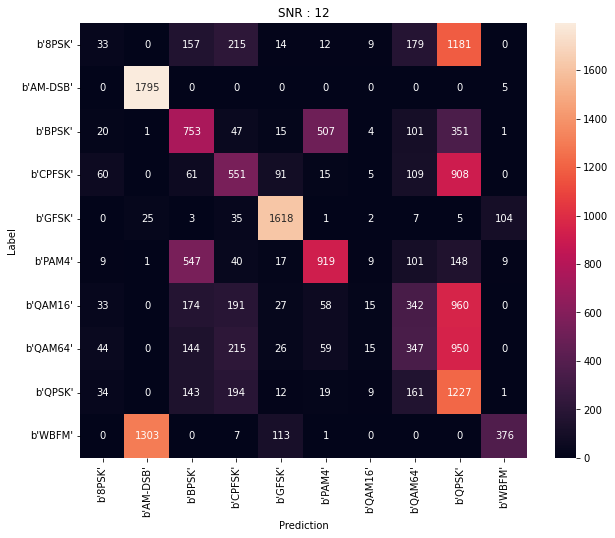

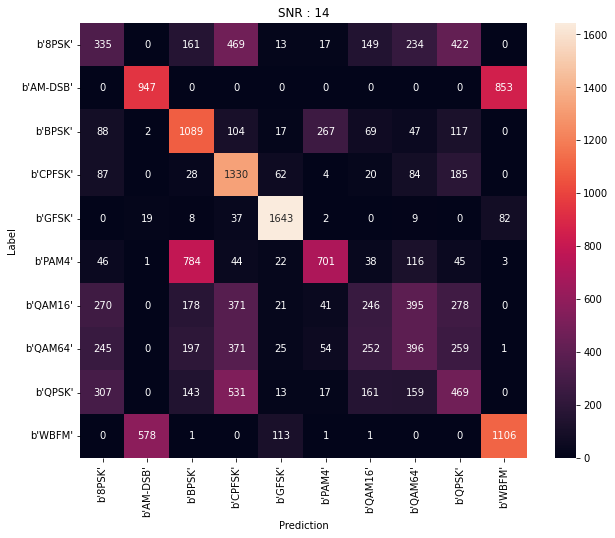

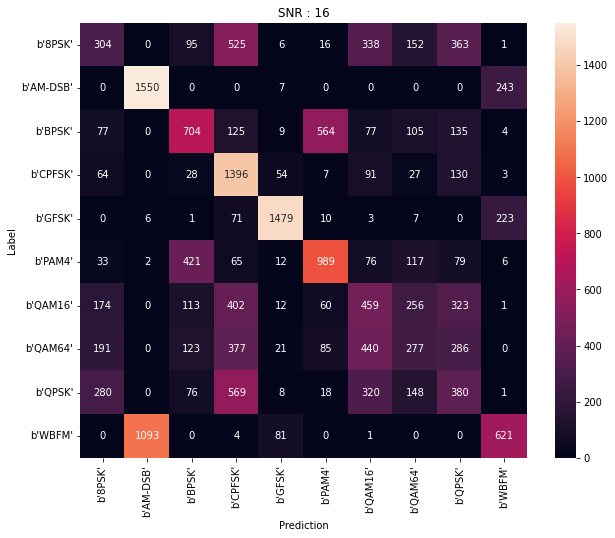

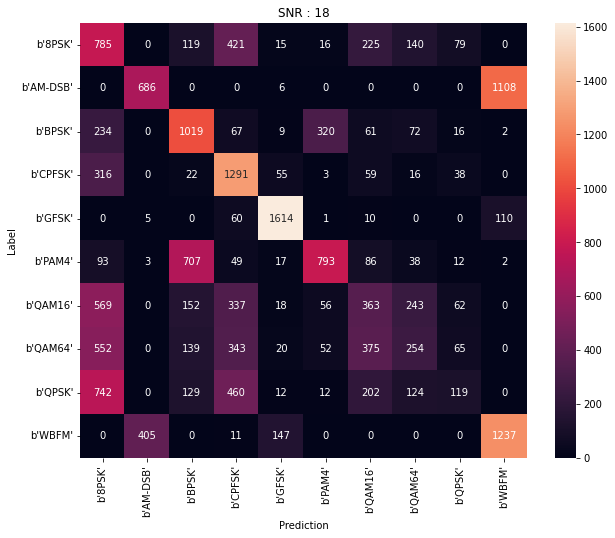

In [ ]:
confusion_matrixf(RNN_y_preds, lab_test)

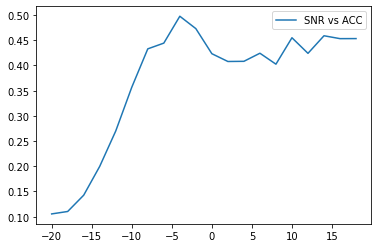

In [ ]:
plot_snr_acc(snrs, RNN_acc_list)

## LSTM

In [ ]:
features_IITLSTM= integrate.cumtrapz(X, initial=0)
features_IITLSTM = np.asarray(features_IITLSTM).reshape((20, 60000, 2, 128))
print(features_IITLSTM.shape)

(20, 60000, 2, 128)


In [ ]:
feat_train, feat_val, feat_test, lab_train, lab_val, lab_test = split(features_IITLSTM, label_enc)

In [ ]:
LSTMmodels, LSTMhistories = train_models(len(snrs), feat_train, feat_val, lab_train, lab_val, num_epochs, num_batch_size, 1e-5, 'LSTM')



********************************************************* SNR -20 *********************************************************

Epoch 1/50
1235/1247 [============================>.] - ETA: 0s - loss: 2.3023 - accuracy: 0.1039
Epoch 1: val_loss improved from inf to 2.30166, saving model to saved_models/classification0.hdf5
1247/1247 [==============================] - 13s 5ms/step - loss: 2.3023 - accuracy: 0.1038 - val_loss: 2.3017 - val_accuracy: 0.1105
Epoch 2/50
1240/1247 [============================>.] - ETA: 0s - loss: 2.3011 - accuracy: 0.1063
Epoch 2: val_loss improved from 2.30166 to 2.30069, saving model to saved_models/classification0.hdf5
1247/1247 [==============================] - 5s 4ms/step - loss: 2.3011 - accuracy: 0.1063 - val_loss: 2.3007 - val_accuracy: 0.1176
Epoch 3/50
1238/1247 [============================>.] - ETA: 0s - loss: 2.3003 - accuracy: 0.1061
Epoch 3: val_loss improved from 2.30069 to 2.30041, saving model to saved_models/classification0.hdf5
1247/1247 [

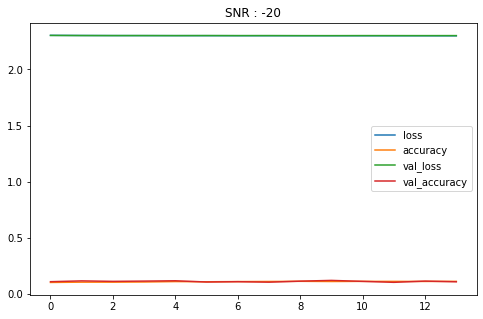

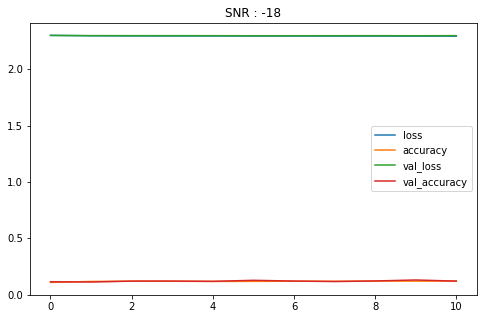

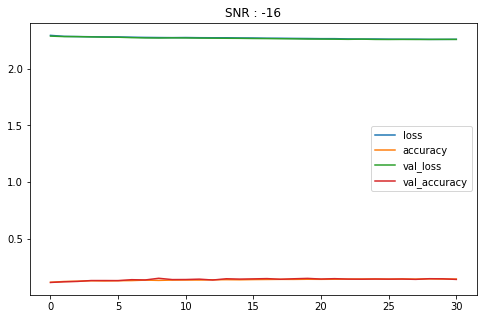

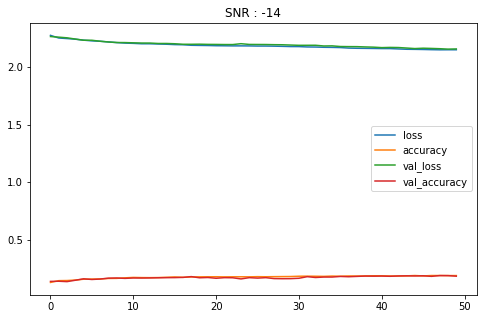

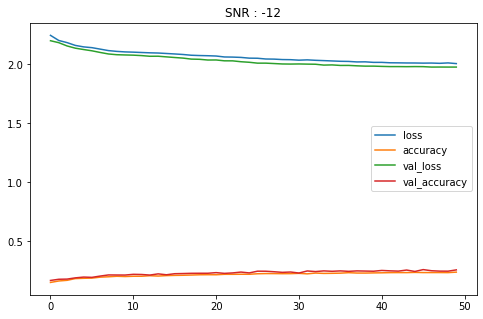

...

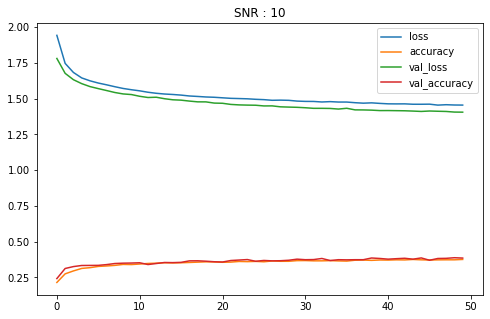

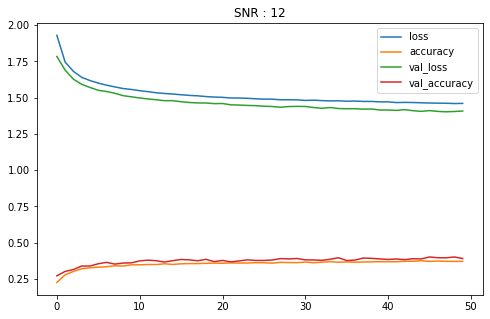

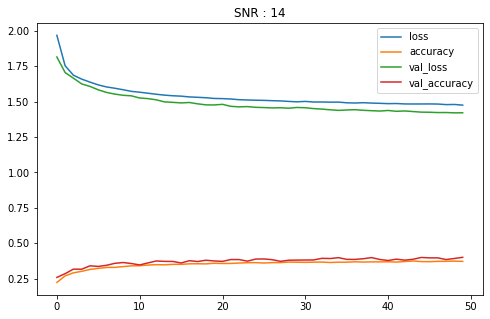

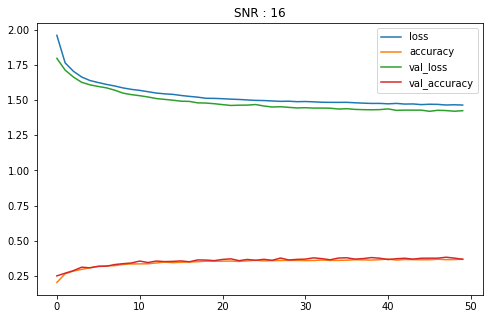

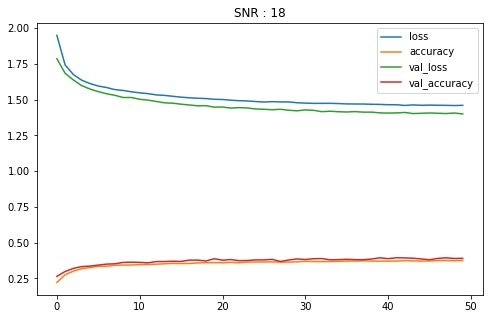

In [ ]:
plot_loss_acc(LSTMhistories)

In [ ]:
LSTM_acc_list, LSTM_y_preds = test_models(LSTMmodels, feat_test, lab_test)

Test set accuracy mod 1 of SNR -20: 11%
Test set accuracy mod 2 of SNR -18: 12%
Test set accuracy mod 3 of SNR -16: 15%
Test set accuracy mod 4 of SNR -14: 20%
Test set accuracy mod 5 of SNR -12: 25%
Test set accuracy mod 6 of SNR -10: 31%
Test set accuracy mod 7 of SNR -8: 36%
Test set accuracy mod 8 of SNR -6: 37%
Test set accuracy mod 9 of SNR -4: 38%
Test set accuracy mod 10 of SNR -2: 37%
Test set accuracy mod 11 of SNR 0: 38%
Test set accuracy mod 12 of SNR 2: 40%
Test set accuracy mod 13 of SNR 4: 38%
Test set accuracy mod 14 of SNR 6: 41%
Test set accuracy mod 15 of SNR 8: 39%
Test set accuracy mod 16 of SNR 10: 40%
Test set accuracy mod 17 of SNR 12: 40%
Test set accuracy mod 18 of SNR 14: 40%
Test set accuracy mod 19 of SNR 16: 38%
Test set accuracy mod 20 of SNR 18: 40%


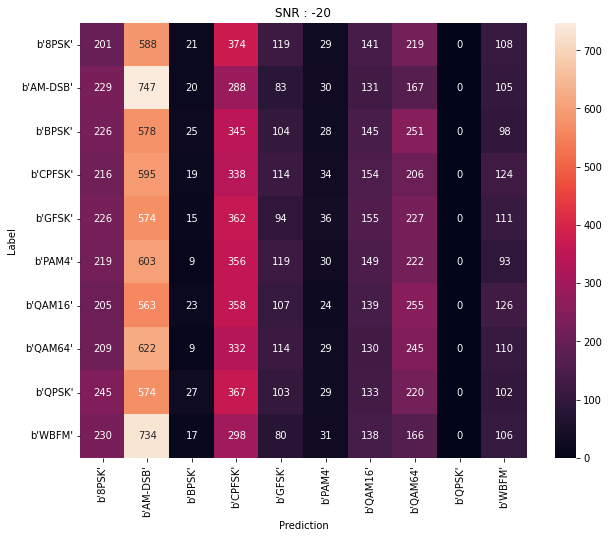

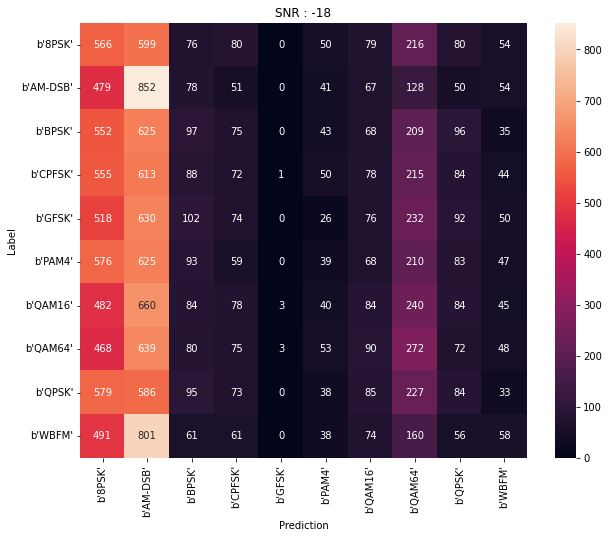

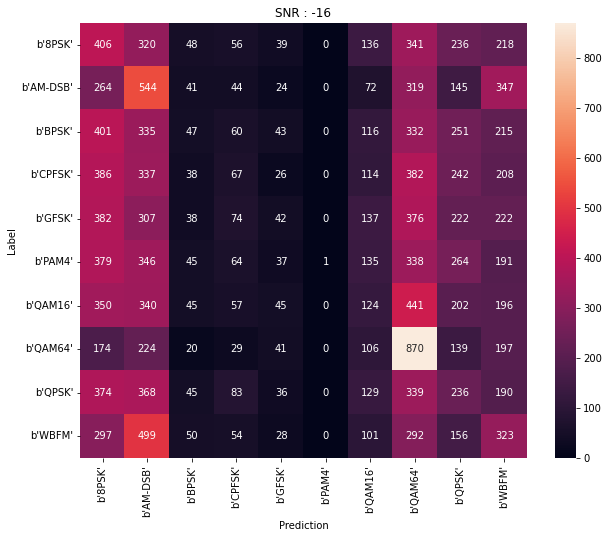

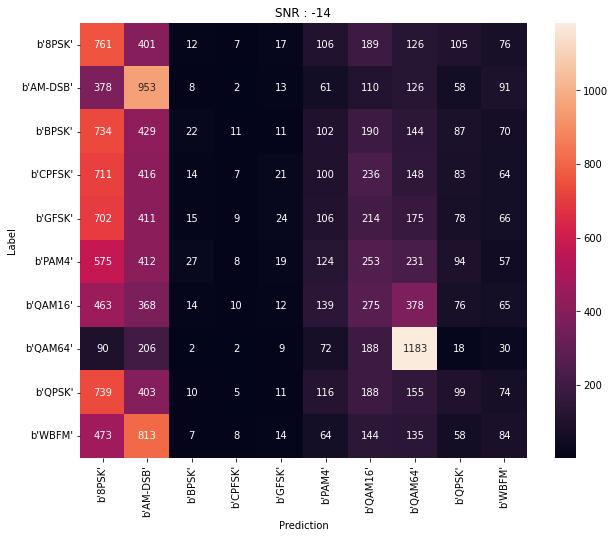

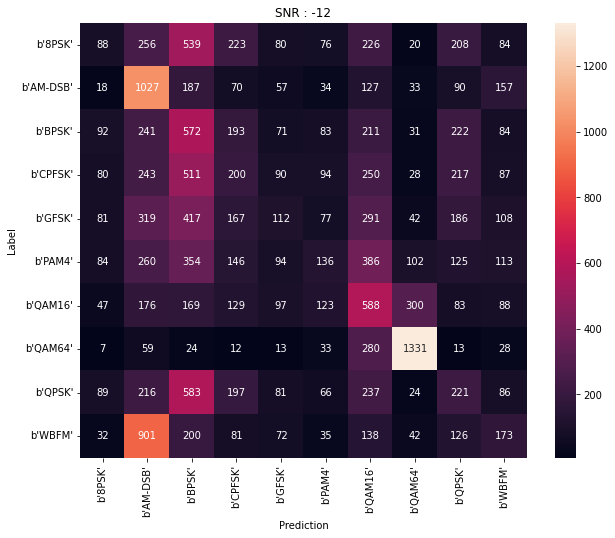

...

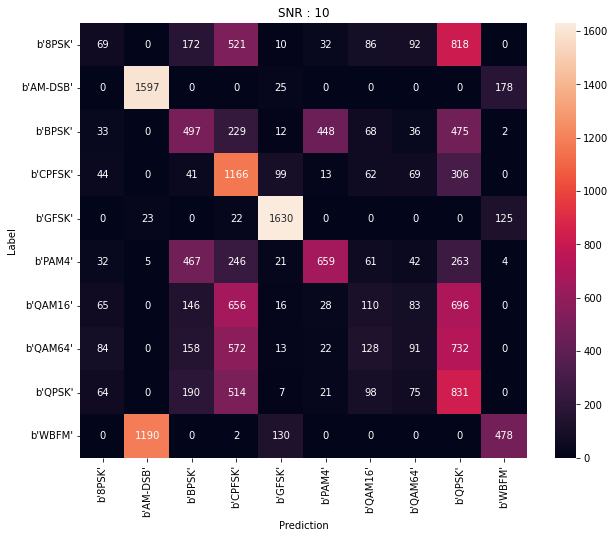

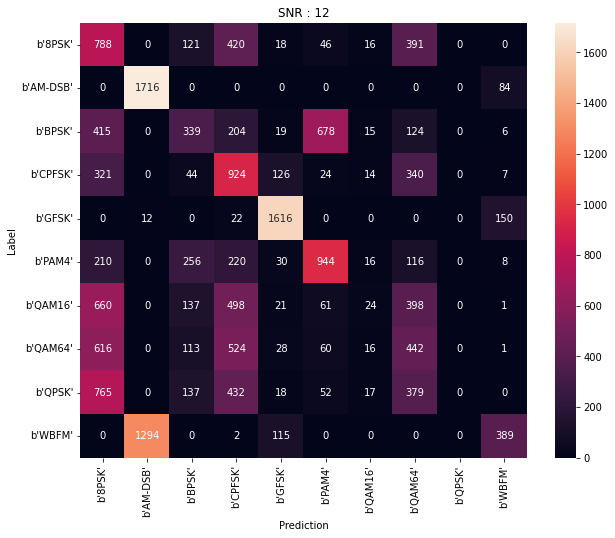

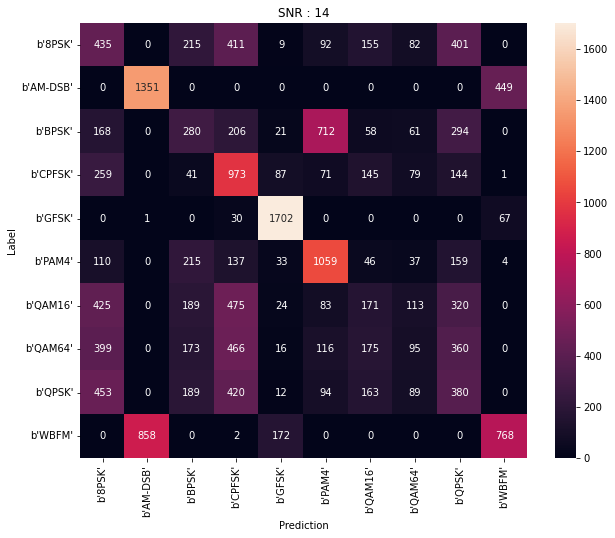

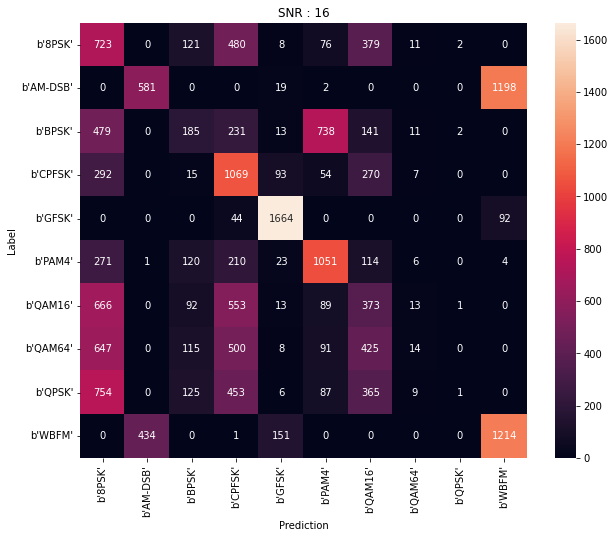

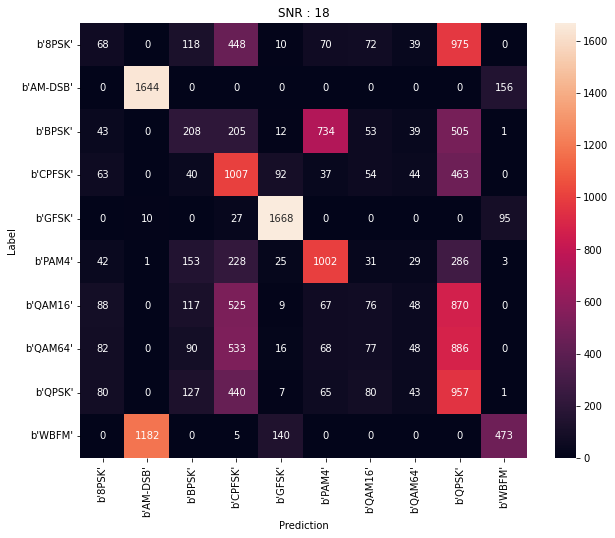

In [ ]:
confusion_matrixf(LSTM_y_preds, lab_test)

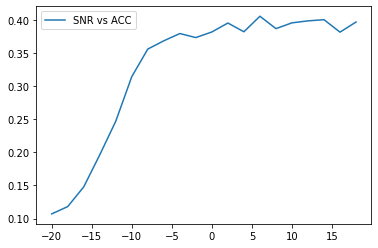

In [ ]:
plot_snr_acc(snrs, LSTM_acc_list)

# Combinations of 1,2 and 3 and Models

## CNN

In [ ]:
features_FDIT = get_FDIT(X).reshape((20, 60000, 2, 128, 1))
print(features_FDIT.shape)

(20, 60000, 2, 128, 1)


In [ ]:
features_IIT = integrate.cumtrapz(X, initial=0)
features_IIT = np.asarray(features_IIT).reshape((20, 60000, 2, 128, 1))
print(features_IIT.shape)  

(20, 60000, 2, 128, 1)


In [ ]:
Combined_features = np.concatenate((X.reshape((20, 60000, 2, 128, 1)) ,features_FDIT, features_IIT), axis=2)
Combined_features = np.asarray(Combined_features)
print(Combined_features.shape)

(20, 60000, 6, 128, 1)


In [ ]:
del features_FDIT
del features_IIT
del X
del label
del Data

In [ ]:
feat_train, feat_val, feat_test, lab_train, lab_val, lab_test = split(Combined_features, label_enc)

In [ ]:
print(feat_train.shape, lab_train.shape)

(20, 39900, 6, 128, 1) (20, 39900, 10)


In [ ]:
del Combined_features

In [ ]:
models, histories = train_models(len(snrs), feat_train, feat_val, lab_train, lab_val, num_epochs, num_batch_size, 1e-2,'CNN')


********************************************************* SNR -20 *********************************************************

Epoch 1/50
1247/1247 [==============================] - ETA: 0s - loss: 2.3051 - accuracy: 0.0984
Epoch 1: val_loss improved from inf to 2.30334, saving model to saved_models/classification0.hdf5
1247/1247 [==============================] - 25s 11ms/step - loss: 2.3051 - accuracy: 0.0984 - val_loss: 2.3033 - val_accuracy: 0.1000
Epoch 2/50
1247/1247 [==============================] - ETA: 0s - loss: 2.3042 - accuracy: 0.0980
Epoch 2: val_loss improved from 2.30334 to 2.30300, saving model to saved_models/classification0.hdf5
1247/1247 [==============================] - 13s 10ms/step - loss: 2.3042 - accuracy: 0.0980 - val_loss: 2.3030 - val_accuracy: 0.1000
Epoch 3/50
1246/1247 [============================>.] - ETA: 0s - loss: 2.3038 - accuracy: 0.0999
Epoch 3: val_loss did not improve from 2.30300
1247/1247 [==============================] - 13s 10ms/step - lo

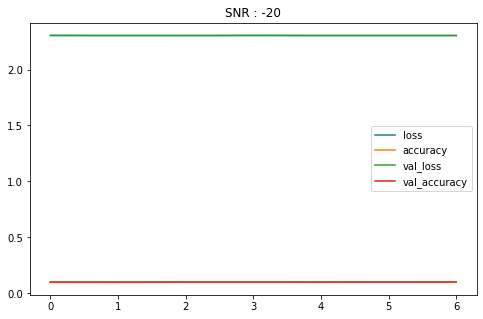

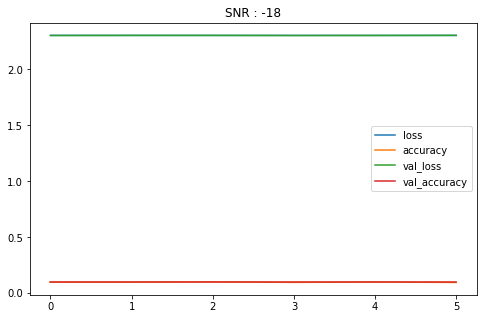

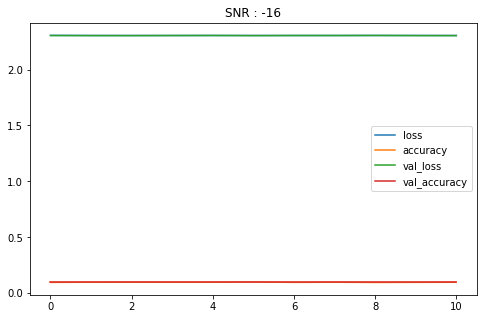

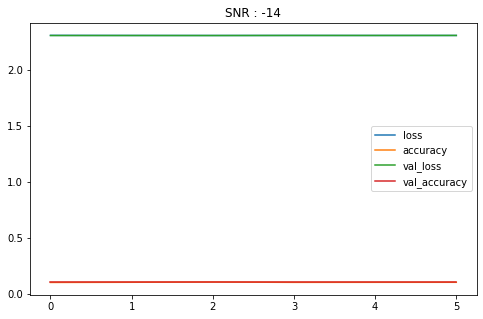

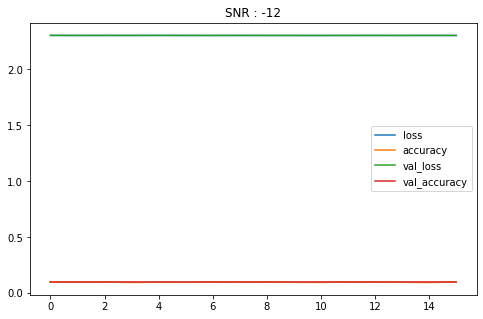

...

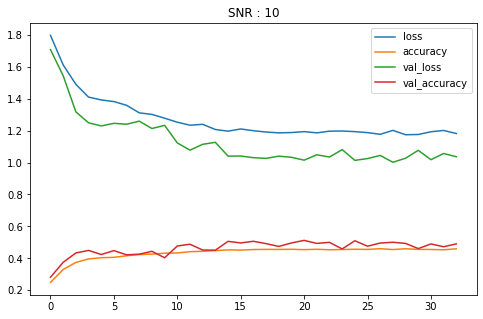

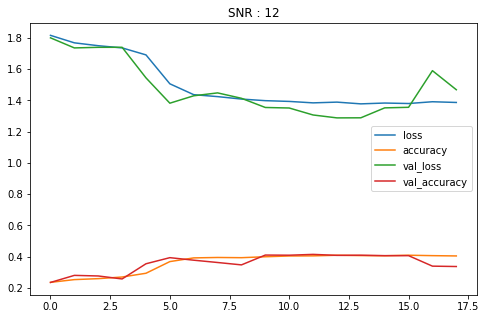

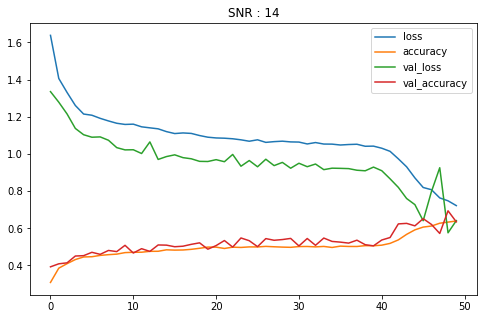

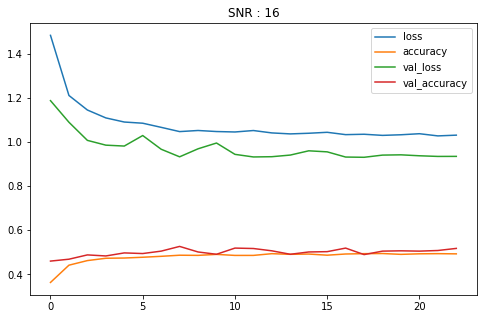

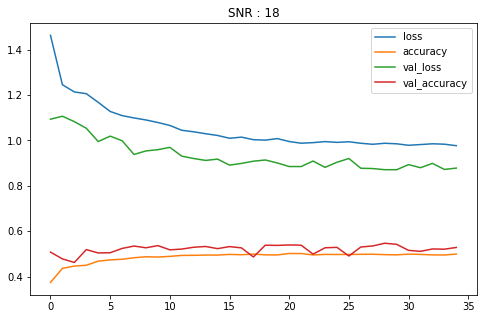

In [ ]:
plot_loss_acc(histories)

In [ ]:
acc_list, y_preds = test_models(models, feat_test, lab_test)

Test set accuracy mod 1 of SNR -20: 10%
Test set accuracy mod 2 of SNR -18: 10%
Test set accuracy mod 3 of SNR -16: 10%
Test set accuracy mod 4 of SNR -14: 10%
Test set accuracy mod 5 of SNR -12: 10%
Test set accuracy mod 6 of SNR -10: 26%
Test set accuracy mod 7 of SNR -8: 37%
Test set accuracy mod 8 of SNR -6: 47%
Test set accuracy mod 9 of SNR -4: 54%
Test set accuracy mod 10 of SNR -2: 57%
Test set accuracy mod 11 of SNR 0: 66%
Test set accuracy mod 12 of SNR 2: 65%
Test set accuracy mod 13 of SNR 4: 65%
Test set accuracy mod 14 of SNR 6: 65%
Test set accuracy mod 15 of SNR 8: 66%
Test set accuracy mod 16 of SNR 10: 51%
Test set accuracy mod 17 of SNR 12: 42%
Test set accuracy mod 18 of SNR 14: 63%
Test set accuracy mod 19 of SNR 16: 48%
Test set accuracy mod 20 of SNR 18: 53%


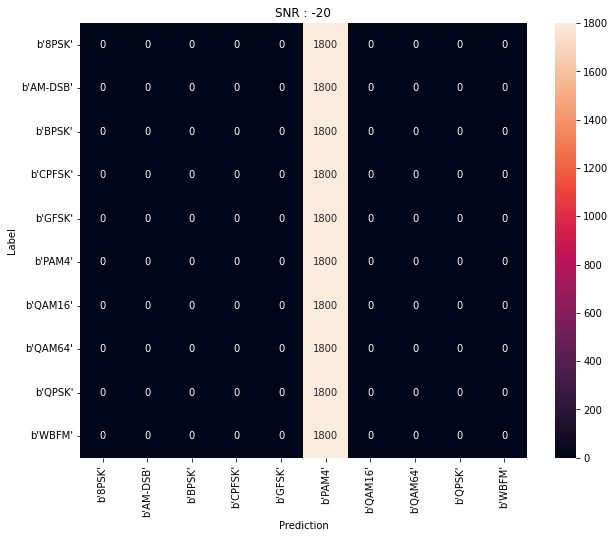

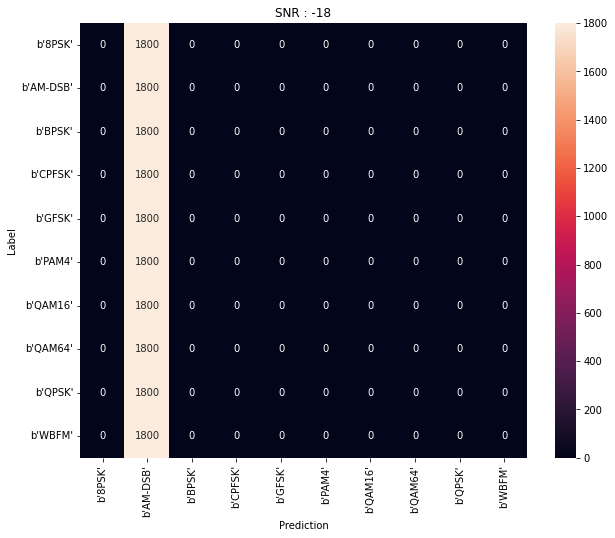

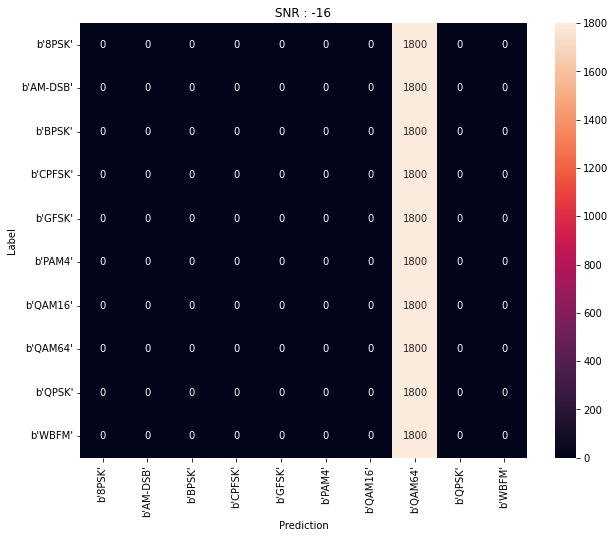

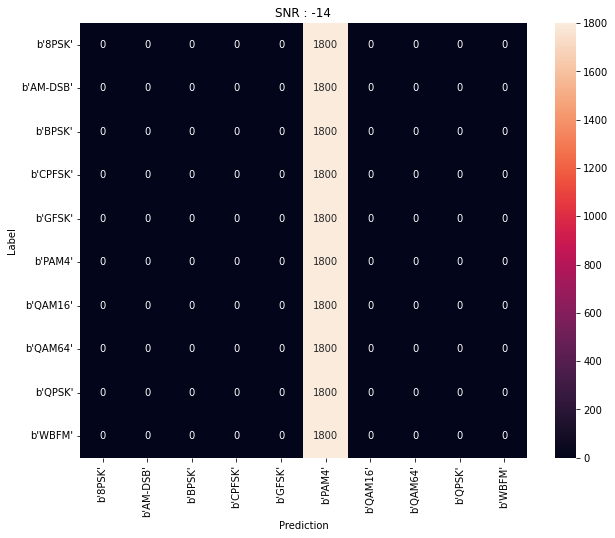

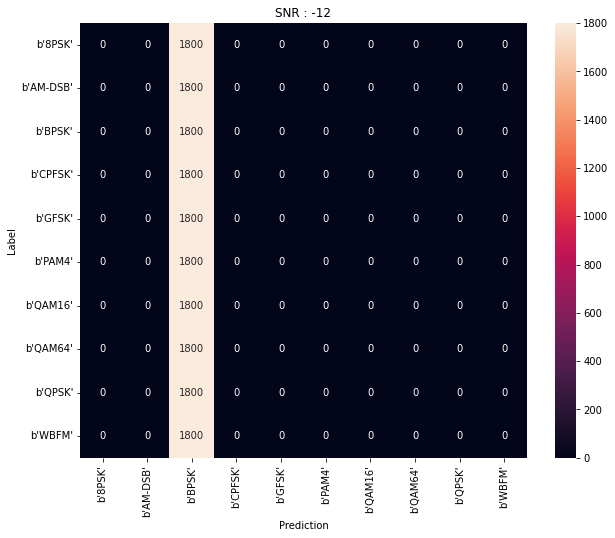

...

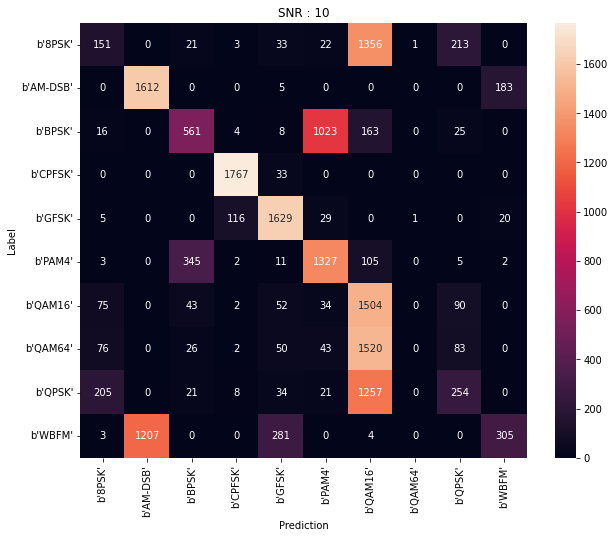

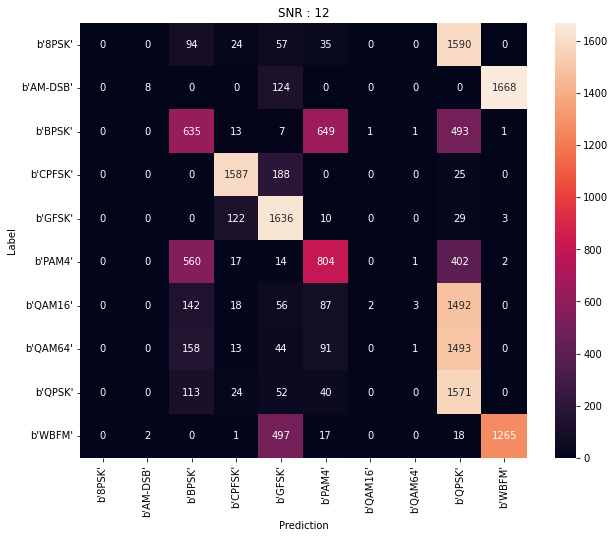

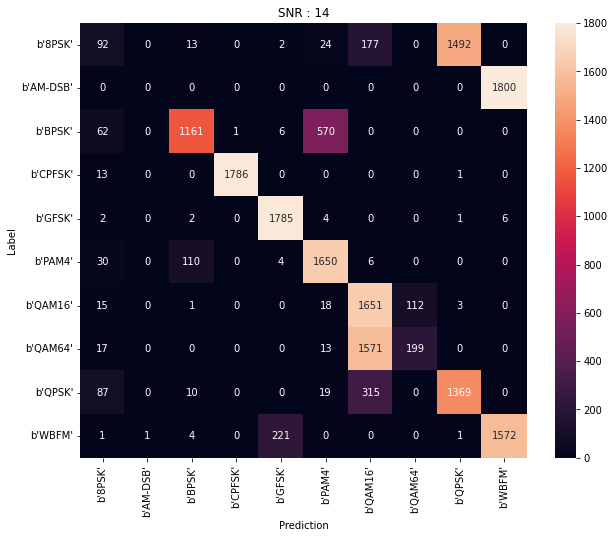

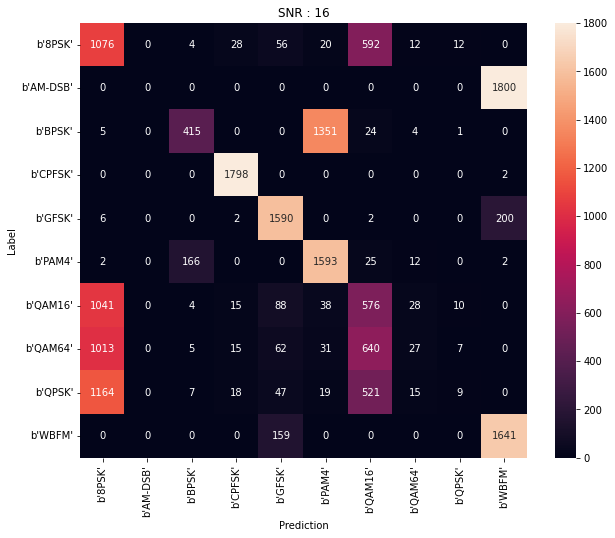

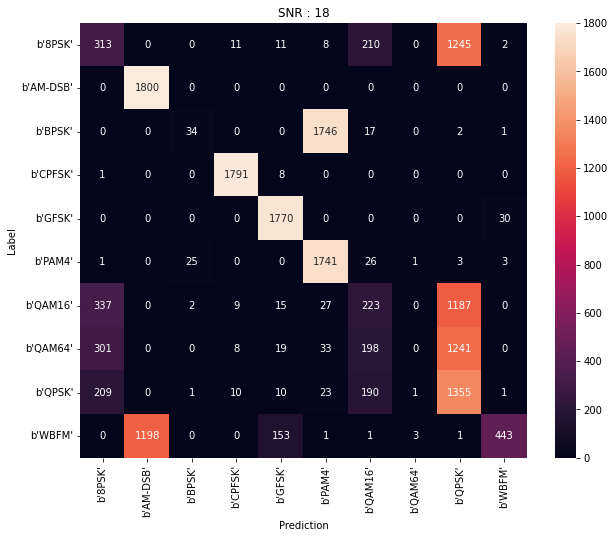

In [ ]:
confusion_matrixf(y_preds, lab_test)

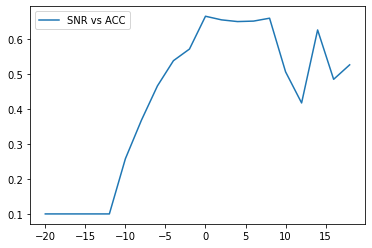

In [ ]:
plot_snr_acc(snrs, acc_list)

## RNN

In [ ]:
features_FDIT_RNN = get_FDIT(X).reshape((20, 60000, 2, 128))

NameError: ignored

In [ ]:
features_IIT_RNN = integrate.cumtrapz(X, initial=0)
features_IIT_RNN = np.asarray(features_IIT_RNN).reshape((20, 60000, 2, 128))

In [ ]:
Combined_features = np.concatenate((X.reshape((20, 60000, 2, 128)) ,features_FDIT_RNN, features_IIT_RNN), axis=2)
Combined_features = np.asarray(Combined_features)
print(Combined_features.shape)

(20, 60000, 6, 128)


In [ ]:
del features_FDIT_RNN
del features_IIT_RNN
del X
del label
del Data

In [ ]:
feat_train, feat_val, feat_test, lab_train, lab_val, lab_test = split(Combined_features, label_enc)

In [ ]:
del Combined_features

In [ ]:
print(feat_train.shape, lab_train.shape)

(20, 39900, 6, 128) (20, 39900, 10)


In [ ]:
RNNmodels, RNNhistories = train_models(len(snrs), feat_train, feat_val, lab_train, lab_val, num_epochs, num_batch_size, 1e-2, 'RNN')


********************************************************* SNR -20 *********************************************************

Epoch 1/50
1241/1247 [============================>.] - ETA: 0s - loss: 2.3047 - accuracy: 0.1055
Epoch 1: val_loss improved from inf to 2.30482, saving model to saved_models/classification0.hdf5
1247/1247 [==============================] - 11s 7ms/step - loss: 2.3047 - accuracy: 0.1056 - val_loss: 2.3048 - val_accuracy: 0.1062
Epoch 2/50
1241/1247 [============================>.] - ETA: 0s - loss: 2.3028 - accuracy: 0.1061
Epoch 2: val_loss improved from 2.30482 to 2.30479, saving model to saved_models/classification0.hdf5
1247/1247 [==============================] - 9s 7ms/step - loss: 2.3029 - accuracy: 0.1059 - val_loss: 2.3048 - val_accuracy: 0.1100
Epoch 3/50
1246/1247 [============================>.] - ETA: 0s - loss: 2.3034 - accuracy: 0.1058
Epoch 3: val_loss improved from 2.30479 to 2.30354, saving model to saved_models/classification0.hdf5
1247/1247 [

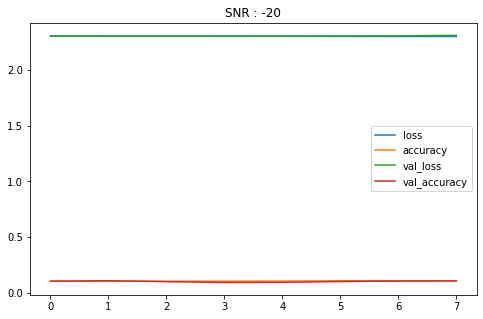

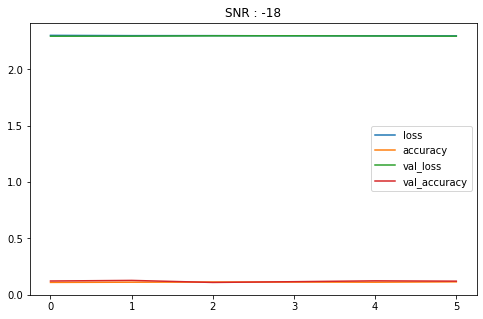

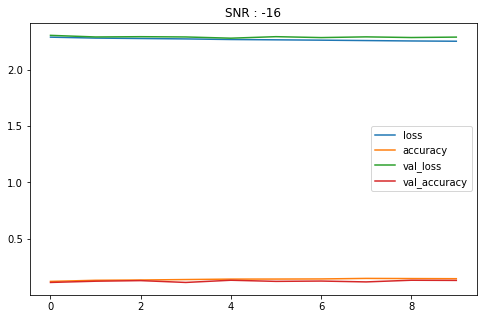

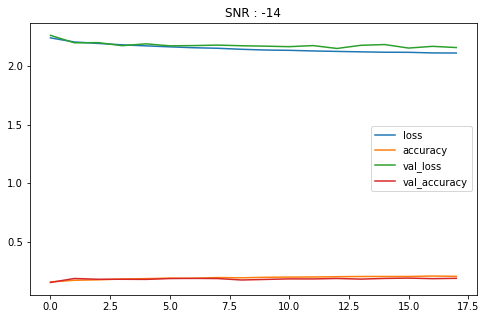

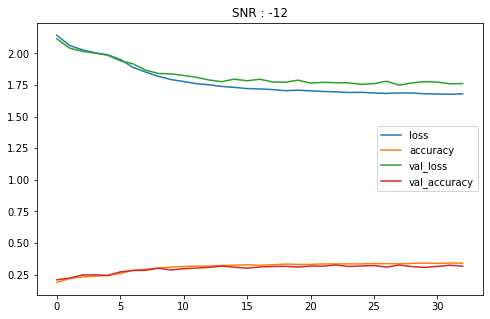

...

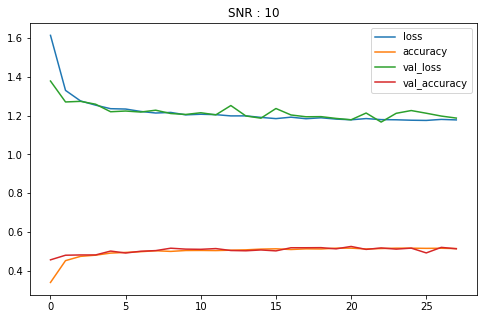

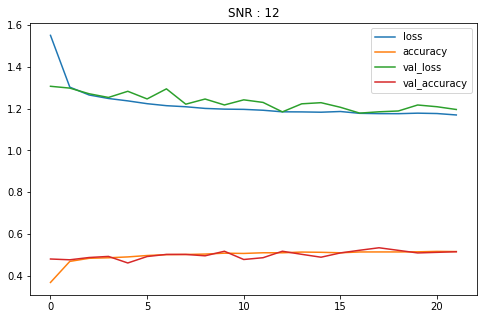

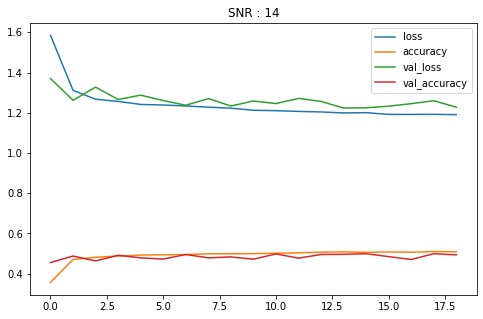

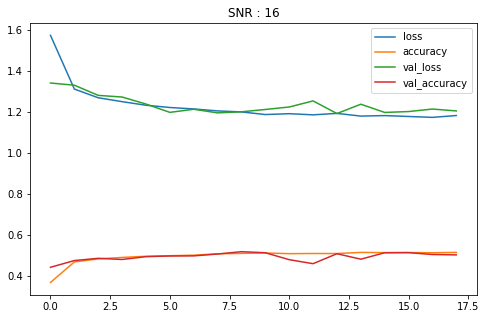

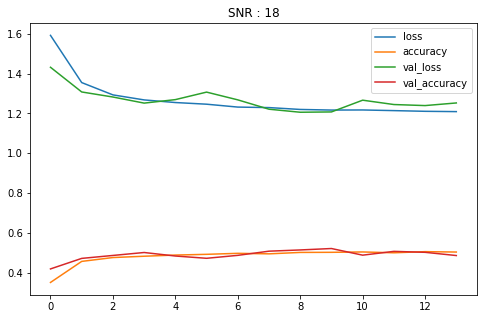

In [ ]:
plot_loss_acc(RNNhistories)

In [ ]:
RNN_acc_list, RNN_y_preds = test_models(RNNmodels, feat_test, lab_test)

Test set accuracy mod 1 of SNR -20: 10%
Test set accuracy mod 2 of SNR -18: 12%
Test set accuracy mod 3 of SNR -16: 14%
Test set accuracy mod 4 of SNR -14: 20%
Test set accuracy mod 5 of SNR -12: 32%
Test set accuracy mod 6 of SNR -10: 42%
Test set accuracy mod 7 of SNR -8: 51%
Test set accuracy mod 8 of SNR -6: 56%
Test set accuracy mod 9 of SNR -4: 59%
Test set accuracy mod 10 of SNR -2: 60%
Test set accuracy mod 11 of SNR 0: 57%
Test set accuracy mod 12 of SNR 2: 59%
Test set accuracy mod 13 of SNR 4: 57%
Test set accuracy mod 14 of SNR 6: 51%
Test set accuracy mod 15 of SNR 8: 51%
Test set accuracy mod 16 of SNR 10: 52%
Test set accuracy mod 17 of SNR 12: 51%
Test set accuracy mod 18 of SNR 14: 50%
Test set accuracy mod 19 of SNR 16: 51%
Test set accuracy mod 20 of SNR 18: 50%


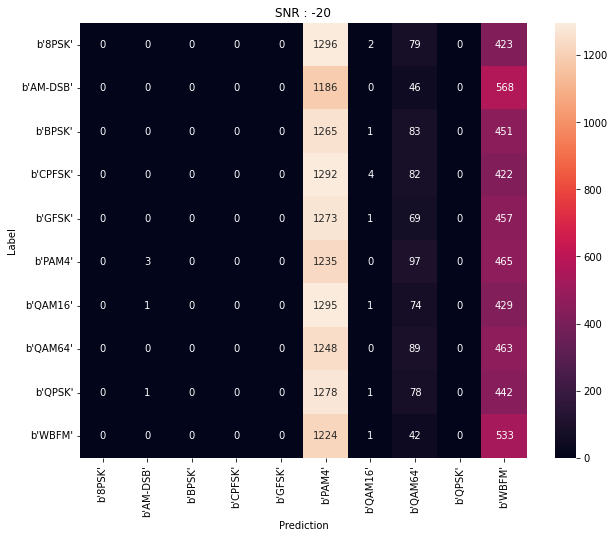

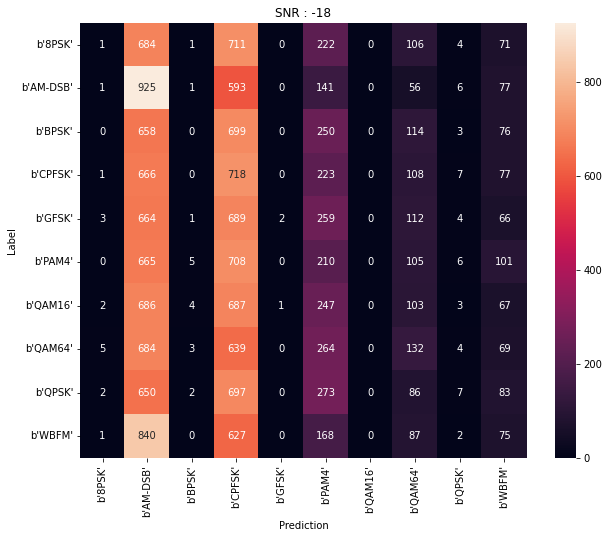

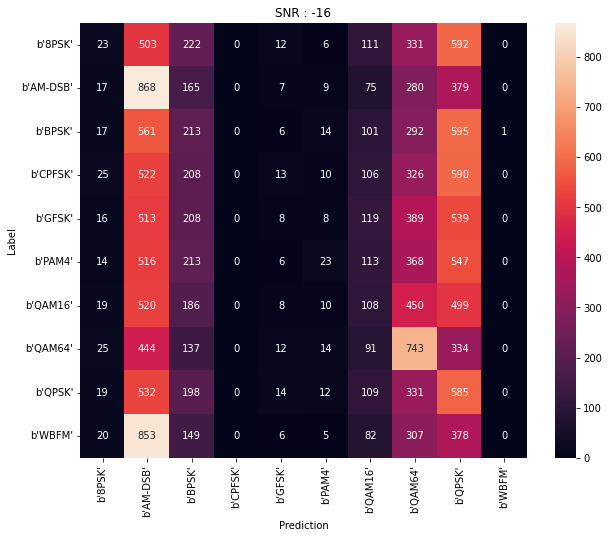

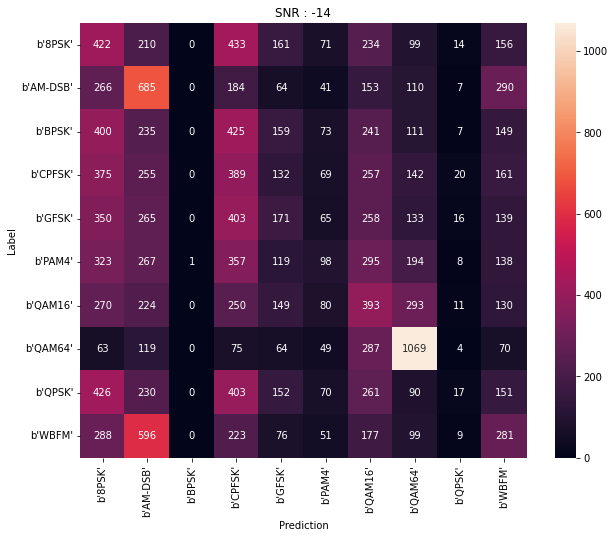

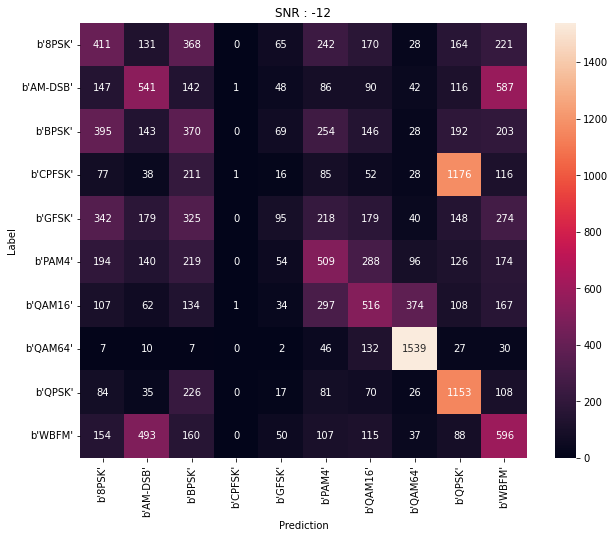

...

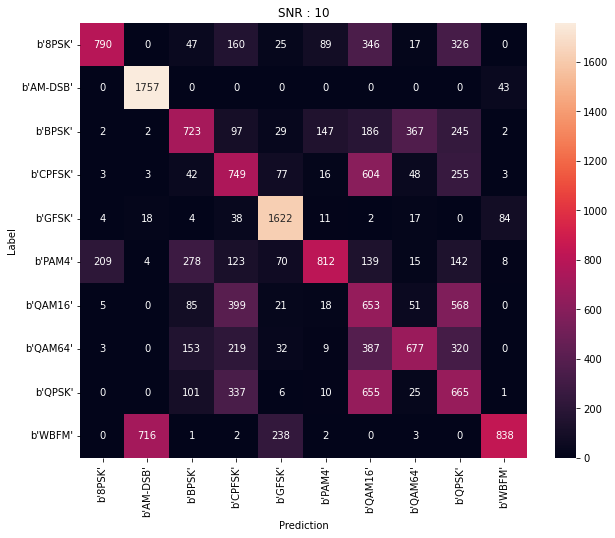

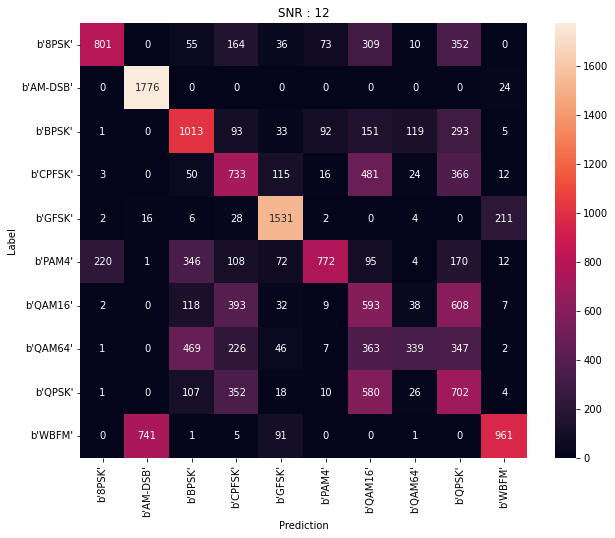

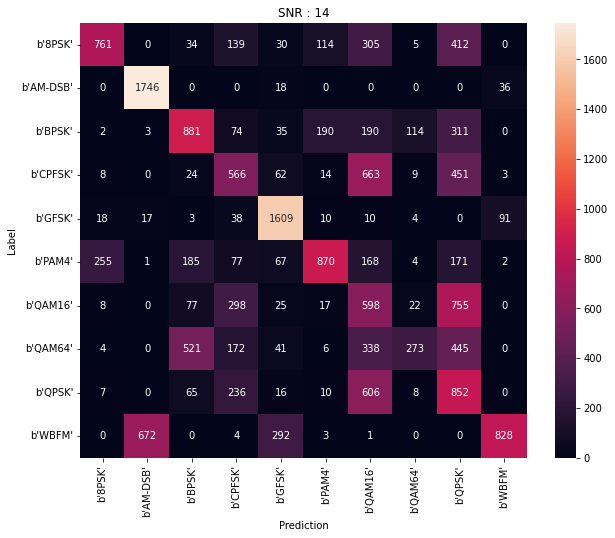

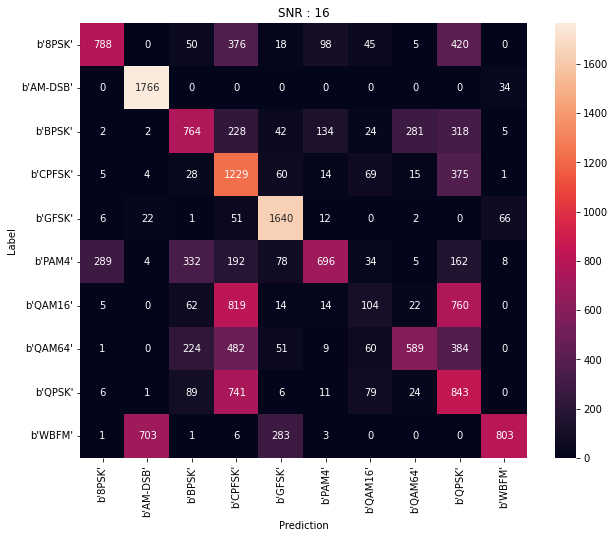

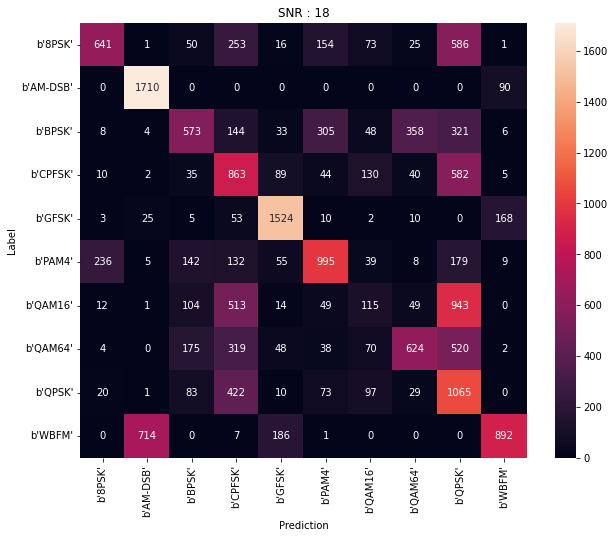

In [ ]:
confusion_matrixf(RNN_y_preds, lab_test)

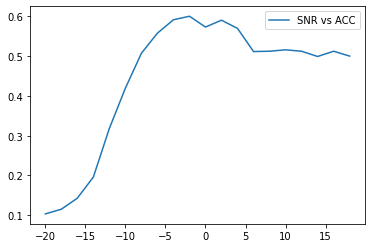

In [ ]:
plot_snr_acc(snrs, RNN_acc_list)

## LSTM 

In [ ]:
features_FDIT_LSTM = get_FDIT(X).reshape((20, 60000, 2, 128))

In [ ]:
features_IIT_LSTM = integrate.cumtrapz(X, initial=0)
features_IIT_LSTM = np.asarray(features_IIT_LSTM).reshape((20, 60000, 2, 128))

In [ ]:
Combined_features = np.concatenate((X.reshape((20, 60000, 2, 128)) ,features_FDIT_LSTM, features_IIT_LSTM), axis=2)
Combined_features = np.asarray(Combined_features)
print(Combined_features.shape)

(20, 60000, 6, 128)


In [ ]:
del features_FDIT_LSTM
del features_IIT_LSTM
del X
del label
del Data

In [ ]:
feat_train, feat_val, feat_test, lab_train, lab_val, lab_test = split(Combined_features, label_enc)

In [ ]:
del Combined_features

In [ ]:
LSTMmodels, LSTMhistories = train_models(len(snrs), feat_train, feat_val, lab_train, lab_val, num_epochs, num_batch_size, 1e-5, 'LSTM')



********************************************************* SNR -20 *********************************************************

Epoch 1/50
1246/1247 [============================>.] - ETA: 0s - loss: 2.3030 - accuracy: 0.0997
Epoch 1: val_loss improved from inf to 2.30104, saving model to saved_models/classification0.hdf5
1247/1247 [==============================] - 13s 5ms/step - loss: 2.3030 - accuracy: 0.0997 - val_loss: 2.3010 - val_accuracy: 0.1081
Epoch 2/50
1235/1247 [============================>.] - ETA: 0s - loss: 2.3014 - accuracy: 0.1073
Epoch 2: val_loss improved from 2.30104 to 2.30042, saving model to saved_models/classification0.hdf5
1247/1247 [==============================] - 5s 4ms/step - loss: 2.3015 - accuracy: 0.1074 - val_loss: 2.3004 - val_accuracy: 0.1062
Epoch 3/50
1238/1247 [============================>.] - ETA: 0s - loss: 2.3001 - accuracy: 0.1121
Epoch 3: val_loss improved from 2.30042 to 2.29978, saving model to saved_models/classification0.hdf5
1247/1247 [

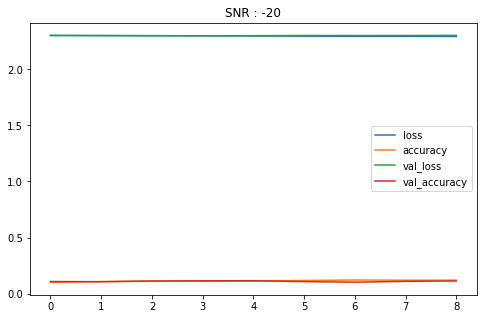

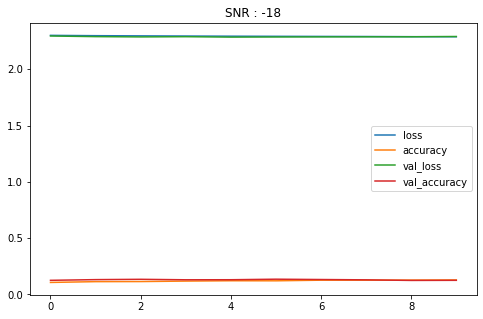

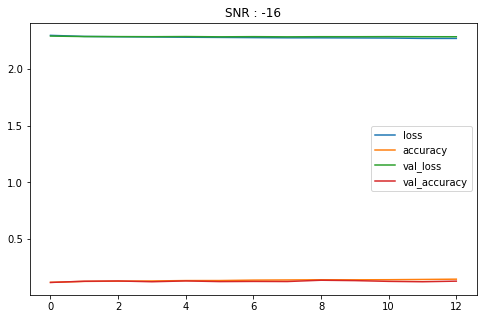

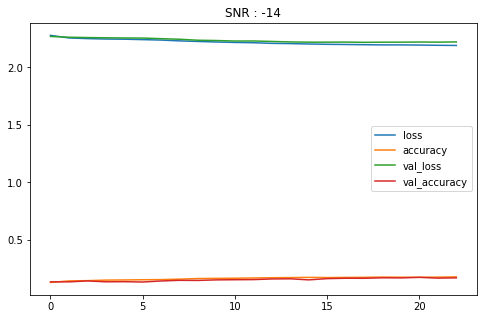

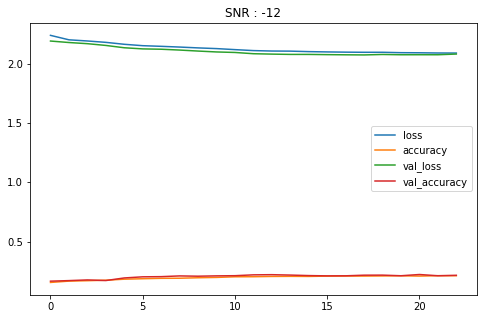

...

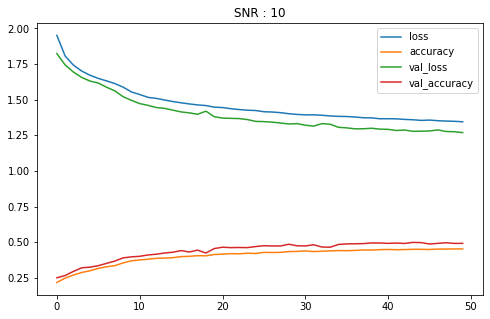

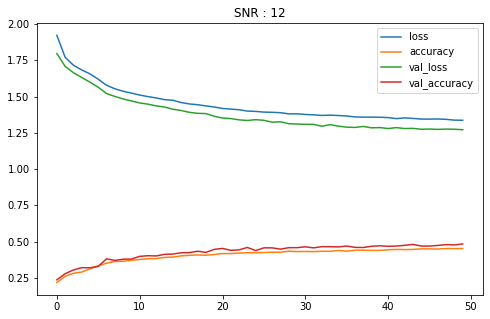

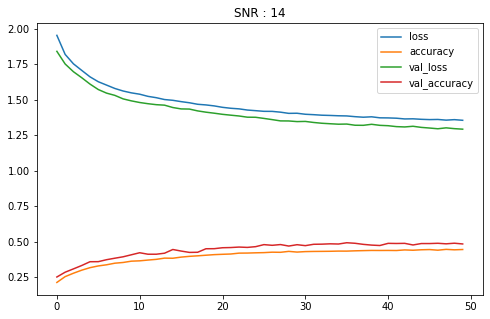

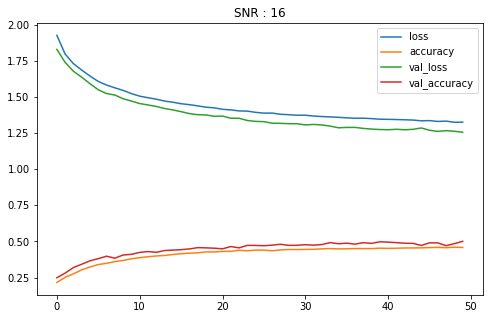

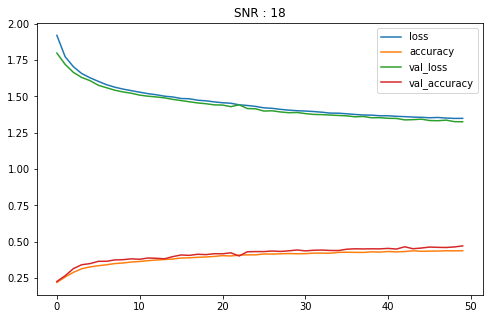

In [ ]:
plot_loss_acc(LSTMhistories)

In [ ]:
LSTM_acc_list, LSTM_y_preds = test_models(LSTMmodels, feat_test, lab_test)

Test set accuracy mod 1 of SNR -20: 11%
Test set accuracy mod 2 of SNR -18: 12%
Test set accuracy mod 3 of SNR -16: 14%
Test set accuracy mod 4 of SNR -14: 17%
Test set accuracy mod 5 of SNR -12: 21%
Test set accuracy mod 6 of SNR -10: 27%
Test set accuracy mod 7 of SNR -8: 39%
Test set accuracy mod 8 of SNR -6: 44%
Test set accuracy mod 9 of SNR -4: 45%
Test set accuracy mod 10 of SNR -2: 47%
Test set accuracy mod 11 of SNR 0: 48%
Test set accuracy mod 12 of SNR 2: 47%
Test set accuracy mod 13 of SNR 4: 49%
Test set accuracy mod 14 of SNR 6: 49%
Test set accuracy mod 15 of SNR 8: 50%
Test set accuracy mod 16 of SNR 10: 48%
Test set accuracy mod 17 of SNR 12: 49%
Test set accuracy mod 18 of SNR 14: 49%
Test set accuracy mod 19 of SNR 16: 50%
Test set accuracy mod 20 of SNR 18: 47%


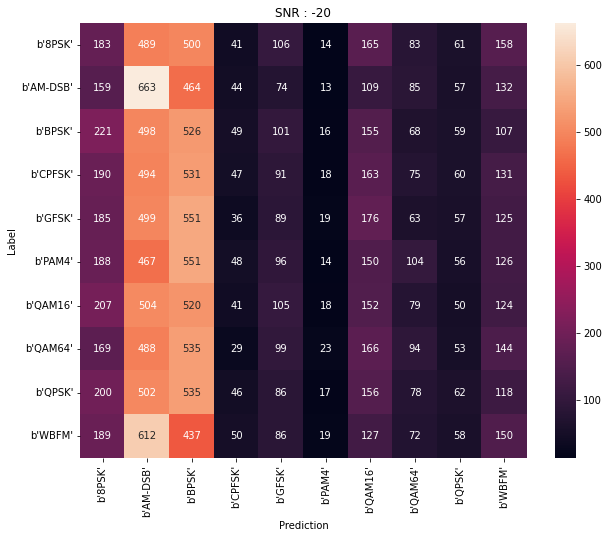

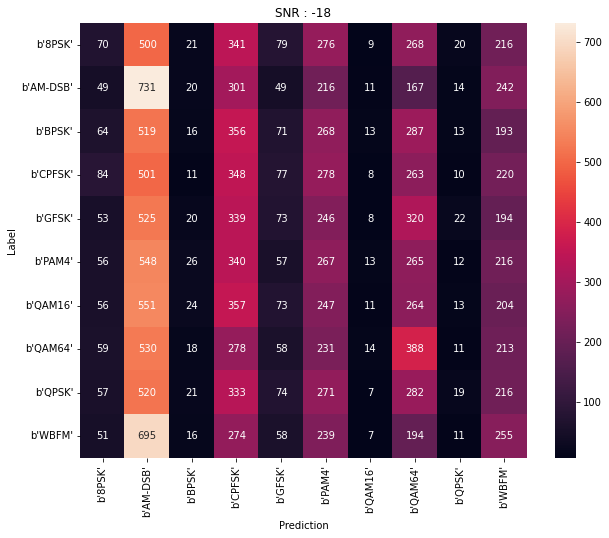

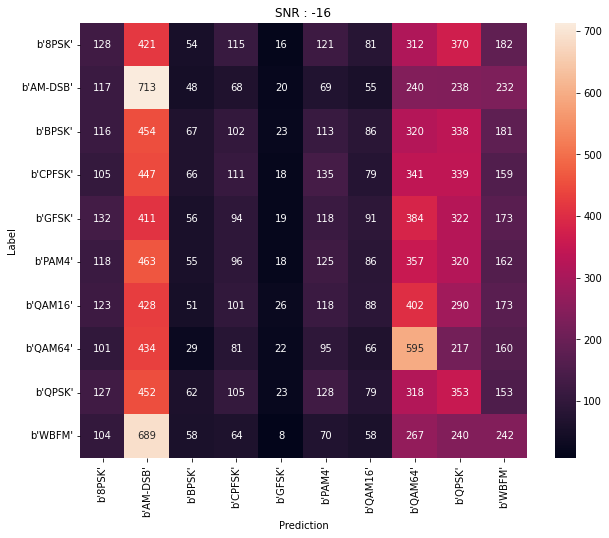

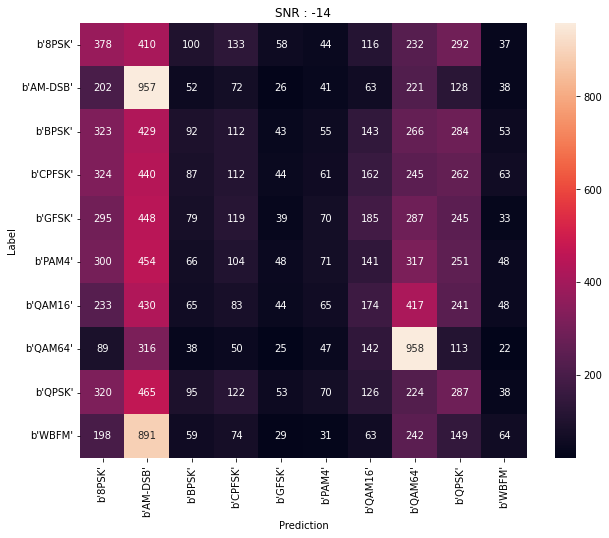

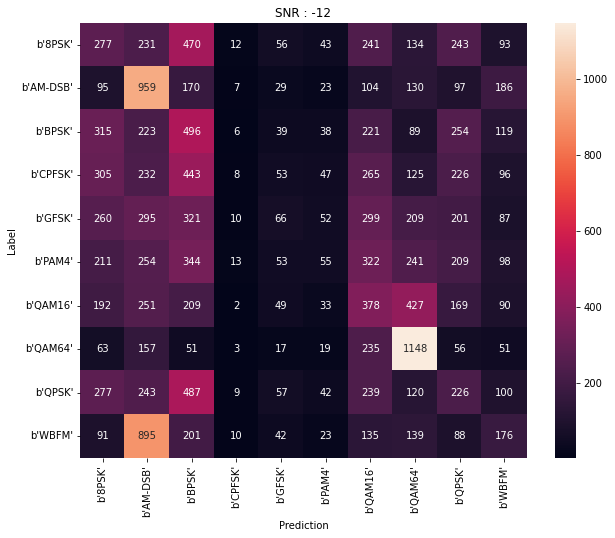

...

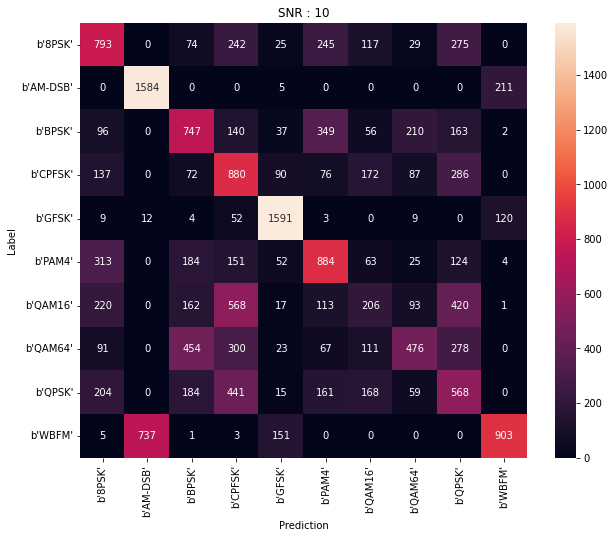

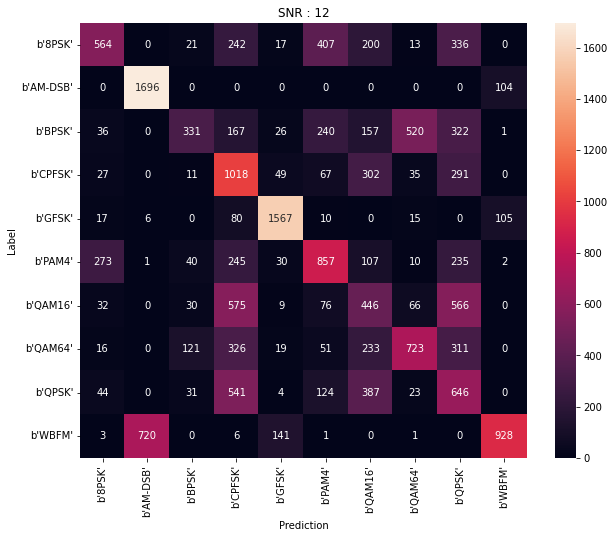

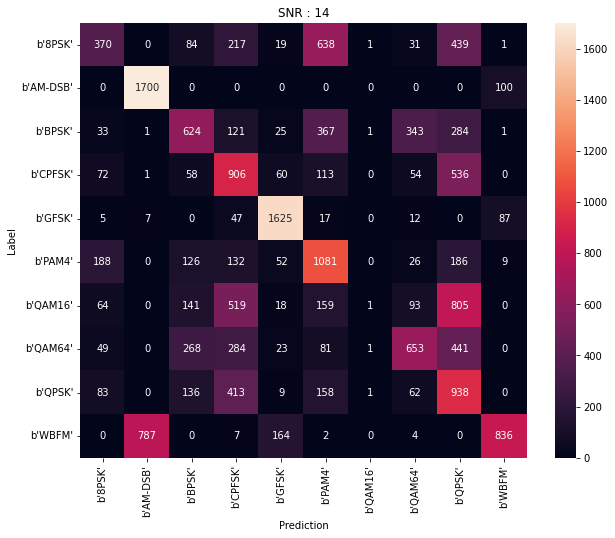

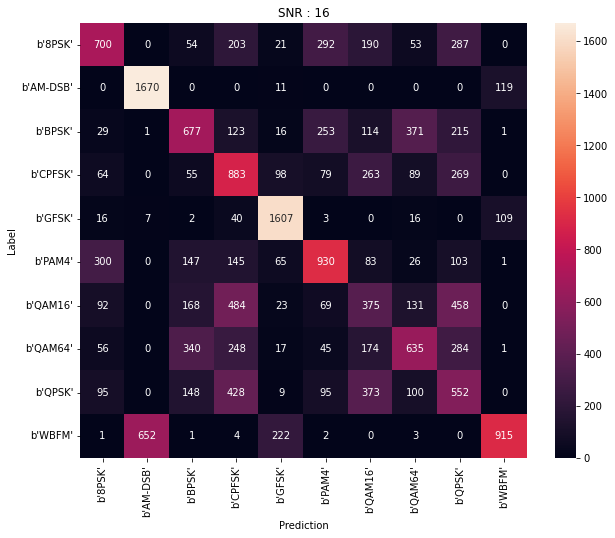

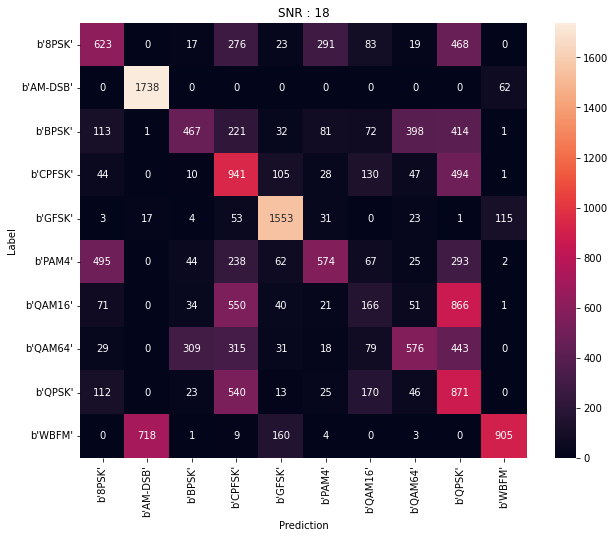

In [ ]:
confusion_matrixf(LSTM_y_preds, lab_test)

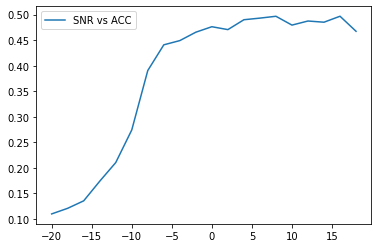

In [ ]:
plot_snr_acc(snrs, LSTM_acc_list)

# 4. Big Picture

# 5. Bonus